In [45]:
import numpy as np
import glob
from scipy.optimize import curve_fit
import h5py
from natsort import natsorted,realsorted
from scipy.signal import find_peaks
import matplotlib.pyplot as plt

In [46]:
pwd

'c:\\Users\\nEXO\\purity-monitor\\Jupyter\\Log'

In [47]:
plt.style.use('../../style.mplstyle')
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

In [48]:
Step0=r"C:/Data/20221006/Step0/"
Step1=r'C:/Data/20221007/Step1/'
Step2=r'C:/Data/20221007/Step2/'
Step3=r'C:/Data/20221007/Step3/'
Step4=r'C:/Data/20221007/Step4/'
Step5=r'C:/Data/20221007/Step5/'
Step6=r'C:/Data/20221007/Step6/'
Step7=r'C:/Data/20221007/Step7/'
Step8=r'C:/Data/20221007/Step8/'
Step9=r'C:/Data/20221007/Step9/'
Step10=r'C:/Data/20221007/Step10/'
Step11=r'C:/Data/20221007/Step11/'
Step12=r'C:/Data/20221007/Step12/'
Step13=r'C:/Data/20221007/Step13/'
Step14=r'C:/Data/20221007/Step14/'
Step15=r'C:/Data/20221007/Step15/'

In [49]:
def Voltages(Path):
    voltages = glob.glob(Path+'mca*')
    voltages = [x.split('_')[-2] for x in voltages]
    voltages = np.array(sorted([x.split('OV')[0] for x in voltages]))
    voltages = np.unique(voltages)
    voltages = voltages.astype(np.float)
    return(voltages)

In [50]:
def Frequency_for_path(Path):
    files_parts=Path.split('/')
    return(float(files_parts[-2][:-3]))

In [51]:
def Voltage_for_path(Path):
    files_parts=Path.split('/')
    return(float(files_parts[-1][10:-7]))

In [52]:
def rebin(hx,h,bins):
    h_rebin=[]
    for i in range(int(len(h)/bins)):
        start_idx=i*bins
        end_idx=(i+1)*bins
        h_rebin.append(np.sum(h[start_idx:end_idx]))
    hx_rebin=range(len(h_rebin))
    return np.array(hx_rebin), np.array(h_rebin)

In [53]:
def gauss(x,a,mu,sigma):
    return (a*np.exp(-0.5*((x-mu)/sigma)**2))

In [54]:
def line(x,a,b):
    return a*(x-b)

In [55]:
def gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):

    BINS=N_BINS # Number of bins to rebin the MCA data with
    N_peaks= N_PEAKS# Number of peaks to use for calculating the gain
    gain_list=[] # empty list to fill in the values of gain, returned at the end of this function
    gain_err=[] # empty list to fill in the values of gain fit error, returned at the end of this function
    calib_pe=[]# empty list to fill in the values for calibrated PE 
    calib_count=[]
    current_list=[]
    Files = natsorted(glob.glob(PATH+'*mca*.h5'))
    # for loop to loop over all the files
    # some source data does not have clear enough peaks at the first OV, so we ignore that here
    for i,file in enumerate(Files):
        print(file) 
        current=0
    
        f = h5py.File(file, 'r')  
        ch2 = f.get('ch2')
        for key in ch2.keys(): 
            df = np.array(ch2.get(key))
        h = df[250:]
        hx = np.arange(0,len(h),1)
        hx,h = rebin(hx,h, BINS)
        

        gain_temp=[]#reset the gain temp list here to store gain values for one file
        #Use scipy find_peaks to find peaks starting with a very high prominence 
        PROMINENCE=1E3 #This prominence is re-set here to ensure that every file starts out with a high prominence
    
        peaks,pdict=find_peaks(h,prominence=PROMINENCE,distance=PEAK_DISTANCE)
        peak_length=len(peaks)
        # We want to ensure that using a high prominence gives us at least N_peaks peaks to fit a straight line to. If it doesn't we reduce prominence till we get at least 3 peaks. N_peaks is set above
        while (peak_length<N_peaks+1):
            PROMINENCE=PROMINENCE-1
            
            peaks,pdict=find_peaks(h,prominence=PROMINENCE,distance=PEAK_DISTANCE)
            peak_length=len(peaks)
    
        plt.figure(figsize=(15,3)) # Call the figure here
        plt.subplot(1,3,1) # This subplot will plot the position of the peaks and also the data
        plt.xlim(0,1000/BINS)
        # plt.xlim(0,200)
        # plt.ylim(0,50)
        plt.yscale('log')
        plt.plot(hx[peaks],h[peaks],'*') # plot the peak markers
        plt.plot(hx,h,lw=1) #plot the signal
        
        
            
        
        
        
        for i,peak in enumerate(peaks[PSL:PSR]): # here we ignore the first peak because it could be the pedestal
            new_first_pe_max=hx[peak] # x-value of the peak
            new_max_value=h[peak] # height of the peak
            new_x_idx_array=(h<0.5*new_max_value) & (hx>new_first_pe_max) # returns a boolean array where both conditions are true
            new_right_side_x= hx[np.where(new_x_idx_array)[0][0]] # finding the first time where x_idx_array is True
            new_sigma_guess=1.2*np.abs(new_first_pe_max-new_right_side_x) # We need this to fit the width of the Gaussian peaks


            new_cut = (hx < new_first_pe_max+new_sigma_guess) & (hx > new_first_pe_max-new_sigma_guess) # This cut helps to fix the width of the peak-fit
            popt_new,pcov_new=curve_fit(gauss,hx[new_cut],h[new_cut],p0=[new_max_value,new_first_pe_max,new_sigma_guess],maxfev=100000) # We use curve_fit to return the optimal parameters and the covariance matrix
            plt.plot(hx[new_cut],gauss(hx[new_cut],*popt_new),color='r',label='Fit',lw=3) # Here we plot the fit on all the peaks
            gain_temp.append(popt_new[1]*BINS) # Here we append the value of the peak fit mean 

        plt.subplot(1,3,2) #This subplot shows the straight line fit to the peak means to obtain the slope/gain
        popt_temp,pcov_temp=curve_fit(line,np.arange(PSL,len(peaks[PSL:PSR])+PSL),gain_temp,p0=[10,0],maxfev=10000) #Use the straight line fit here
        plt.plot(np.arange(PSL,len(peaks[PSL:PSR])+PSL),line(np.arange(PSL,len(peaks[PSL:PSR])+PSL),*popt_temp),color='k',label=(str(np.round(popt_temp[0],2)))+'$\pm$'+str(np.round(np.sqrt(np.diag(pcov_temp))[0],2))+' ADC/PE') # plot the straight line fit
        plt.scatter(np.arange(PSL,len(peaks[PSL:PSR])+PSL),gain_temp,color='r') # plot the values of the peak means
        plt.legend(loc=2)
        
        
        
        
        calib_x=hx*BINS/popt_temp[0]+popt_temp[1]
#         cut_max=np.where(h==np.max(h))
#         print(calib_x[cut_max])
#         if (calib_x[cut_max]-0) !=0:
#             calib_x=hx*BINS/popt_temp[0]+popt_temp[1]+(0-calib_x[cut_max])
        gain_list.append(popt_temp[0]) # append the gain values to obtain BV later
        gain_err.append(np.sqrt(np.diag(pcov_temp))[0]) # append the straight line error fit
        calib_pe.append(calib_x)
        calib_count.append(h)

        plt.subplot(1,3,3)#This subplot shows the calibrated PE spectra
        
        plt.plot(calib_x,h)
        plt.yscale('log')
        plt.xlim(-1,5)
#         plt.xticks(np.arange(0,5))
        plt.grid()
        plt.show() #show the plot
        
        
        # freq=Frequency_for_path(file)
        # # volt=Voltage_for_path(file)
        
        # gain_Giacomo=4E6/7.0
        
        # BV=27.5
        
        # points_to_use=calib_x>0.7
        
        # time=np.sum(h[points_to_use])/(freq*1000)
                
        
        # current=np.sum(calib_x[points_to_use]*h[points_to_use])*gain_Giacomo*(volt-BV)*1.6E-19/time
        # current_list.append(current)
        
        
        
    return(np.array(gain_list),np.array(gain_err),np.array(calib_pe),\
           np.array(calib_count))

C:/Data/20221006/Step0\mca_keith_30.00OV_0.h5


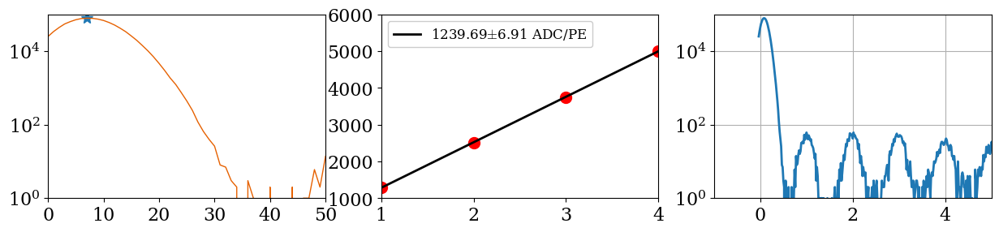

C:/Data/20221006/Step0\mca_keith_30.20OV_0.h5


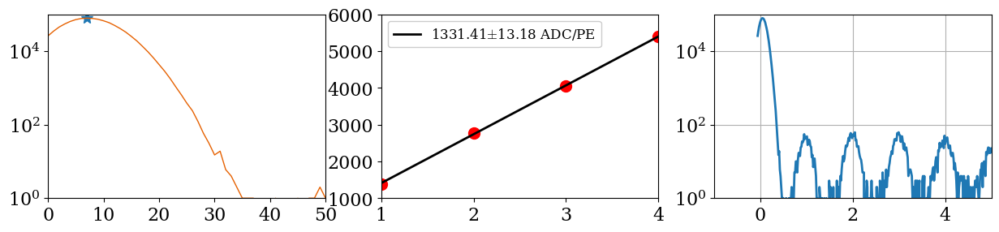

C:/Data/20221006/Step0\mca_keith_30.40OV_0.h5


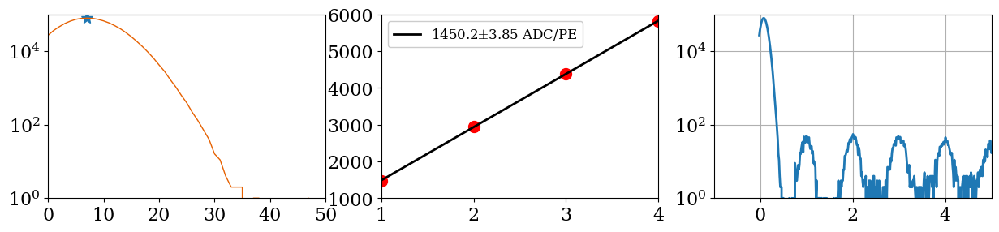

C:/Data/20221006/Step0\mca_keith_30.60OV_0.h5


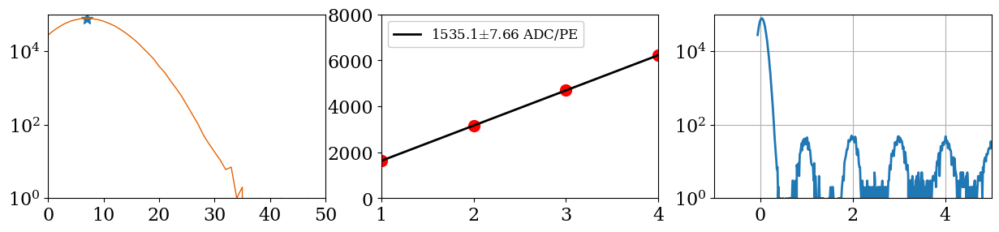

C:/Data/20221006/Step0\mca_keith_30.80OV_0.h5


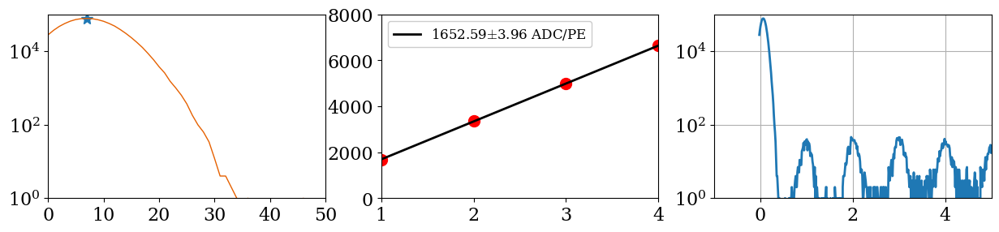

C:/Data/20221006/Step0\mca_keith_31.00OV_0.h5


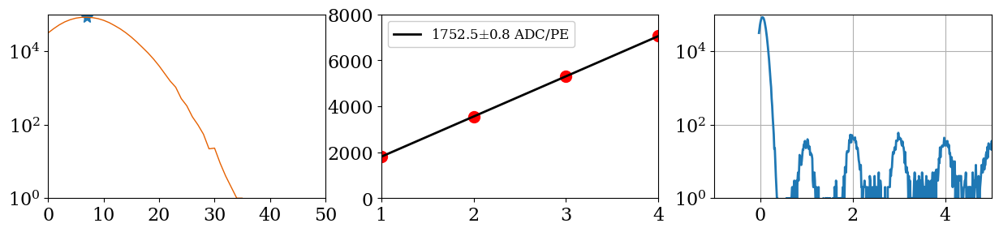

C:/Data/20221006/Step0\mca_keith_31.20OV_0.h5


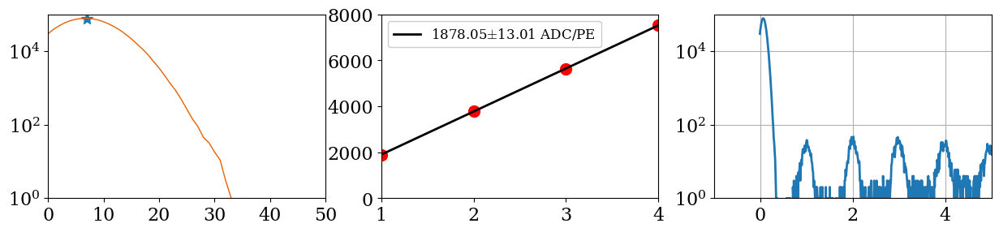

C:/Data/20221006/Step0\mca_keith_31.40OV_0.h5


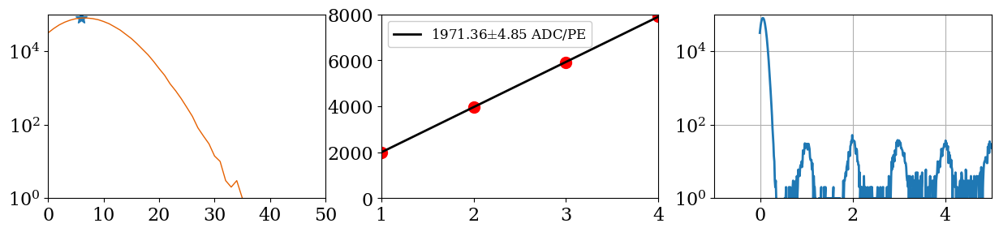

C:/Data/20221006/Step0\mca_keith_31.60OV_0.h5


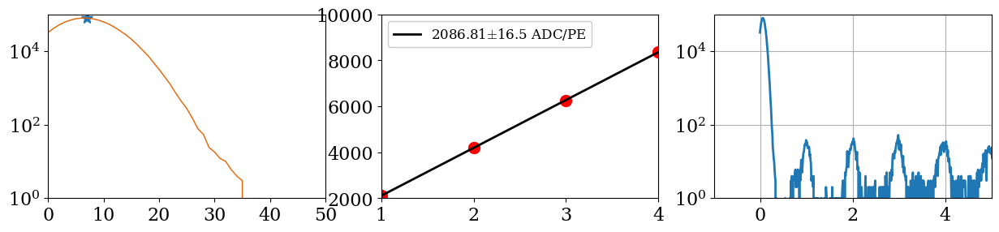

C:/Data/20221006/Step0\mca_keith_31.80OV_0.h5


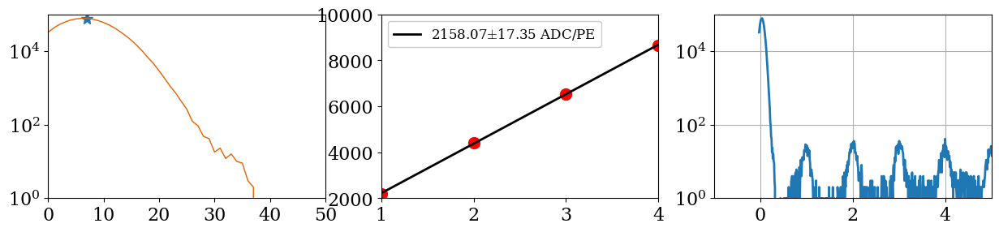

C:/Data/20221006/Step0\mca_keith_32.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


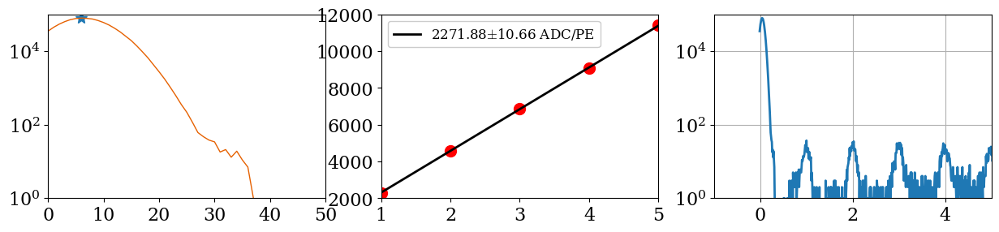

C:/Data/20221006/Step0\mca_keith_32.20OV_0.h5


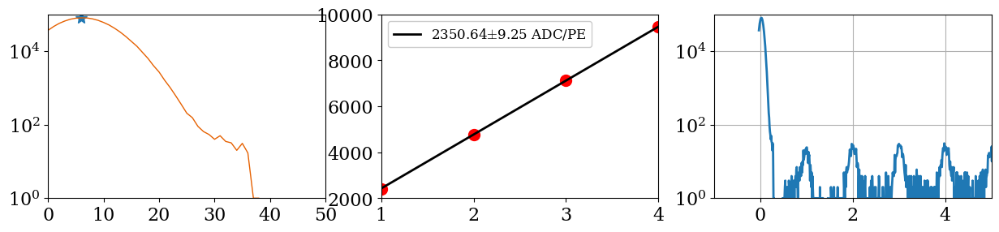

C:/Data/20221006/Step0\mca_keith_32.40OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


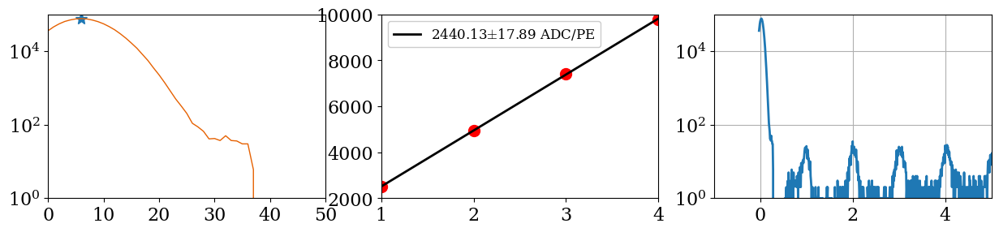

In [56]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step0_gain_list,Step0_gain_err,Step0_calib_pe,Step0_calib_count=gain_calculator(Step0,20,6,30,1,-2)
Voltages_Step0=Voltages(Step0)

C:/Data/20221007/Step1\mca_keith_30.00OV_0.h5


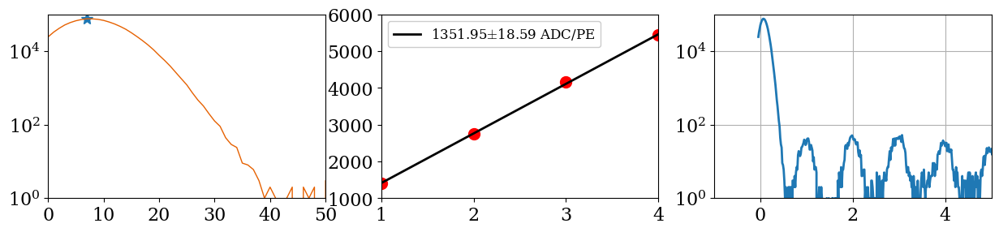

C:/Data/20221007/Step1\mca_keith_30.20OV_0.h5


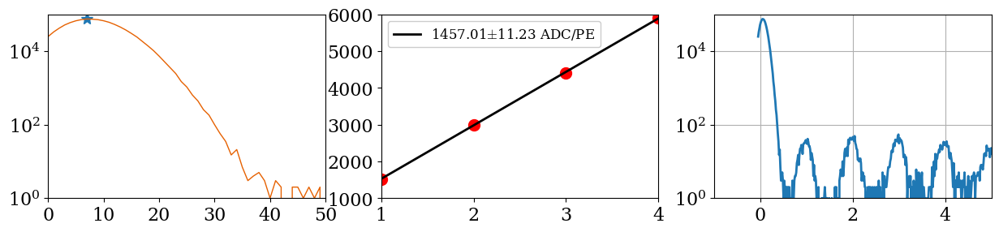

C:/Data/20221007/Step1\mca_keith_30.40OV_0.h5


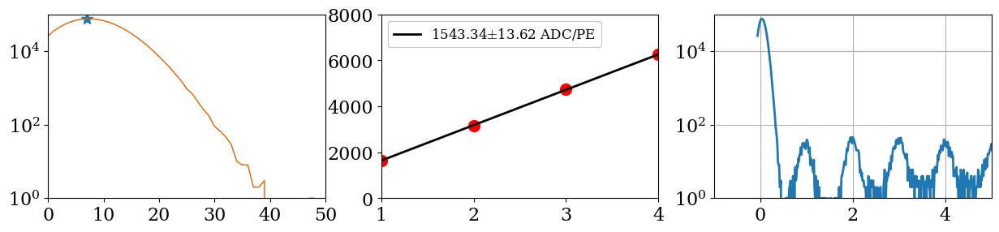

C:/Data/20221007/Step1\mca_keith_30.60OV_0.h5


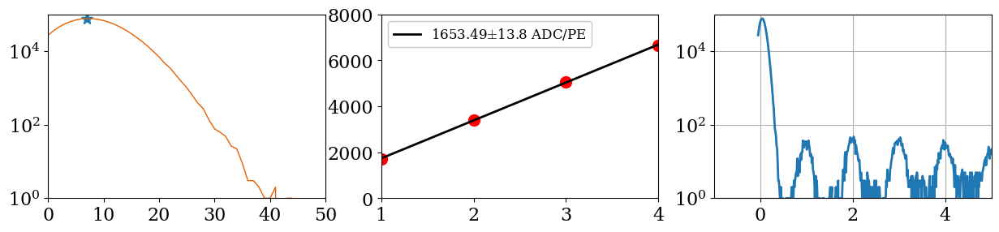

C:/Data/20221007/Step1\mca_keith_30.80OV_0.h5


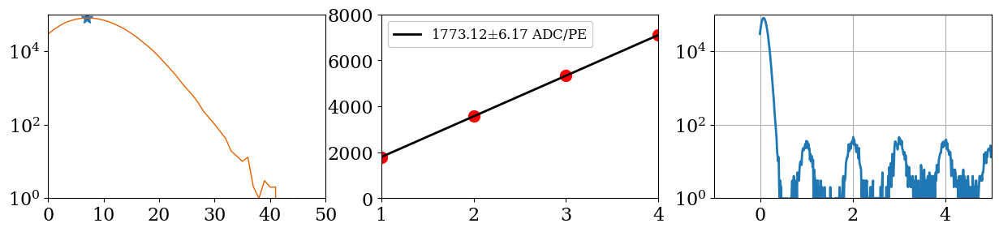

C:/Data/20221007/Step1\mca_keith_31.00OV_0.h5


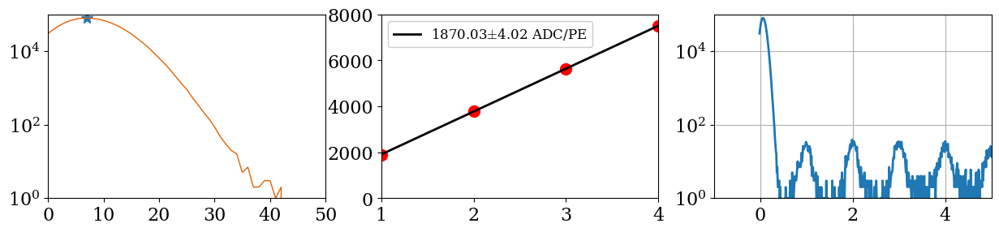

C:/Data/20221007/Step1\mca_keith_31.20OV_0.h5


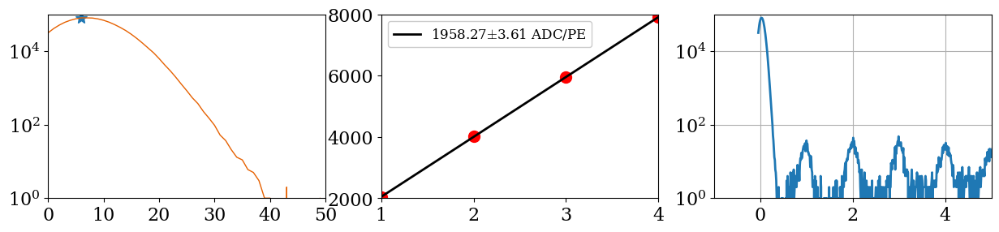

C:/Data/20221007/Step1\mca_keith_31.40OV_0.h5


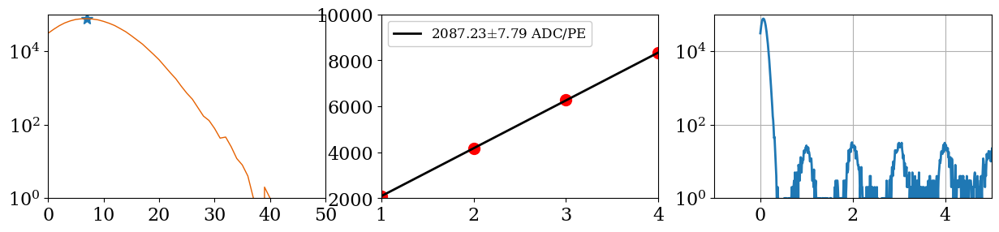

C:/Data/20221007/Step1\mca_keith_31.60OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


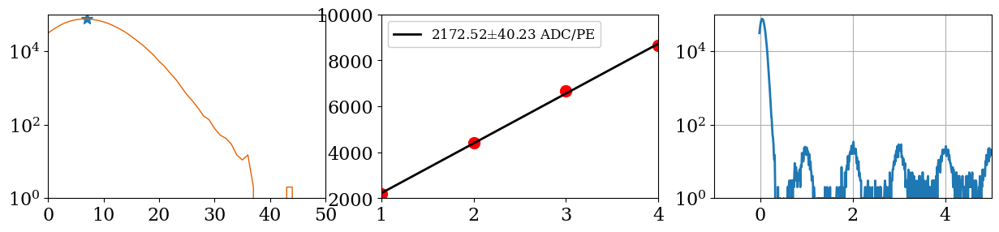

C:/Data/20221007/Step1\mca_keith_31.80OV_0.h5


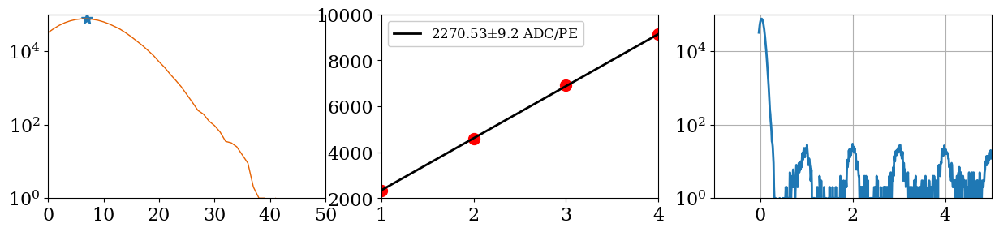

C:/Data/20221007/Step1\mca_keith_32.00OV_0.h5


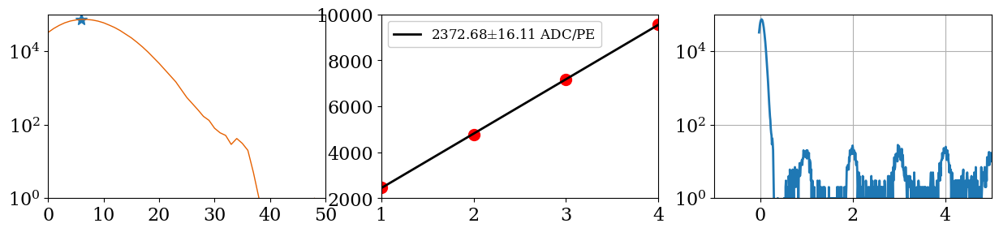

C:/Data/20221007/Step1\mca_keith_32.20OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


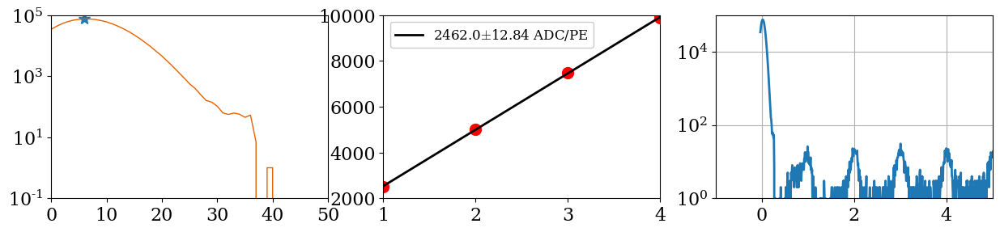

C:/Data/20221007/Step1\mca_keith_32.40OV_0.h5


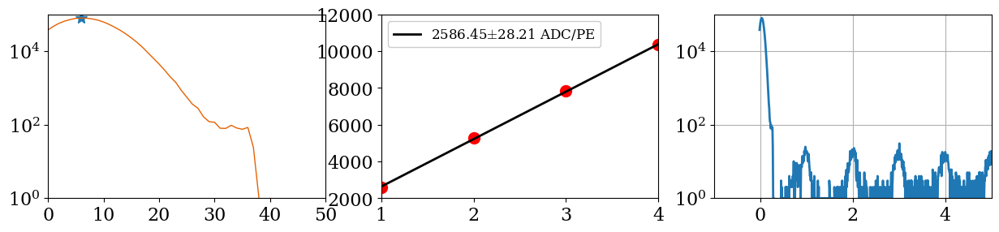

In [57]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step1_gain_list,Step1_gain_err,Step1_calib_pe,Step1_calib_count=gain_calculator(Step1,20,6,40,1,-2)
Voltages_Step1=Voltages(Step1)

C:/Data/20221007/Step2\mca_keith_30.00OV_0.h5


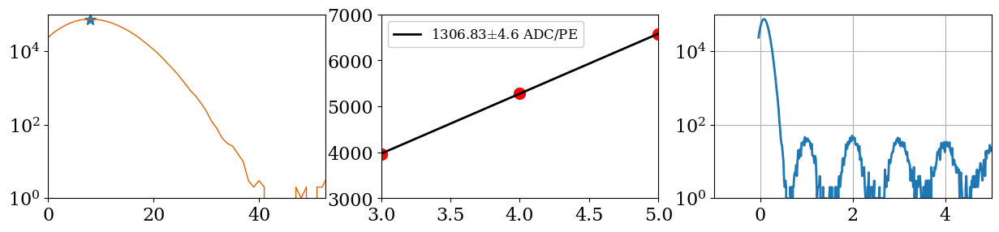

C:/Data/20221007/Step2\mca_keith_30.20OV_0.h5


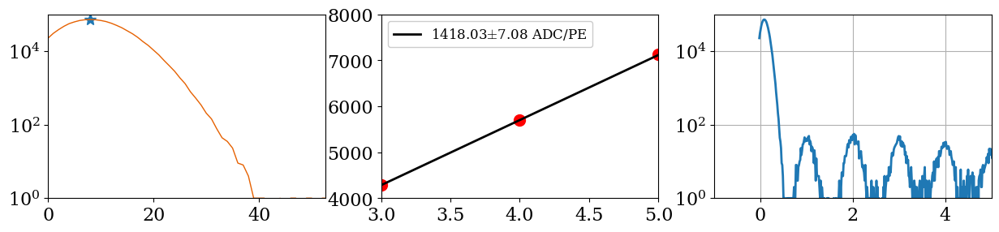

C:/Data/20221007/Step2\mca_keith_30.40OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


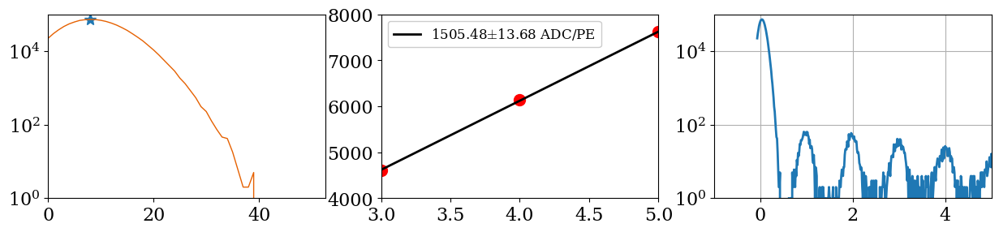

C:/Data/20221007/Step2\mca_keith_30.60OV_0.h5


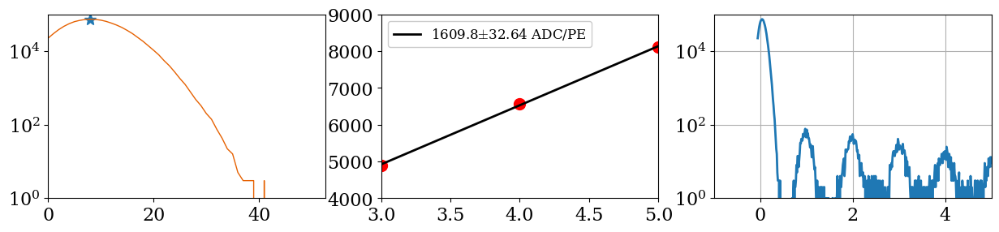

C:/Data/20221007/Step2\mca_keith_30.80OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


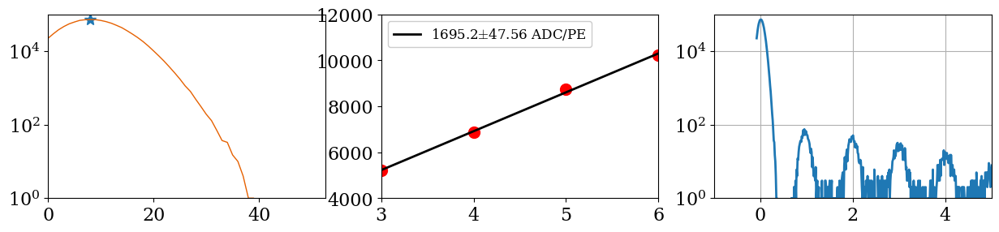

C:/Data/20221007/Step2\mca_keith_31.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


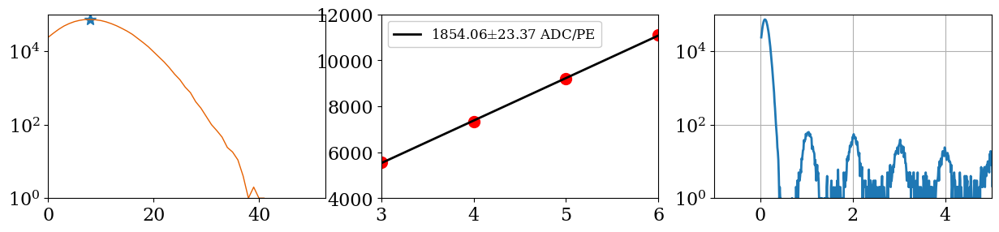

C:/Data/20221007/Step2\mca_keith_31.20OV_0.h5


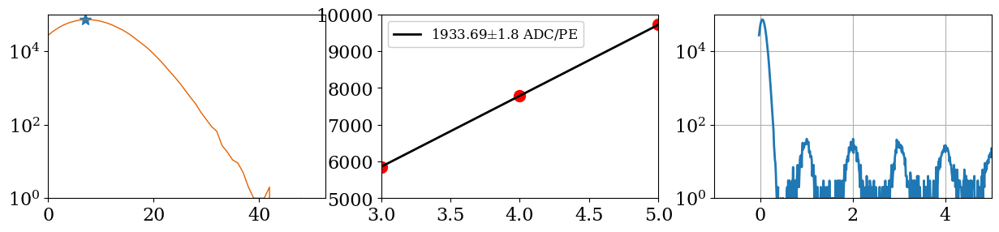

C:/Data/20221007/Step2\mca_keith_31.40OV_0.h5


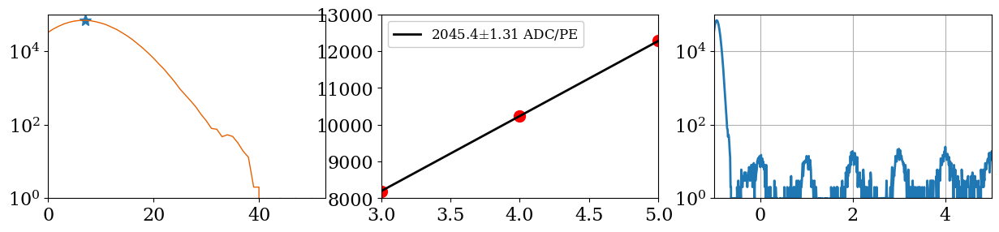

C:/Data/20221007/Step2\mca_keith_31.60OV_0.h5


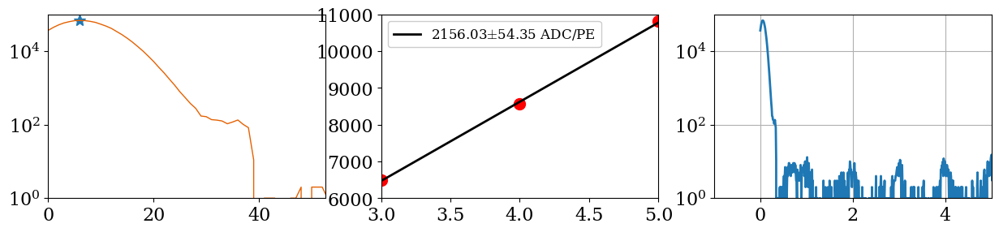

C:/Data/20221007/Step2\mca_keith_31.80OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


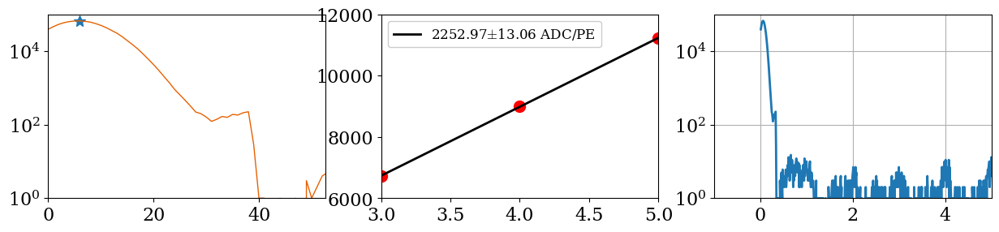

C:/Data/20221007/Step2\mca_keith_32.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


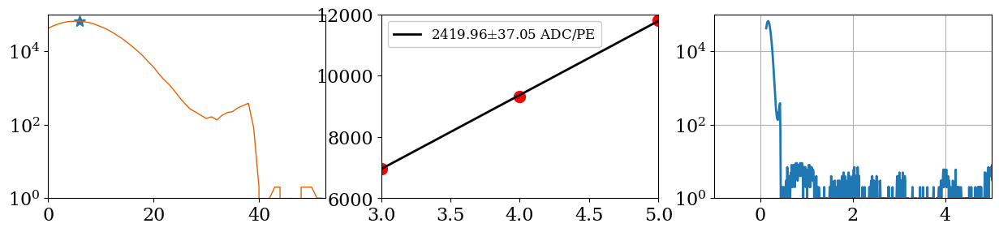

C:/Data/20221007/Step2\mca_keith_32.20OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


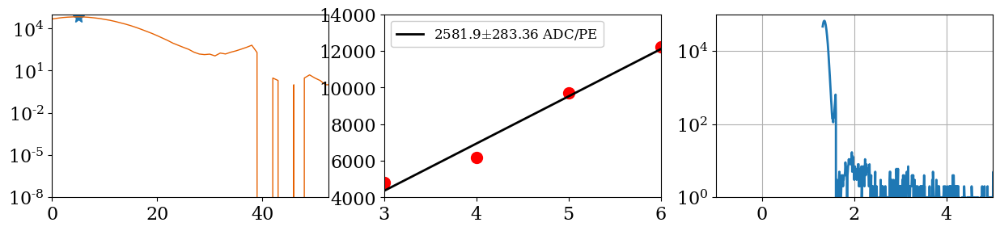

C:/Data/20221007/Step2\mca_keith_32.40OV_0.h5


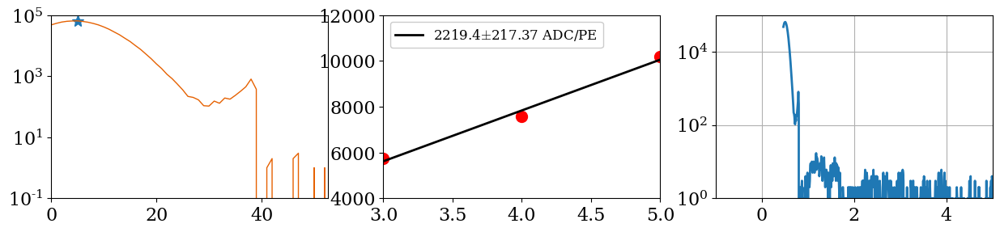

In [58]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step2_gain_list,Step2_gain_err,Step2_calib_pe,Step2_calib_count=gain_calculator(Step2,19,7,55,3,-2)
# (Step2,19,7,55,3,-2)
Voltages_Step2=Voltages(Step2)

C:/Data/20221007/Step3\mca_keith_30.00OV_0.h5


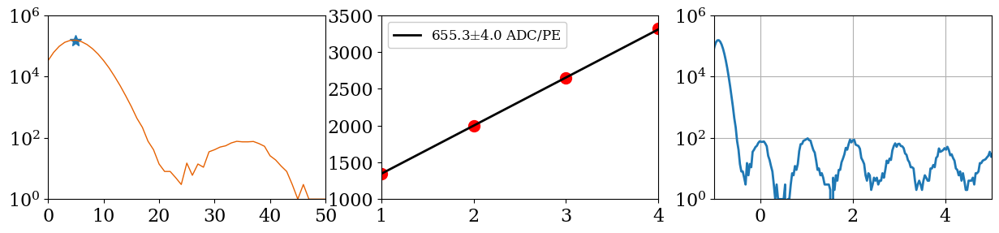

C:/Data/20221007/Step3\mca_keith_30.20OV_0.h5


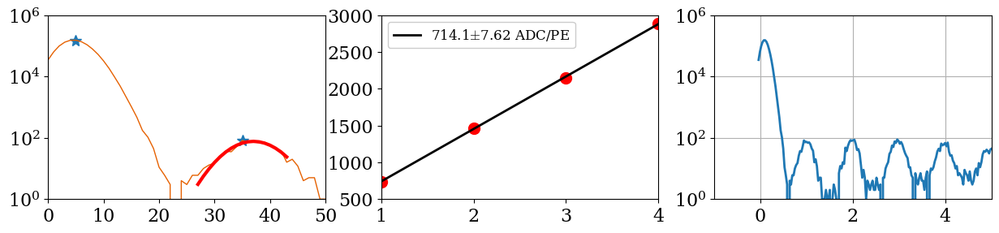

C:/Data/20221007/Step3\mca_keith_30.40OV_0.h5


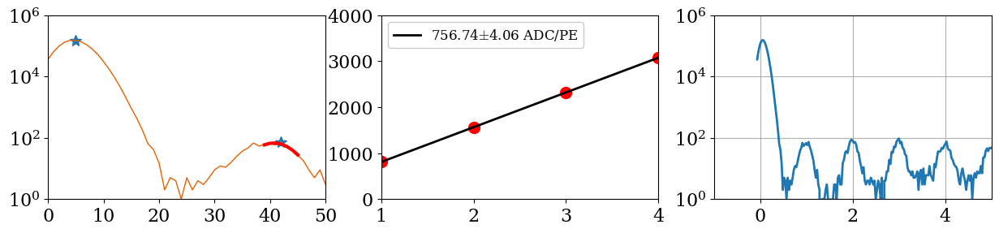

C:/Data/20221007/Step3\mca_keith_30.60OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


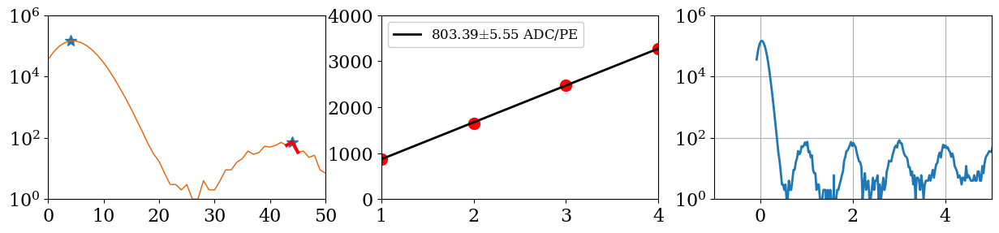

C:/Data/20221007/Step3\mca_keith_30.80OV_0.h5


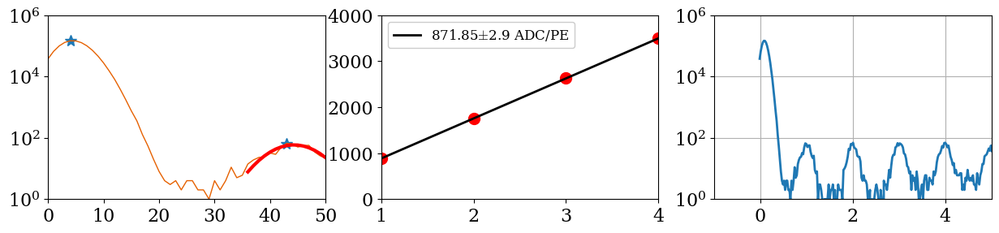

C:/Data/20221007/Step3\mca_keith_31.00OV_0.h5


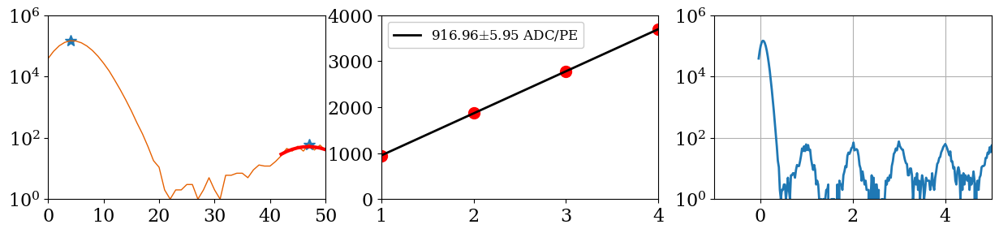

C:/Data/20221007/Step3\mca_keith_31.20OV_0.h5


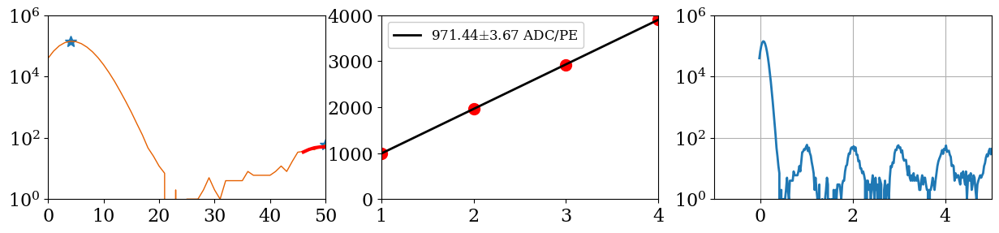

C:/Data/20221007/Step3\mca_keith_31.40OV_0.h5


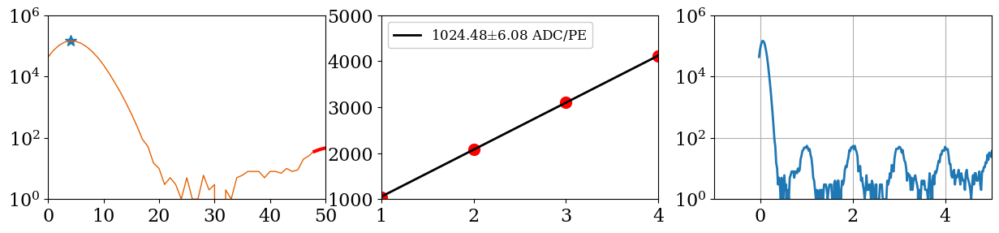

C:/Data/20221007/Step3\mca_keith_31.60OV_0.h5


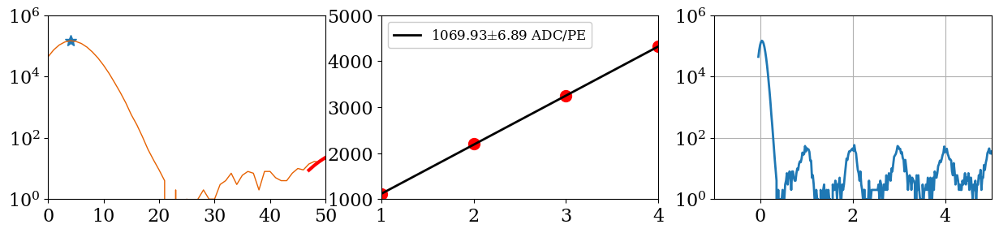

C:/Data/20221007/Step3\mca_keith_31.80OV_0.h5


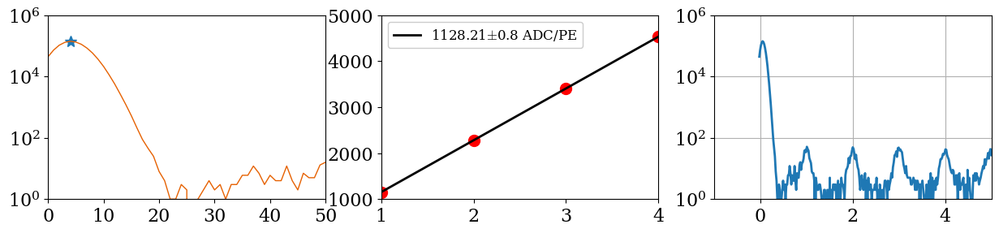

C:/Data/20221007/Step3\mca_keith_32.00OV_0.h5


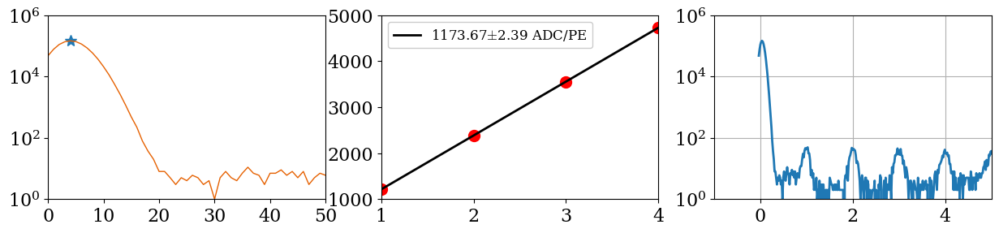

C:/Data/20221007/Step3\mca_keith_32.20OV_0.h5


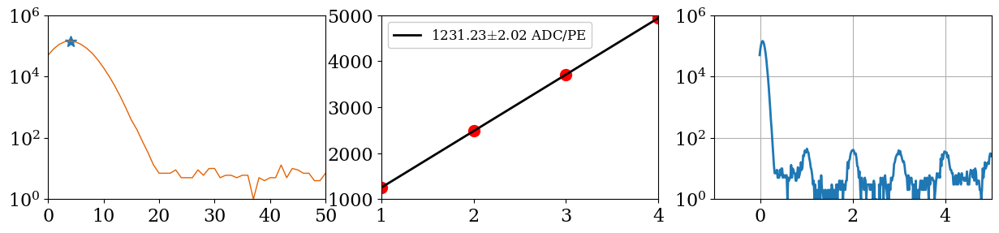

C:/Data/20221007/Step3\mca_keith_32.40OV_0.h5


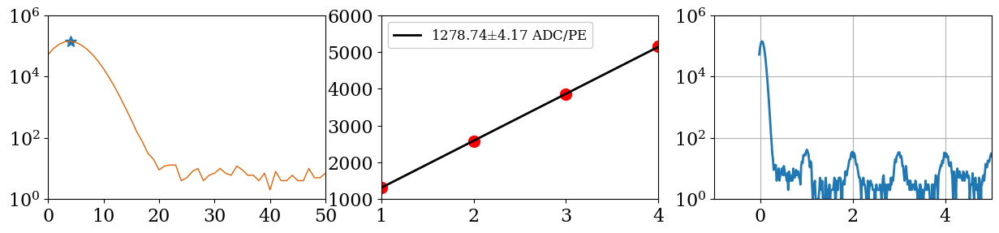

In [59]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step3_gain_list,Step3_gain_err,Step3_calib_pe,Step3_calib_count=gain_calculator(Step3,20,6,30,1,-2)
Voltages_Step3=Voltages(Step3)

C:/Data/20221007/Step4\mca_keith_30.00OV_0.h5


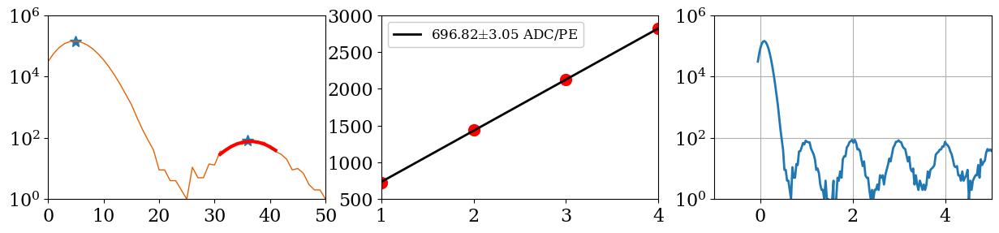

C:/Data/20221007/Step4\mca_keith_30.20OV_0.h5


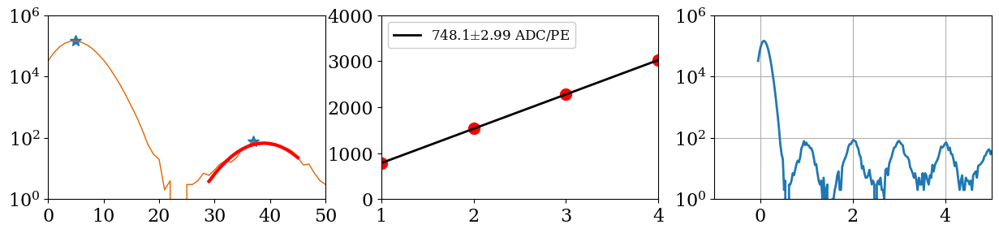

C:/Data/20221007/Step4\mca_keith_30.40OV_0.h5


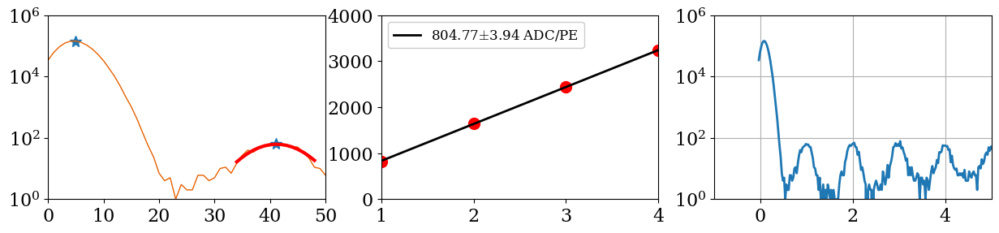

C:/Data/20221007/Step4\mca_keith_30.60OV_0.h5


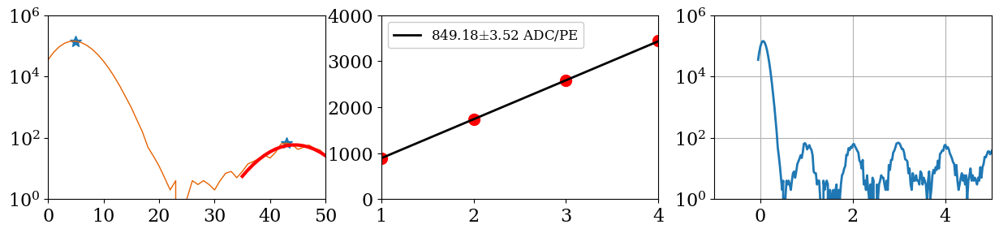

C:/Data/20221007/Step4\mca_keith_30.80OV_0.h5


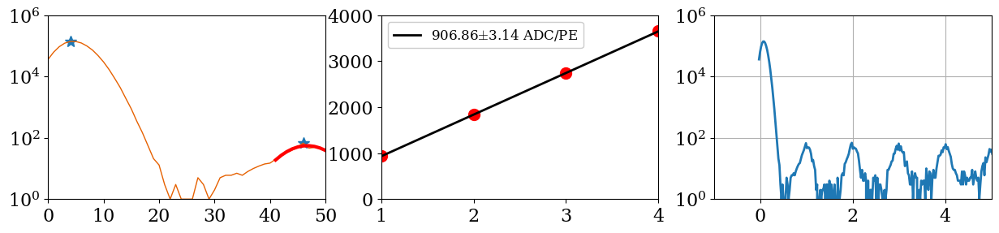

C:/Data/20221007/Step4\mca_keith_31.00OV_0.h5


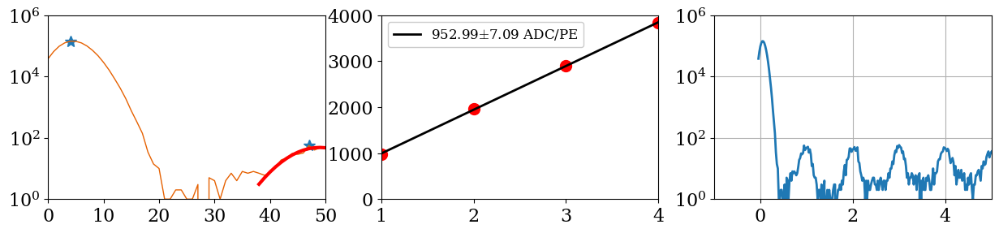

C:/Data/20221007/Step4\mca_keith_31.20OV_0.h5


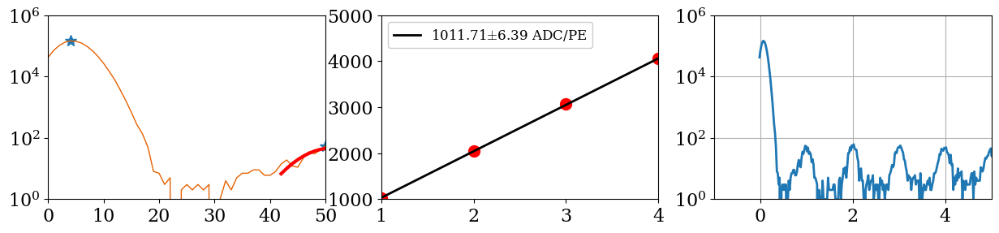

C:/Data/20221007/Step4\mca_keith_31.40OV_0.h5


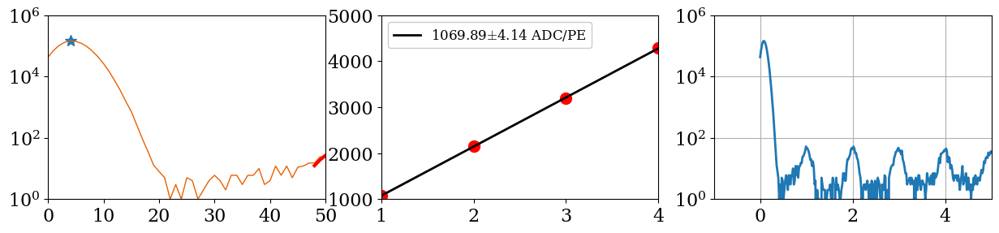

C:/Data/20221007/Step4\mca_keith_31.60OV_0.h5


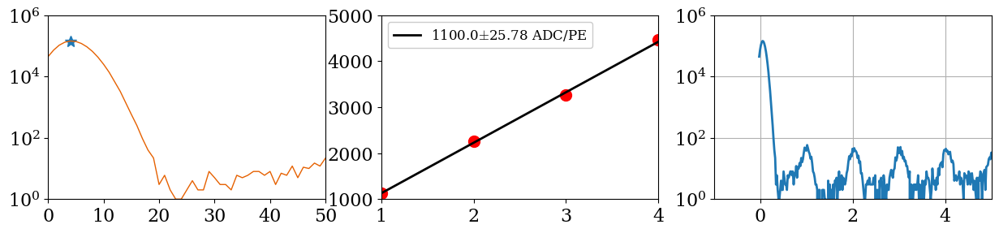

C:/Data/20221007/Step4\mca_keith_31.80OV_0.h5


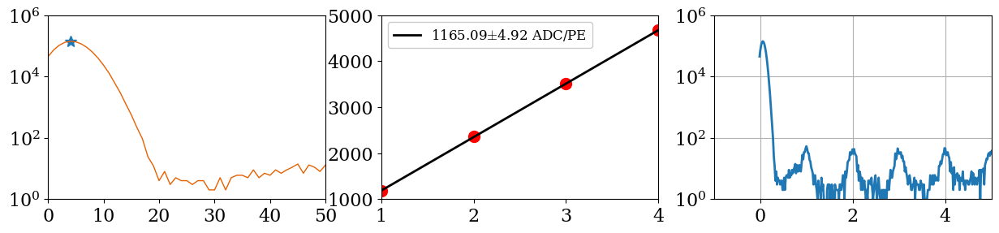

C:/Data/20221007/Step4\mca_keith_32.00OV_0.h5


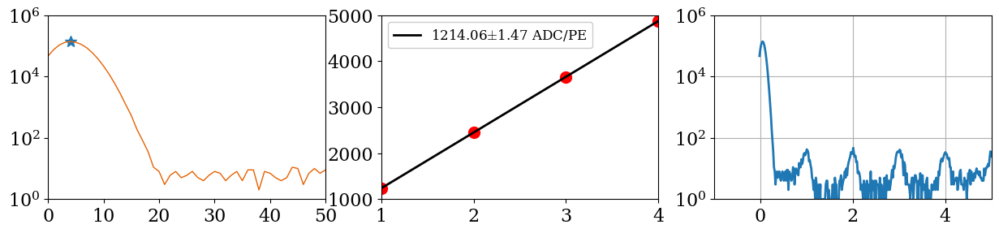

C:/Data/20221007/Step4\mca_keith_32.20OV_0.h5


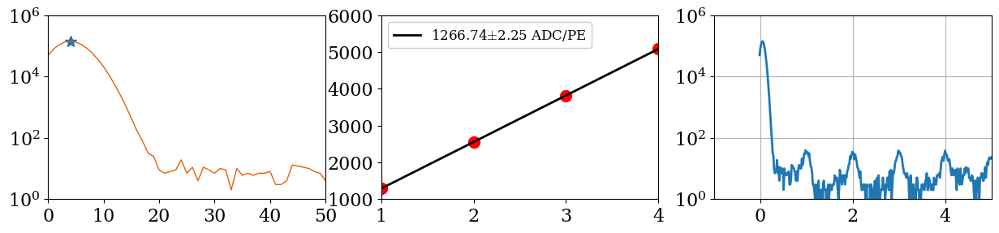

C:/Data/20221007/Step4\mca_keith_32.40OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


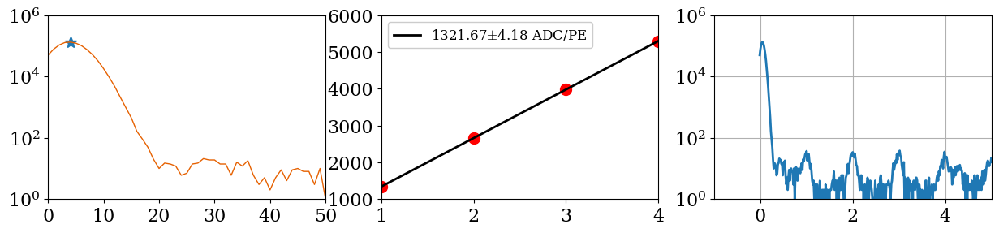

In [60]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step4_gain_list,Step4_gain_err,Step4_calib_pe,Step4_calib_count=gain_calculator(Step4,20,6,30,1,-2)
Voltages_Step4=Voltages(Step4)

C:/Data/20221007/Step5\mca_keith_30.00OV_0.h5


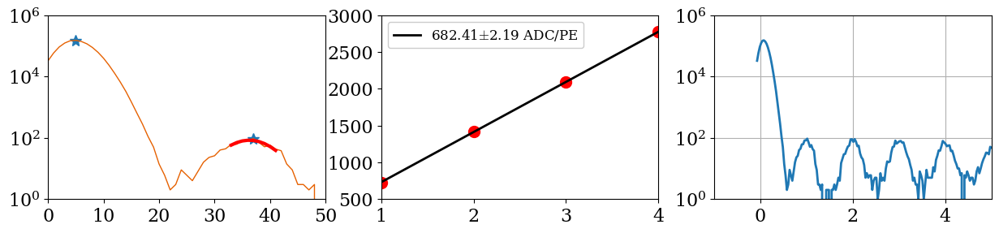

C:/Data/20221007/Step5\mca_keith_30.20OV_0.h5


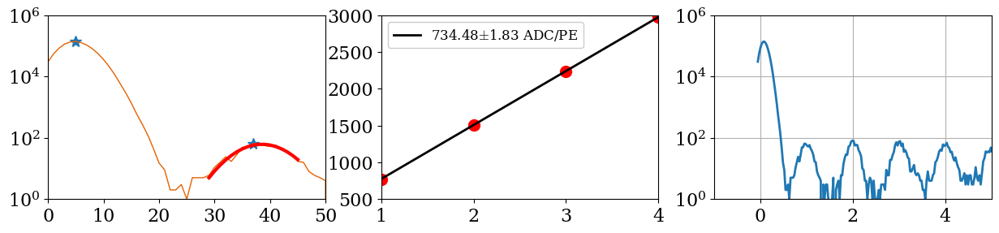

C:/Data/20221007/Step5\mca_keith_30.40OV_0.h5


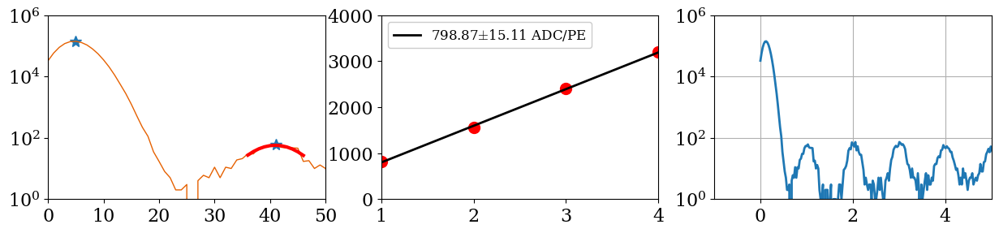

C:/Data/20221007/Step5\mca_keith_30.60OV_0.h5


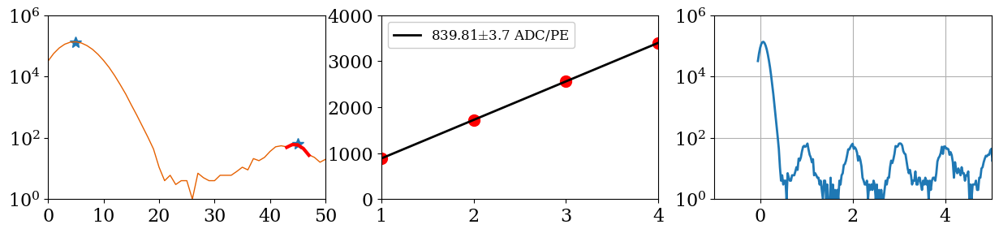

C:/Data/20221007/Step5\mca_keith_30.80OV_0.h5


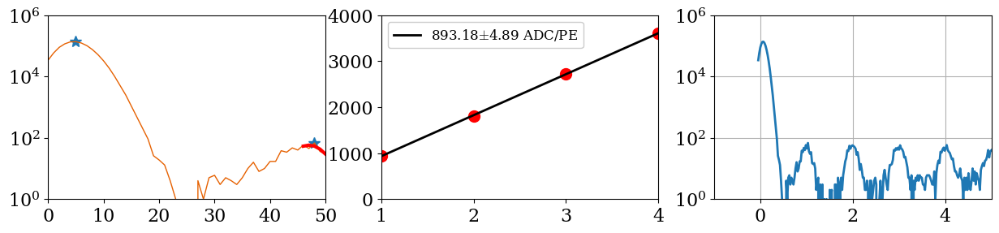

C:/Data/20221007/Step5\mca_keith_31.00OV_0.h5


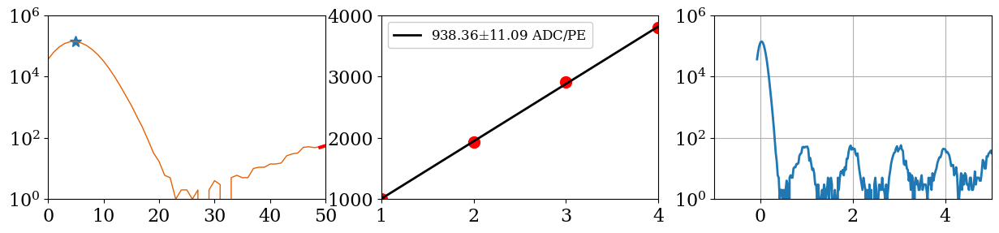

C:/Data/20221007/Step5\mca_keith_31.20OV_0.h5


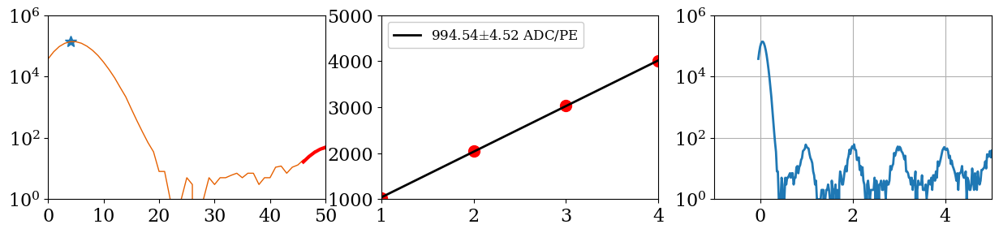

C:/Data/20221007/Step5\mca_keith_31.40OV_0.h5


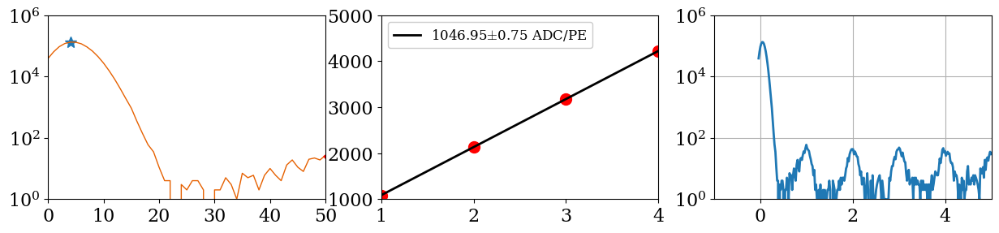

C:/Data/20221007/Step5\mca_keith_31.60OV_0.h5


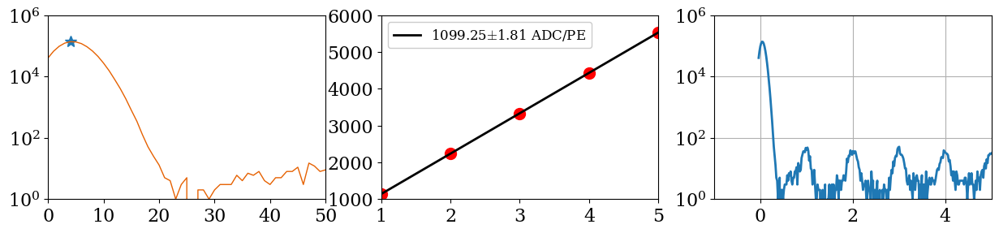

C:/Data/20221007/Step5\mca_keith_31.80OV_0.h5


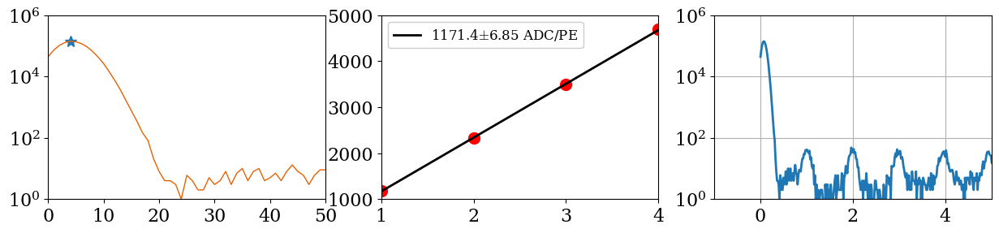

C:/Data/20221007/Step5\mca_keith_32.00OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


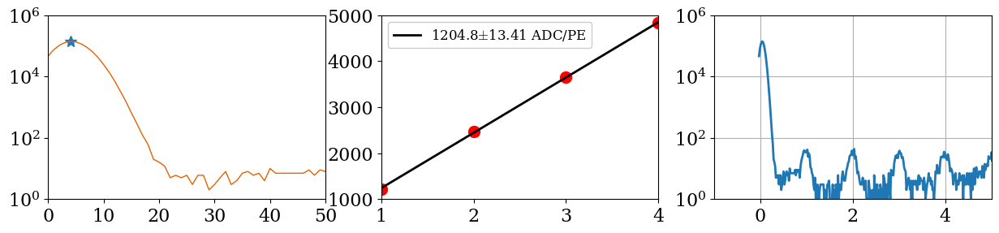

C:/Data/20221007/Step5\mca_keith_32.20OV_0.h5


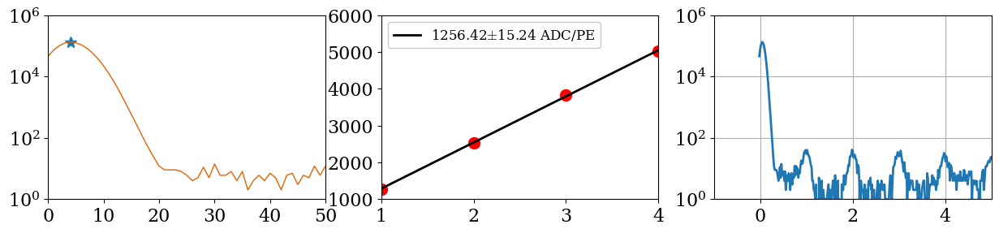

C:/Data/20221007/Step5\mca_keith_32.40OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


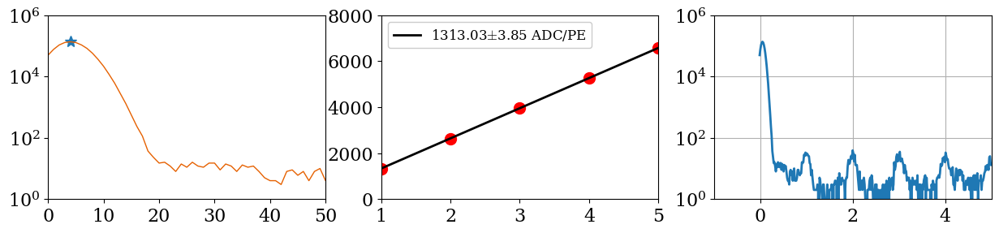

In [61]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step5_gain_list,Step5_gain_err,Step5_calib_pe,Step5_calib_count=gain_calculator(Step5,20,6,30,1,-2)
Voltages_Step5=Voltages(Step5)

C:/Data/20221007/Step6\mca_keith_30.00OV_0.h5


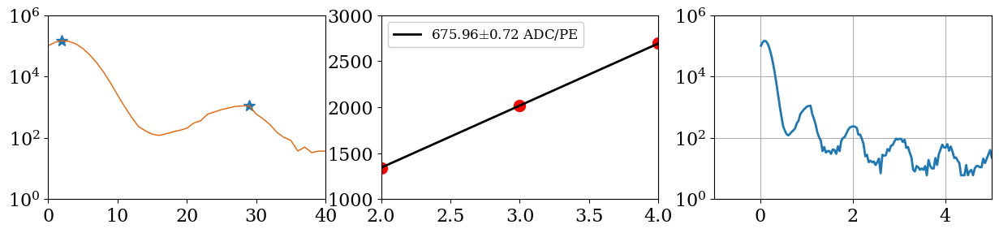

C:/Data/20221007/Step6\mca_keith_30.20OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


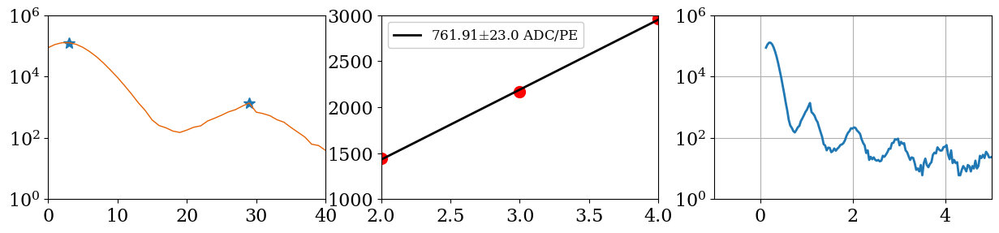

C:/Data/20221007/Step6\mca_keith_30.40OV_0.h5


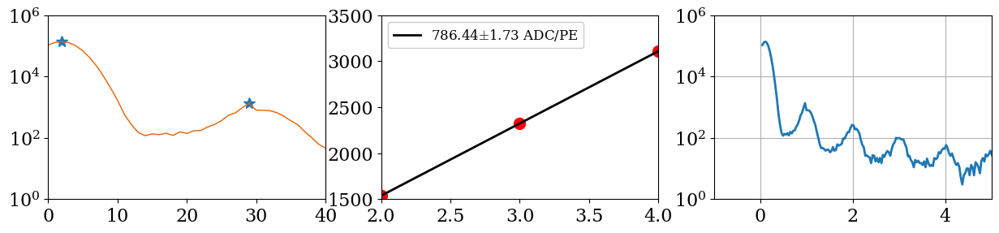

C:/Data/20221007/Step6\mca_keith_30.60OV_0.h5


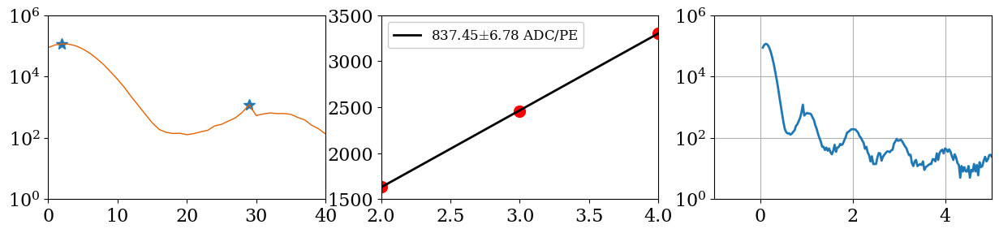

C:/Data/20221007/Step6\mca_keith_30.80OV_0.h5


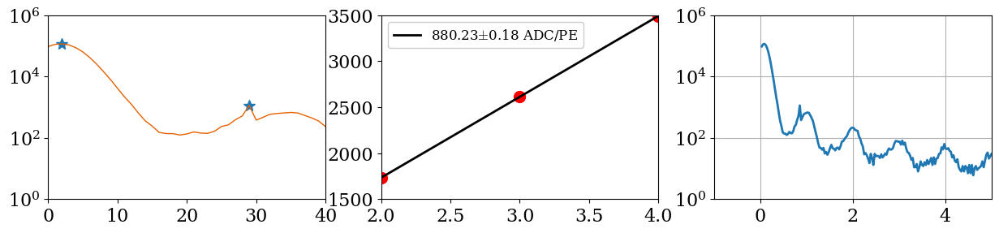

C:/Data/20221007/Step6\mca_keith_31.00OV_0.h5


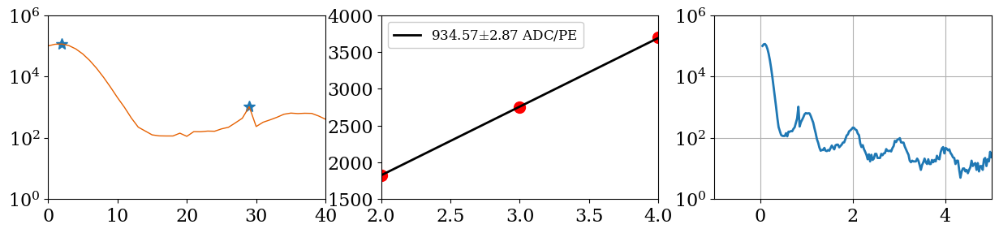

C:/Data/20221007/Step6\mca_keith_31.20OV_0.h5


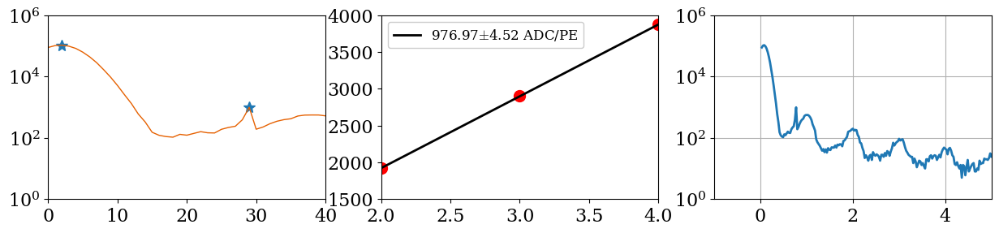

C:/Data/20221007/Step6\mca_keith_31.40OV_0.h5


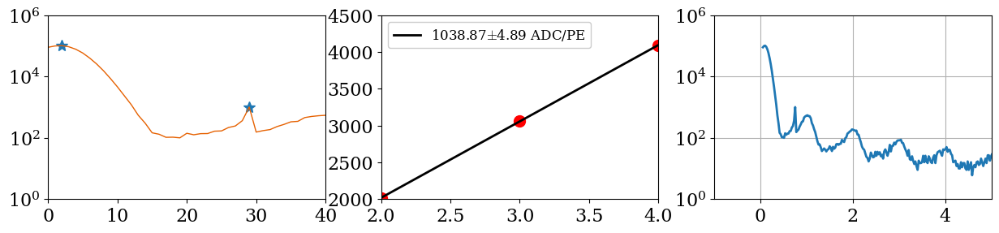

C:/Data/20221007/Step6\mca_keith_31.60OV_0.h5


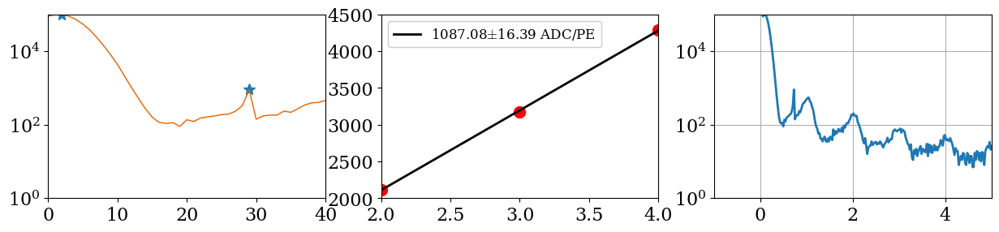

C:/Data/20221007/Step6\mca_keith_31.80OV_0.h5


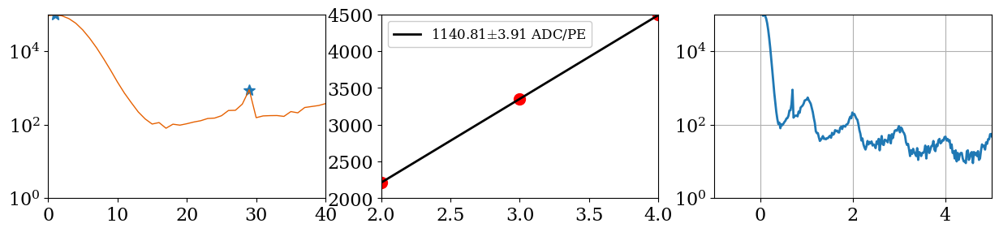

C:/Data/20221007/Step6\mca_keith_32.00OV_0.h5


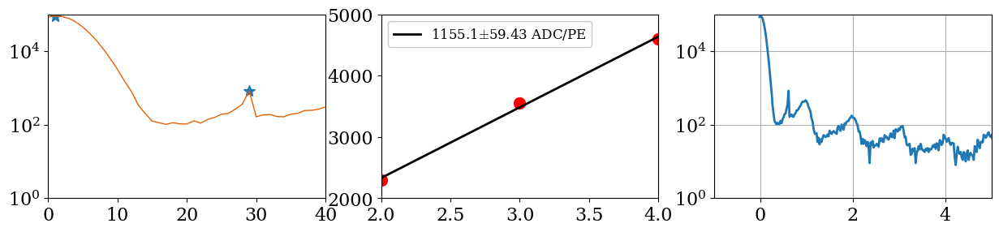

C:/Data/20221007/Step6\mca_keith_32.20OV_0.h5


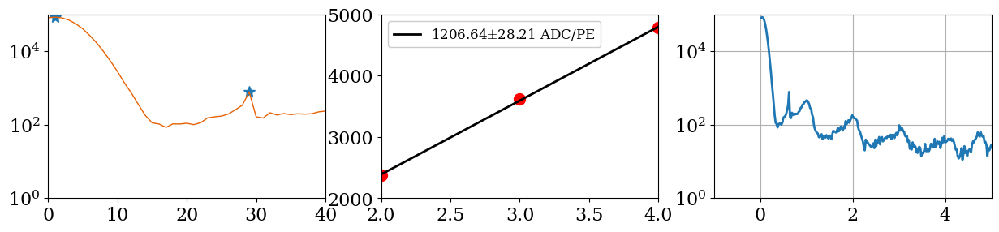

C:/Data/20221007/Step6\mca_keith_32.40OV_0.h5


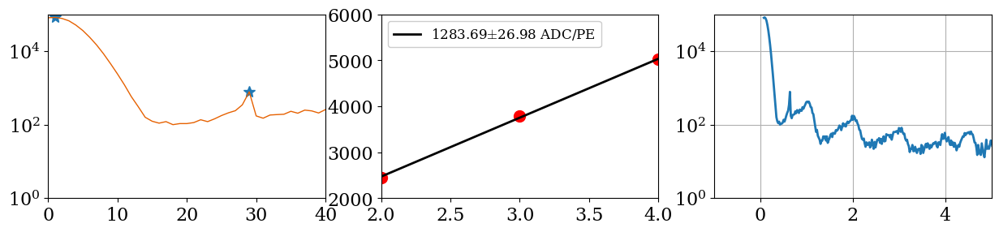

In [62]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step6_gain_list,Step6_gain_err,Step6_calib_pe,Step6_calib_count=gain_calculator(Step6,25,6,25,2,-2)
Voltages_Step6=Voltages(Step6)

C:/Data/20221007/Step7\mca_keith_30.00OV_0.h5


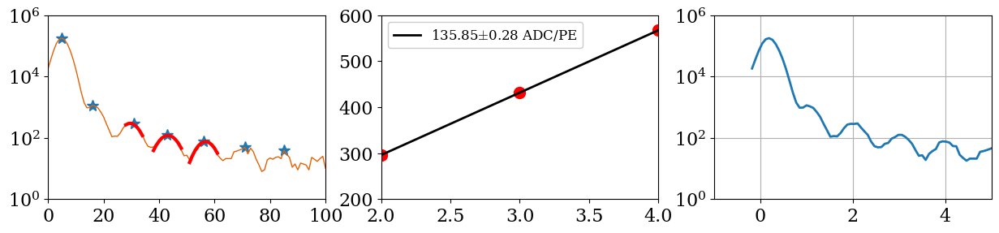

C:/Data/20221007/Step7\mca_keith_30.50OV_0.h5


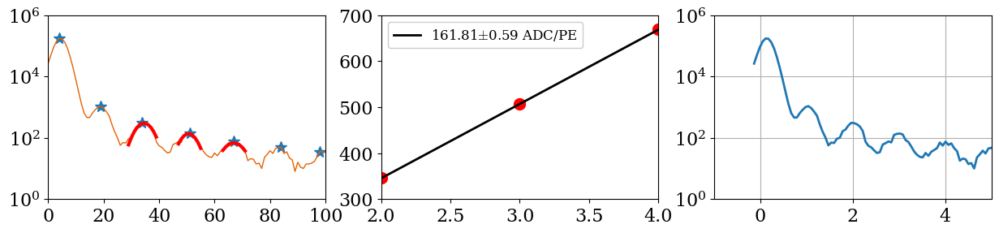

C:/Data/20221007/Step7\mca_keith_31.00OV_0.h5


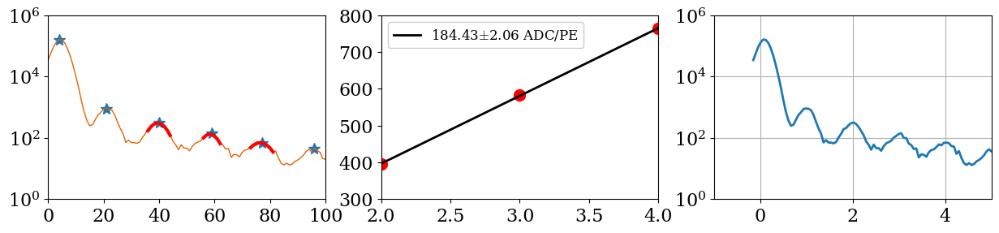

C:/Data/20221007/Step7\mca_keith_31.50OV_0.h5


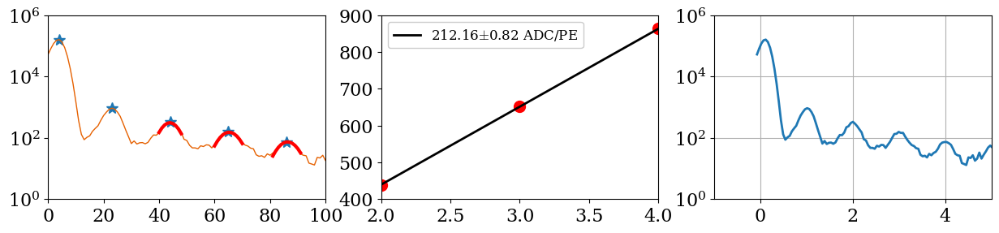

C:/Data/20221007/Step7\mca_keith_32.00OV_0.h5


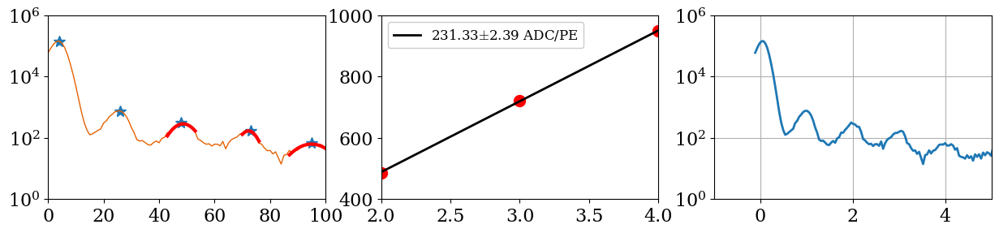

In [63]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step7_gain_list,Step7_gain_err,Step7_calib_pe,Step7_calib_count=gain_calculator(Step7,10,6,10,2,-2)
Voltages_Step7=Voltages(Step7)

C:/Data/20221007/Step8\mca_keith_30.00OV_0.h5


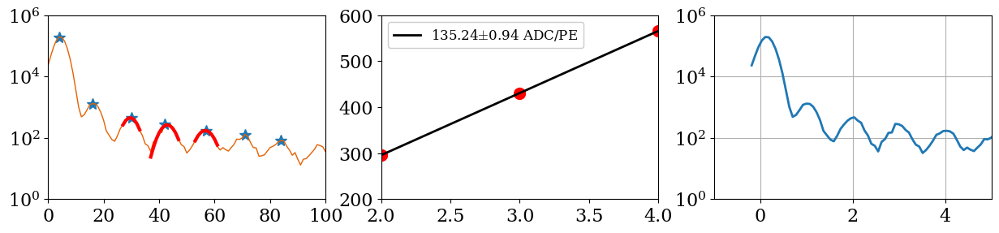

C:/Data/20221007/Step8\mca_keith_30.50OV_0.h5


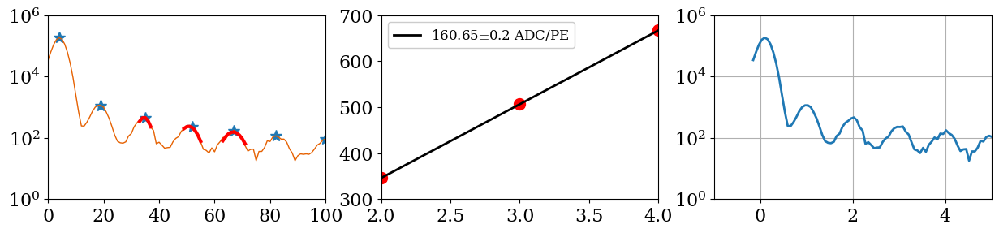

C:/Data/20221007/Step8\mca_keith_31.00OV_0.h5


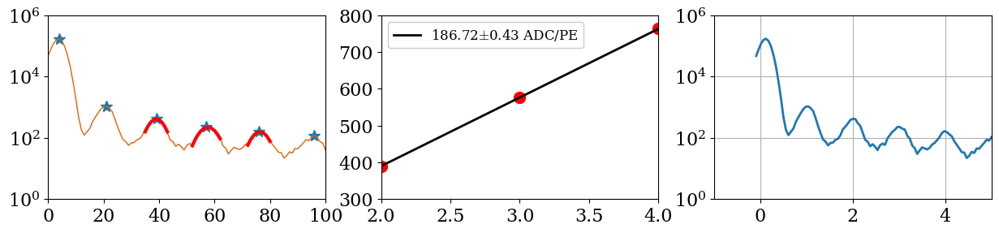

C:/Data/20221007/Step8\mca_keith_31.50OV_0.h5


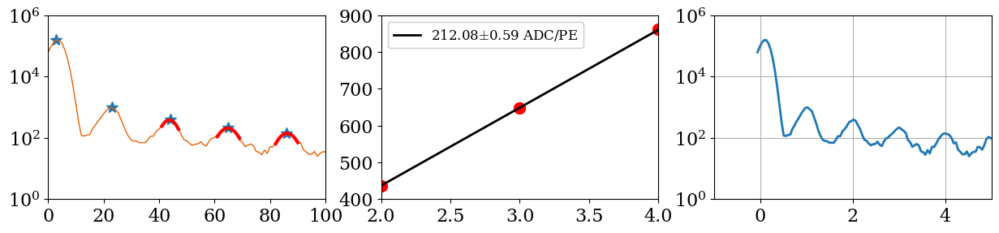

C:/Data/20221007/Step8\mca_keith_32.00OV_0.h5


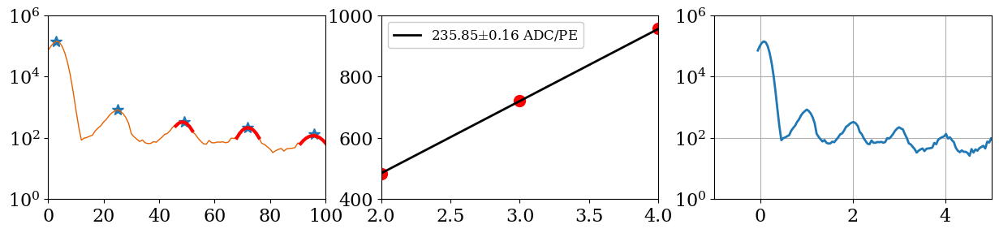

In [64]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step8_gain_list,Step8_gain_err,Step8_calib_pe,Step8_calib_count=gain_calculator(Step8,10,6,10,2,-2)
Voltages_Step8=Voltages(Step8)

C:/Data/20221007/Step9\mca_keith_31.40OV_0.h5


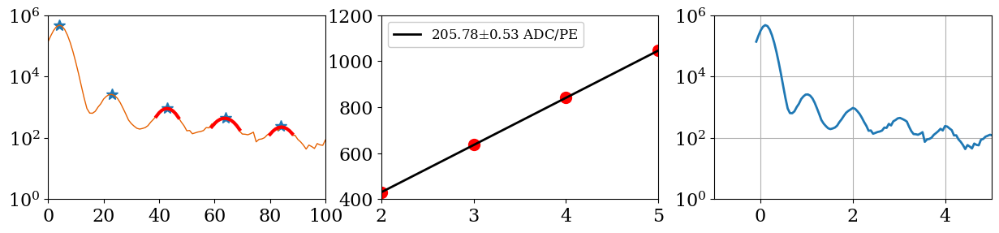

C:/Data/20221007/Step9\mca_keith_31.40OV_1.h5


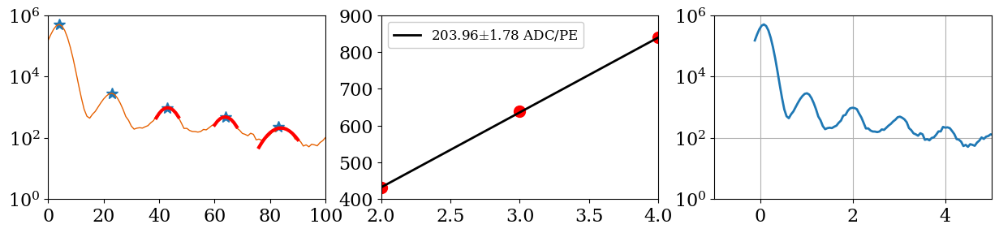

C:/Data/20221007/Step9\mca_keith_31.40OV_2.h5


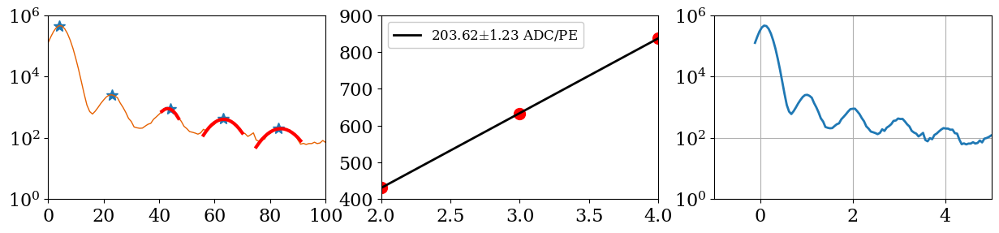

C:/Data/20221007/Step9\mca_keith_31.40OV_3.h5


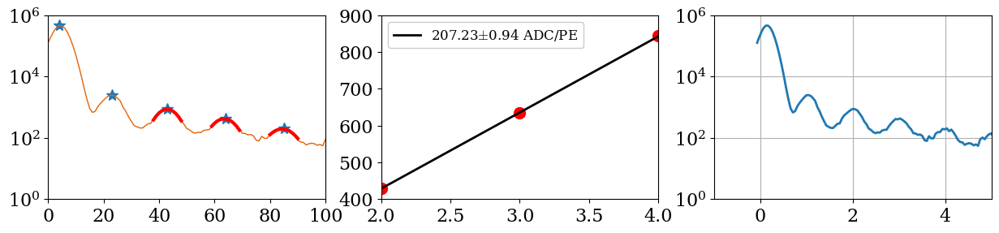

C:/Data/20221007/Step9\mca_keith_31.40OV_4.h5


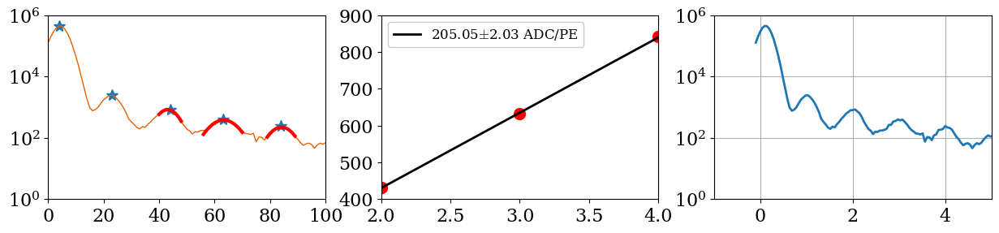

C:/Data/20221007/Step9\mca_keith_31.40OV_5.h5


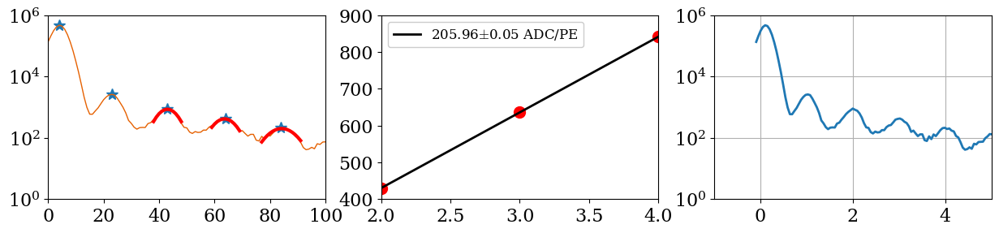

In [65]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step9_gain_list,Step9_gain_err,Step9_calib_pe,Step9_calib_count=gain_calculator(Step9,10,6,1,2,-2)
Voltages_Step9=Voltages(Step9)

C:/Data/20221007/Step10\mca_keith_29.90OV_0.h5


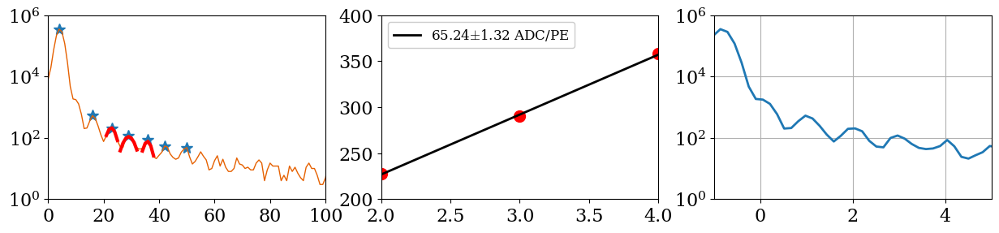

C:/Data/20221007/Step10\mca_keith_30.40OV_0.h5


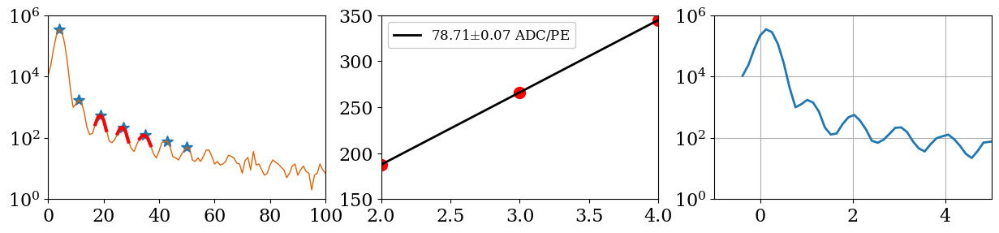

C:/Data/20221007/Step10\mca_keith_30.90OV_0.h5


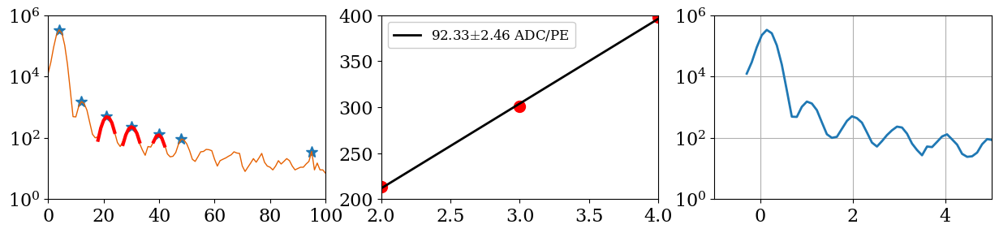

C:/Data/20221007/Step10\mca_keith_31.40OV_0.h5


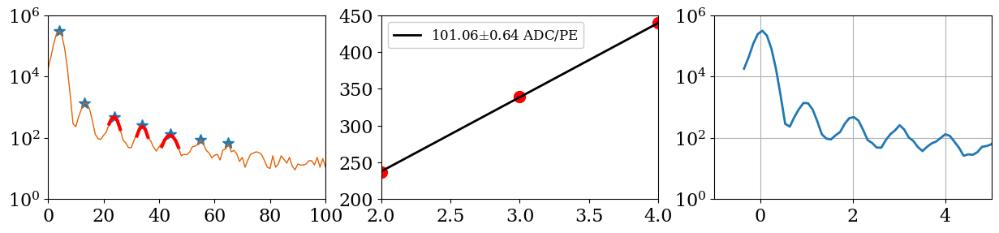

C:/Data/20221007/Step10\mca_keith_31.90OV_0.h5


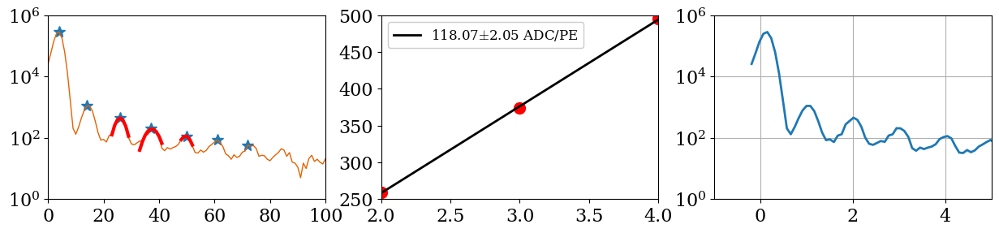

In [66]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step10_gain_list,Step10_gain_err,Step10_calib_pe,Step10_calib_count=gain_calculator(Step10,10,6,1,2,-2)
Voltages_Step10=Voltages(Step10)

C:/Data/20221007/Step11\mca_keith_31.40OV_0.h5


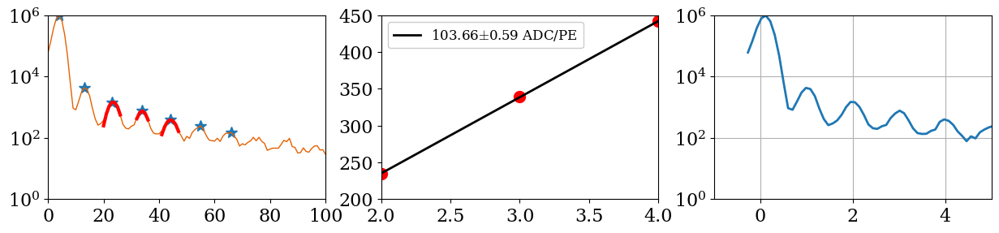

C:/Data/20221007/Step11\mca_keith_31.40OV_1.h5


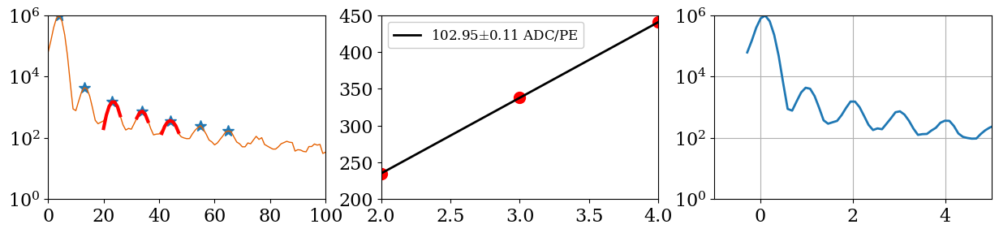

C:/Data/20221007/Step11\mca_keith_31.40OV_2.h5


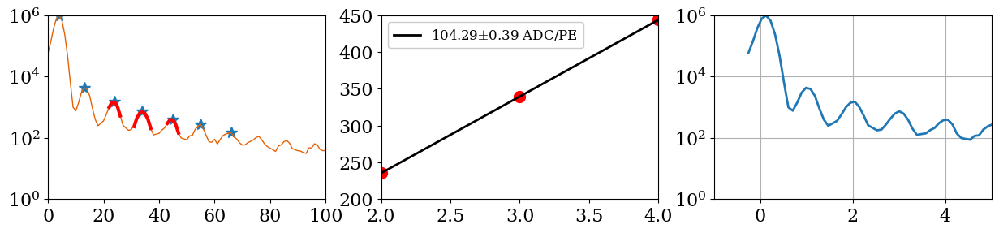

C:/Data/20221007/Step11\mca_keith_31.40OV_3.h5


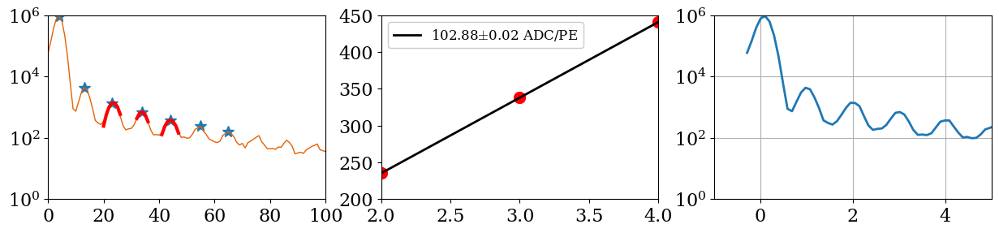

C:/Data/20221007/Step11\mca_keith_31.40OV_4.h5


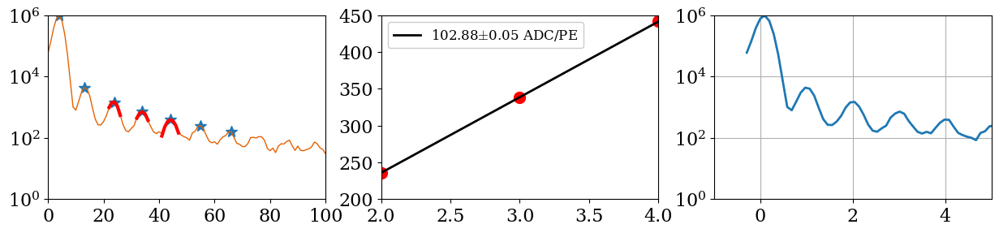

C:/Data/20221007/Step11\mca_keith_31.40OV_5.h5


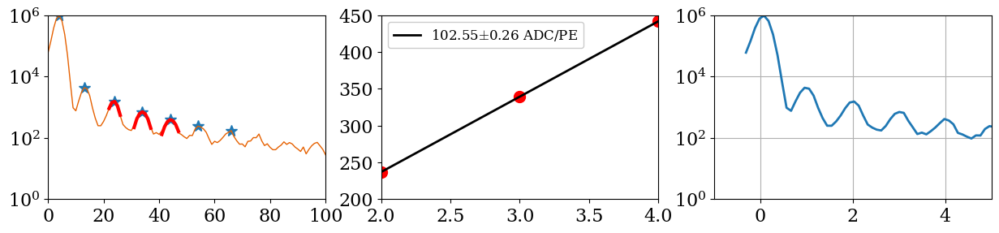

C:/Data/20221007/Step11\mca_keith_31.40OV_6.h5


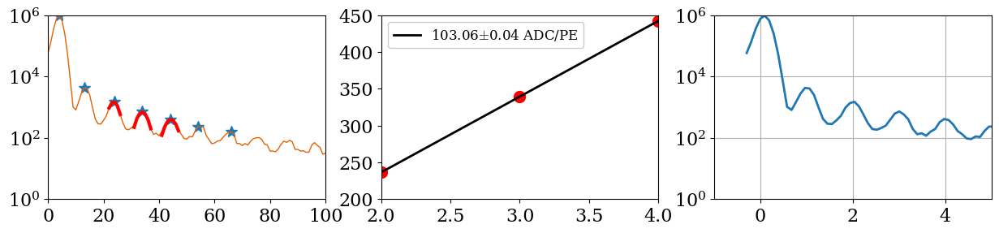

C:/Data/20221007/Step11\mca_keith_31.40OV_7.h5


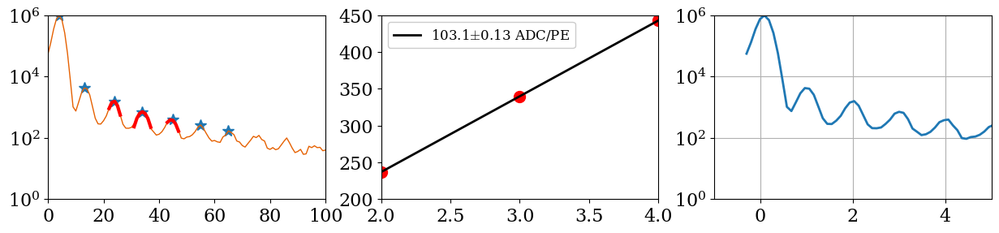

C:/Data/20221007/Step11\mca_keith_31.40OV_8.h5


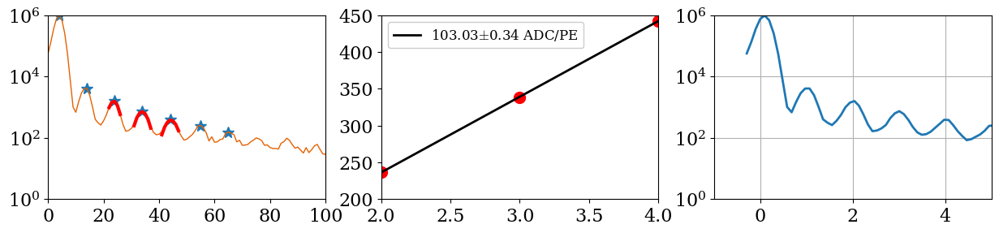

C:/Data/20221007/Step11\mca_keith_31.40OV_9.h5


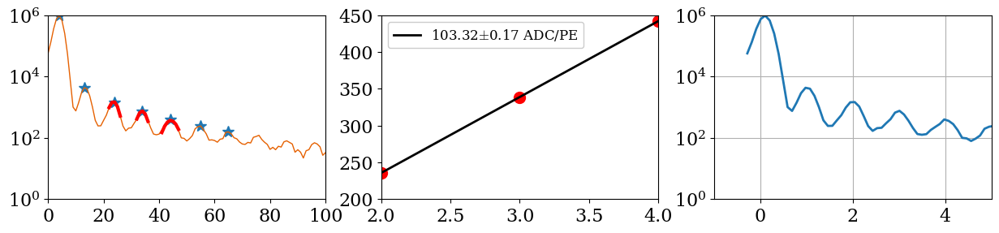

C:/Data/20221007/Step11\mca_keith_31.40OV_10.h5


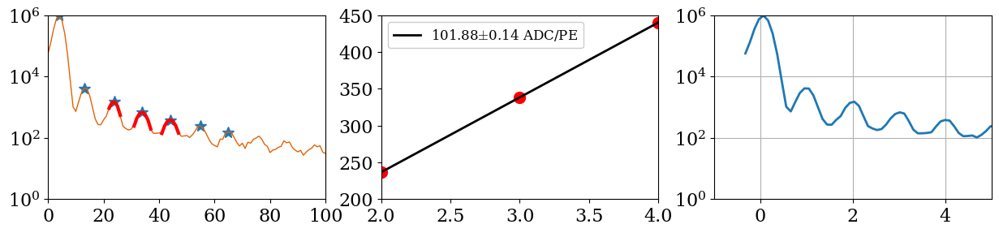

C:/Data/20221007/Step11\mca_keith_31.40OV_11.h5


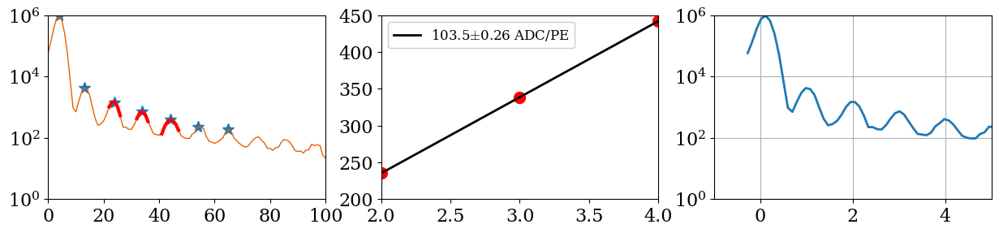

C:/Data/20221007/Step11\mca_keith_31.40OV_12.h5


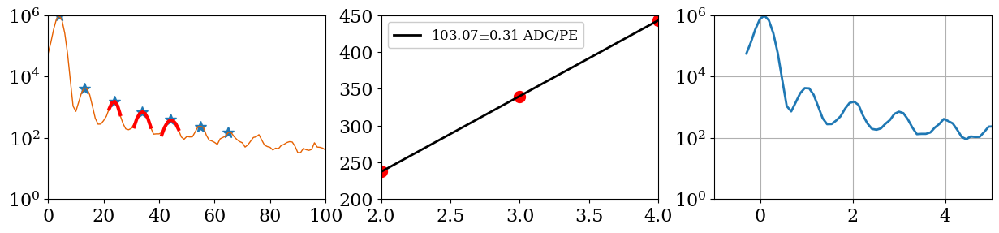

C:/Data/20221007/Step11\mca_keith_31.40OV_13.h5


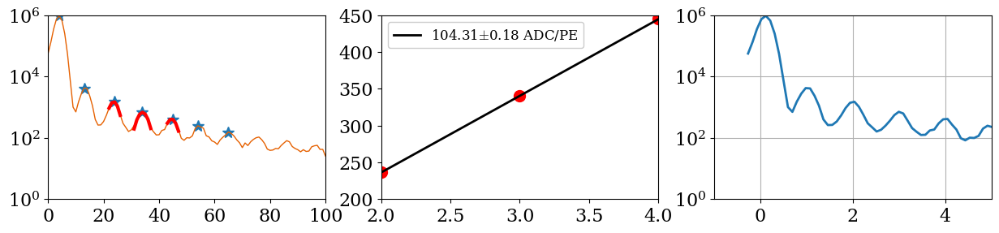

C:/Data/20221007/Step11\mca_keith_31.40OV_14.h5


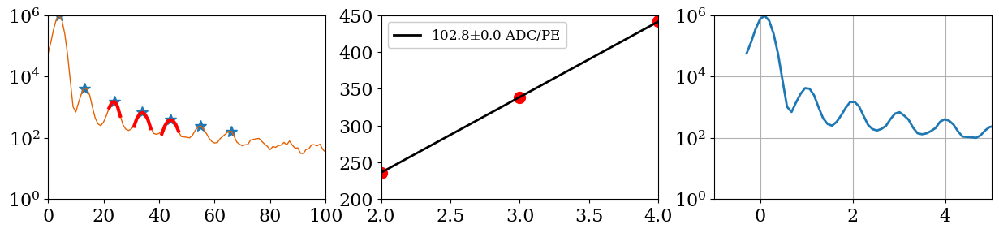

C:/Data/20221007/Step11\mca_keith_31.40OV_15.h5


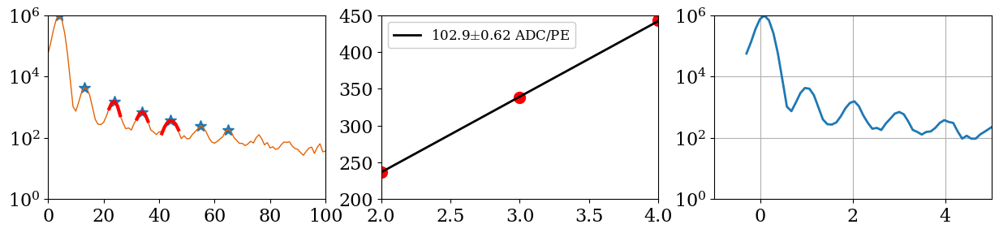

C:/Data/20221007/Step11\mca_keith_31.40OV_16.h5


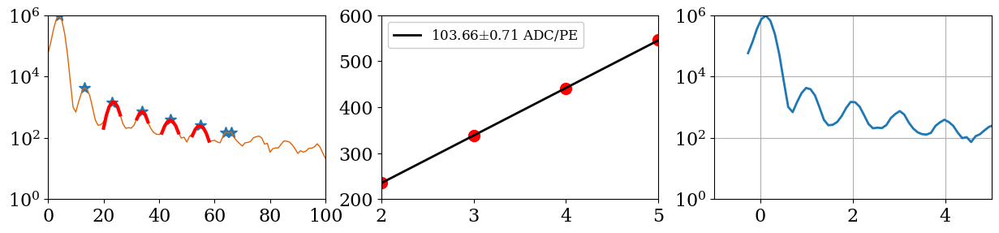

C:/Data/20221007/Step11\mca_keith_31.40OV_17.h5


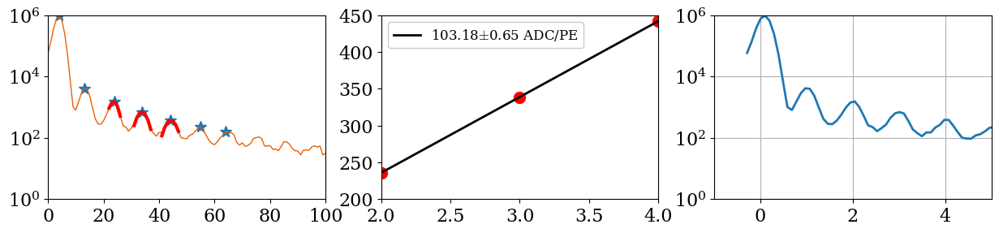

C:/Data/20221007/Step11\mca_keith_31.40OV_18.h5


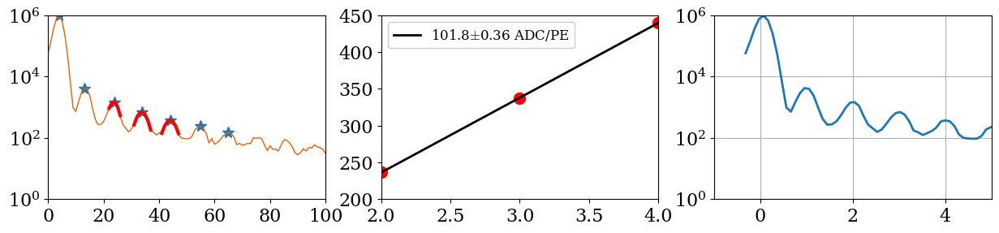

C:/Data/20221007/Step11\mca_keith_31.40OV_19.h5


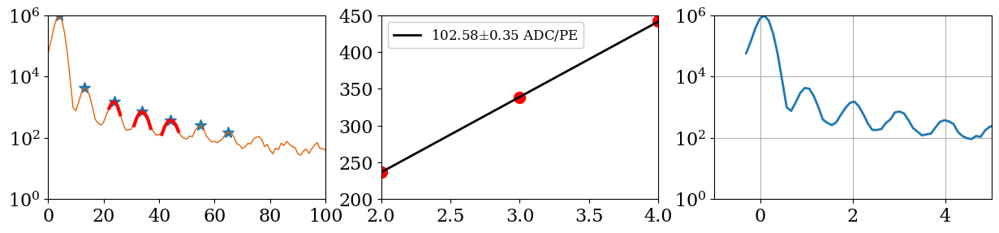

C:/Data/20221007/Step11\mca_keith_31.40OV_20.h5


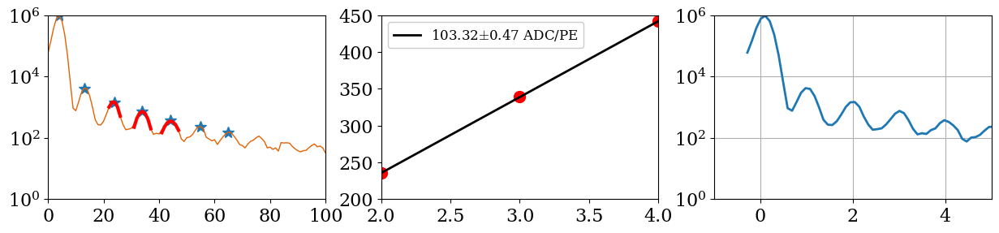

C:/Data/20221007/Step11\mca_keith_31.40OV_21.h5


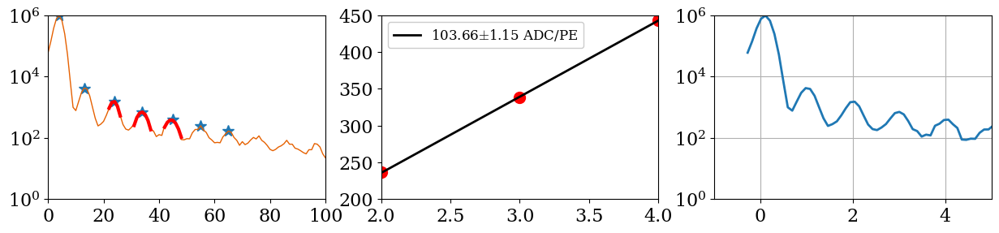

C:/Data/20221007/Step11\mca_keith_31.40OV_22.h5


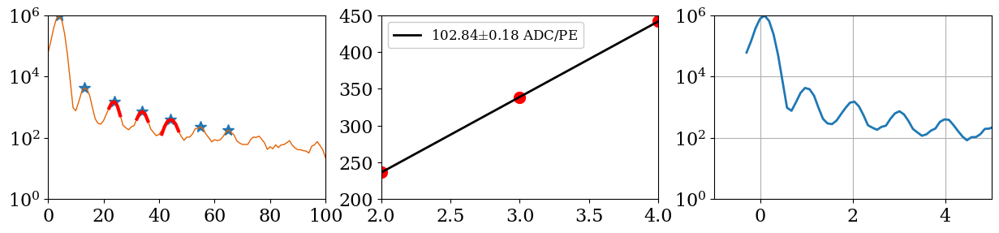

C:/Data/20221007/Step11\mca_keith_31.40OV_23.h5


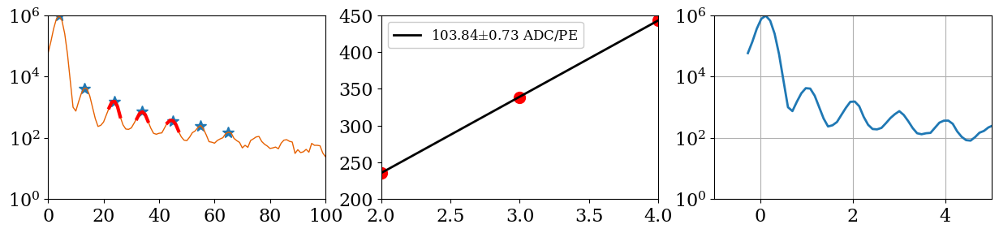

C:/Data/20221007/Step11\mca_keith_31.40OV_24.h5


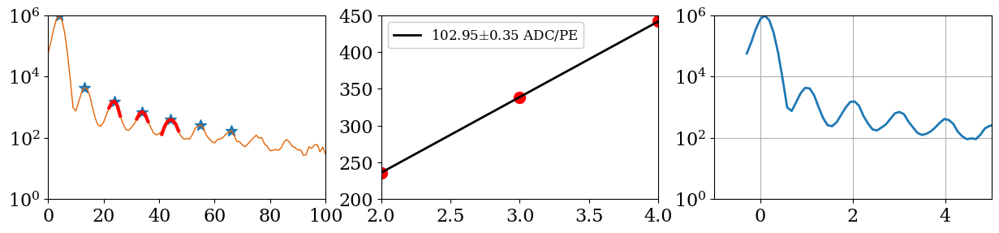

C:/Data/20221007/Step11\mca_keith_31.40OV_25.h5


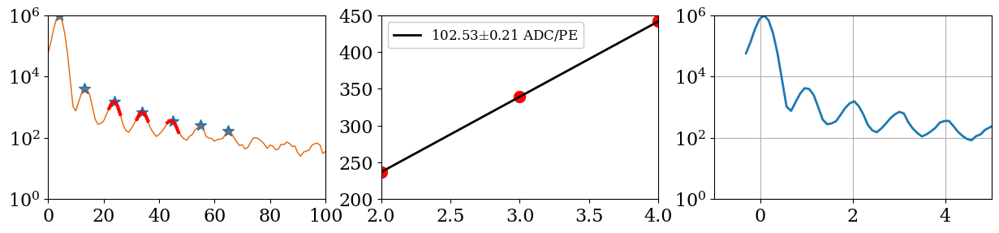

C:/Data/20221007/Step11\mca_keith_31.40OV_26.h5


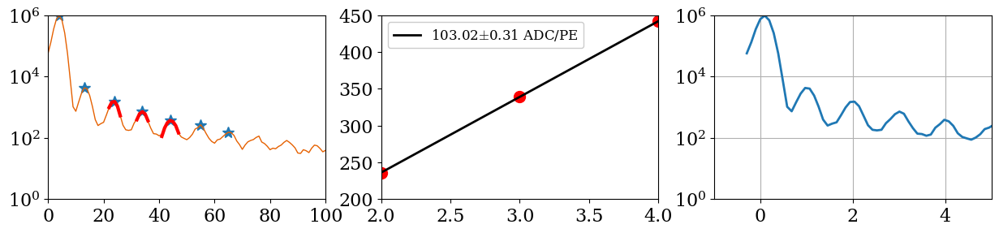

C:/Data/20221007/Step11\mca_keith_31.40OV_27.h5


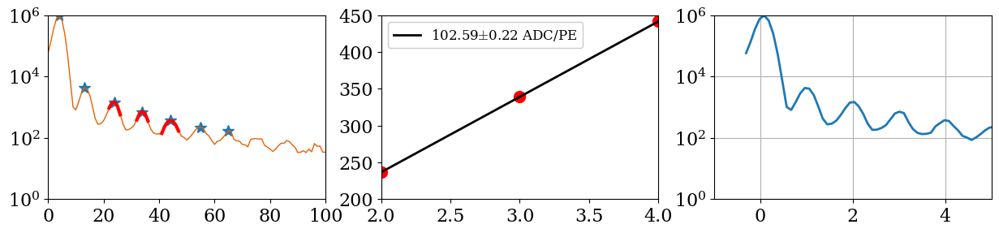

C:/Data/20221007/Step11\mca_keith_31.40OV_28.h5


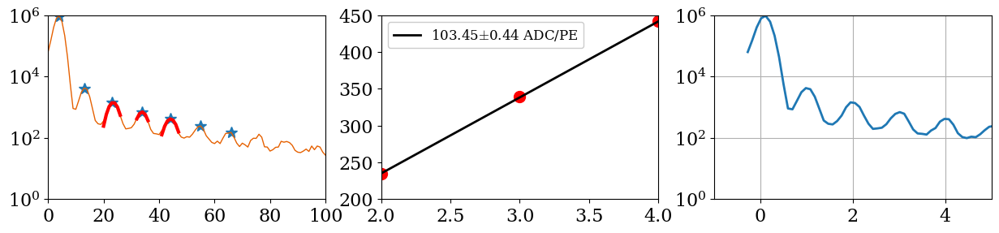

C:/Data/20221007/Step11\mca_keith_31.40OV_29.h5


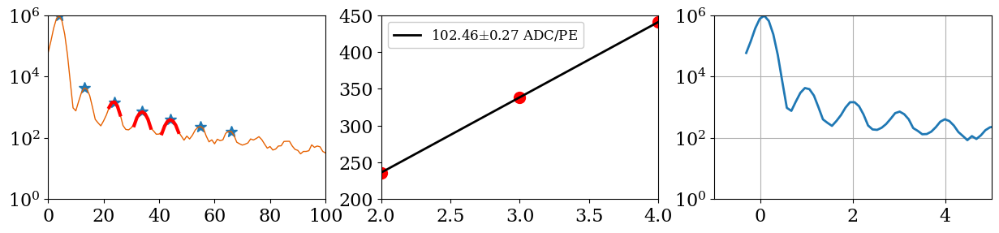

C:/Data/20221007/Step11\mca_keith_31.40OV_30.h5


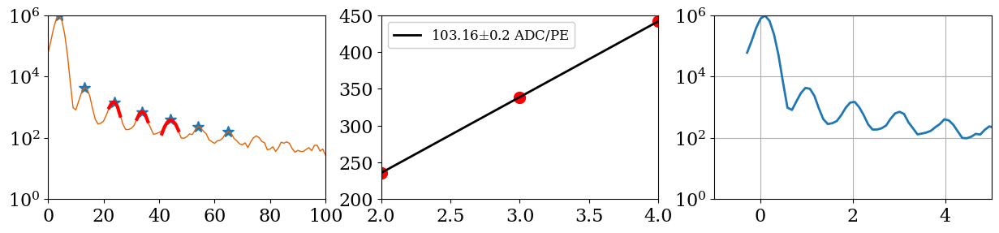

C:/Data/20221007/Step11\mca_keith_31.40OV_31.h5


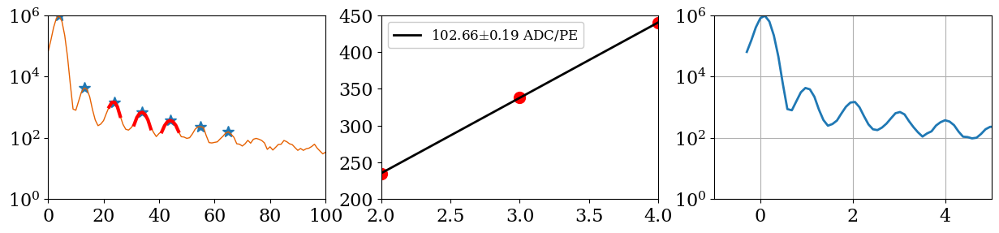

C:/Data/20221007/Step11\mca_keith_31.40OV_32.h5


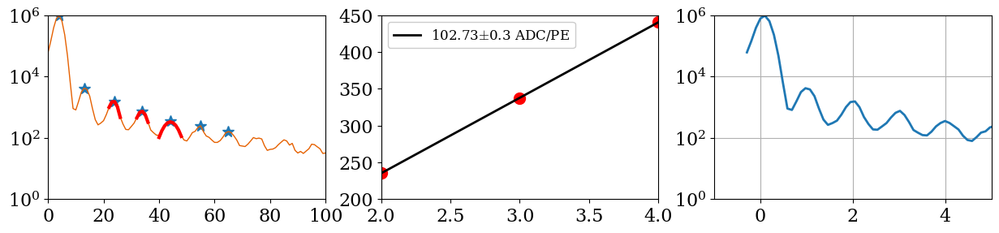

C:/Data/20221007/Step11\mca_keith_31.40OV_33.h5


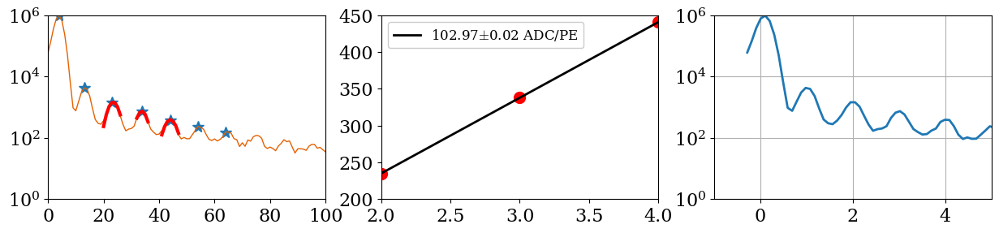

C:/Data/20221007/Step11\mca_keith_31.40OV_34.h5


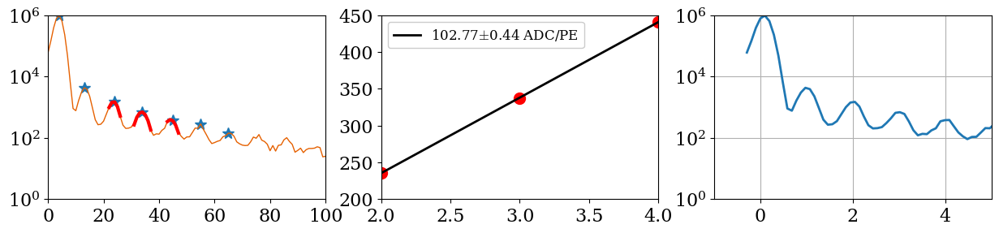

C:/Data/20221007/Step11\mca_keith_31.40OV_35.h5


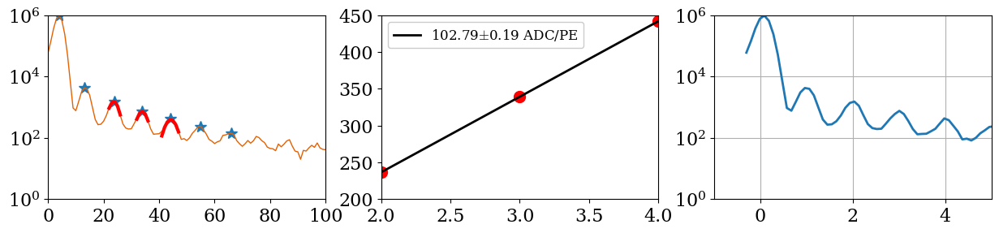

C:/Data/20221007/Step11\mca_keith_31.40OV_36.h5


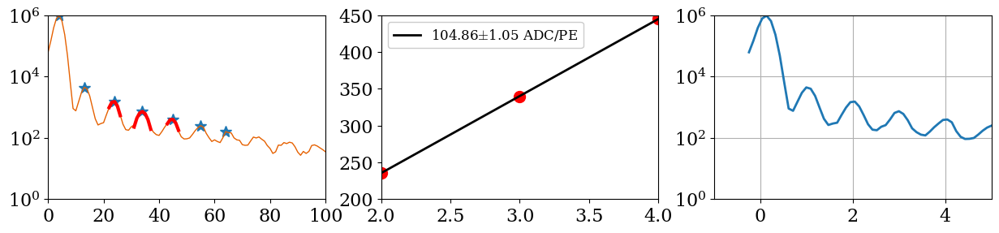

C:/Data/20221007/Step11\mca_keith_31.40OV_37.h5


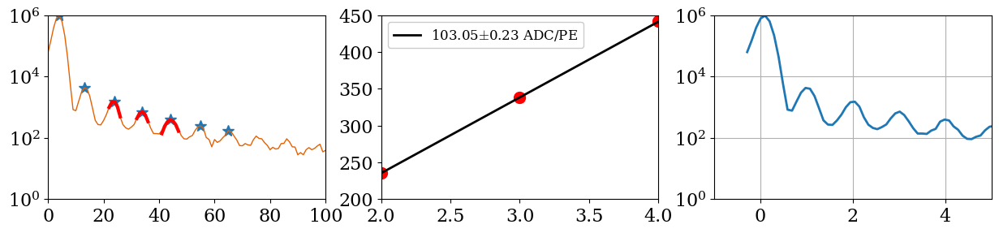

C:/Data/20221007/Step11\mca_keith_31.40OV_38.h5


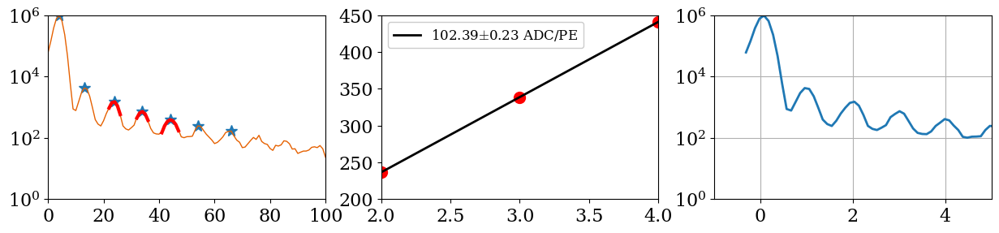

C:/Data/20221007/Step11\mca_keith_31.40OV_39.h5


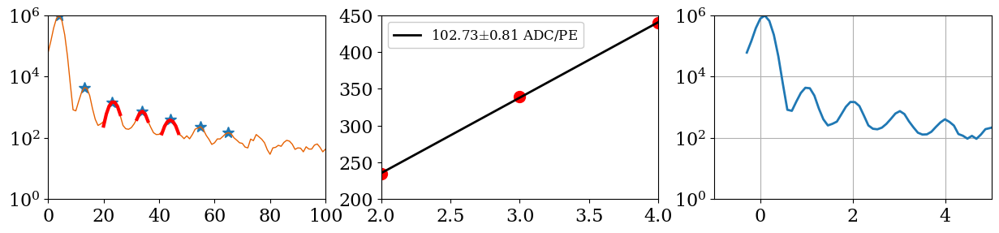

C:/Data/20221007/Step11\mca_keith_31.40OV_40.h5


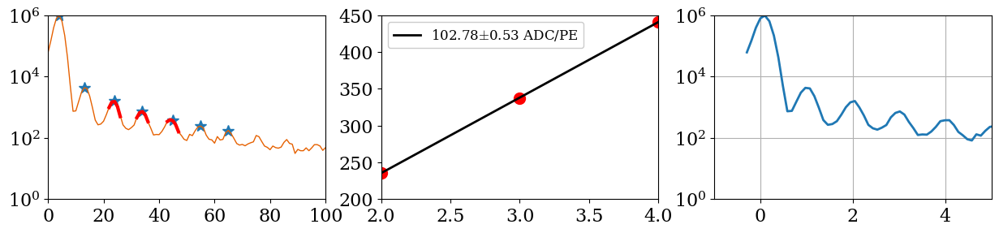

C:/Data/20221007/Step11\mca_keith_31.40OV_41.h5


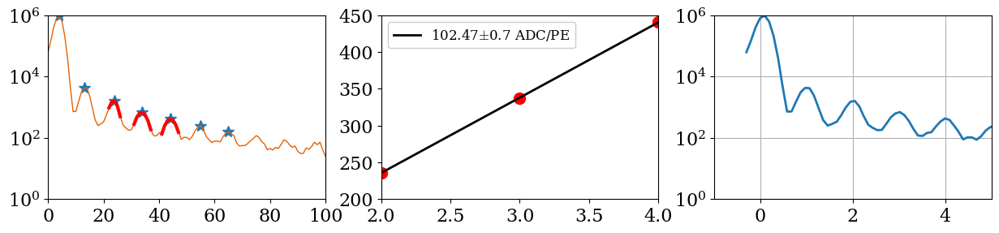

C:/Data/20221007/Step11\mca_keith_31.40OV_42.h5


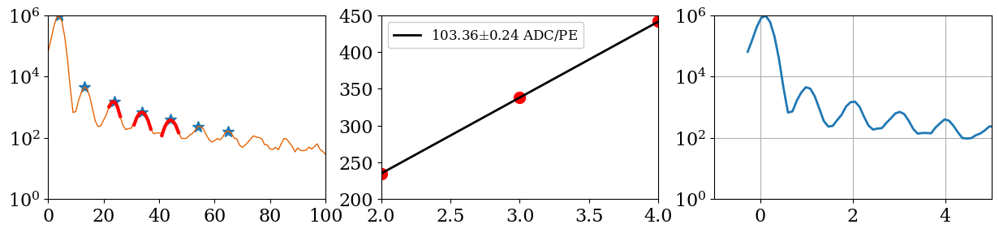

C:/Data/20221007/Step11\mca_keith_31.40OV_43.h5


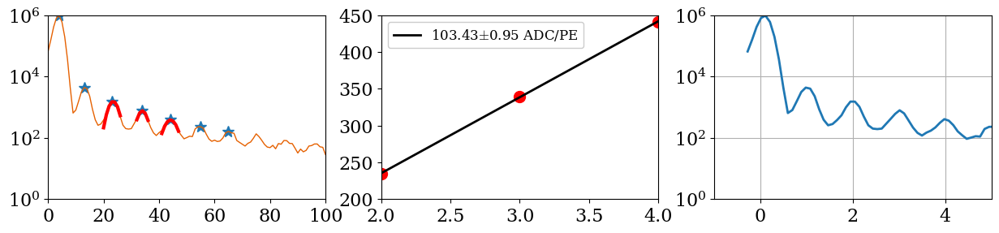

C:/Data/20221007/Step11\mca_keith_31.40OV_44.h5


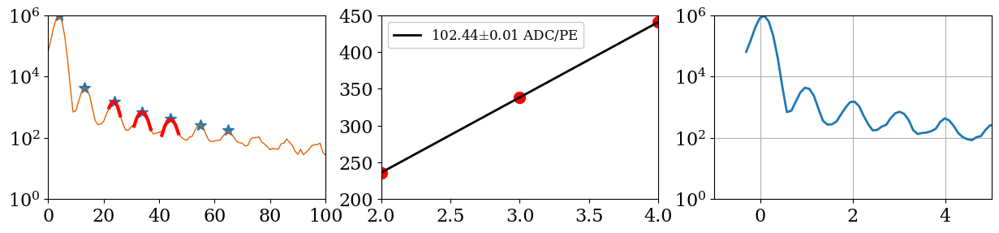

C:/Data/20221007/Step11\mca_keith_31.40OV_45.h5


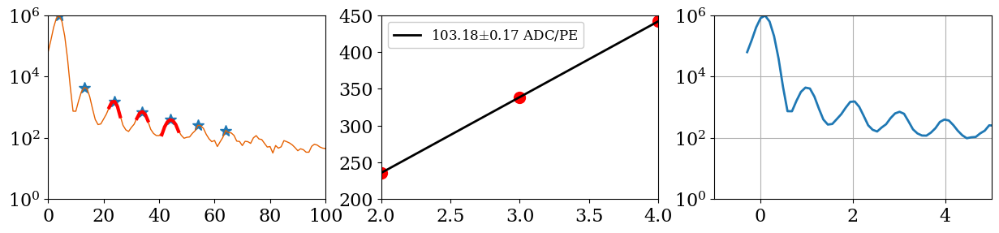

C:/Data/20221007/Step11\mca_keith_31.40OV_46.h5


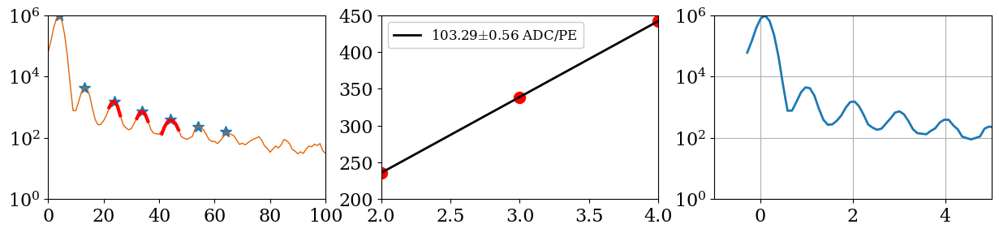

C:/Data/20221007/Step11\mca_keith_31.40OV_47.h5


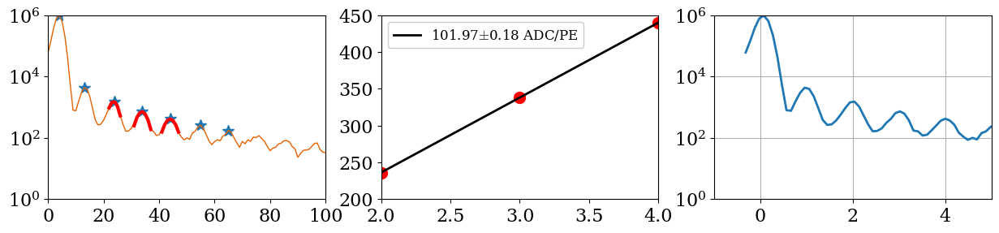

C:/Data/20221007/Step11\mca_keith_31.40OV_48.h5


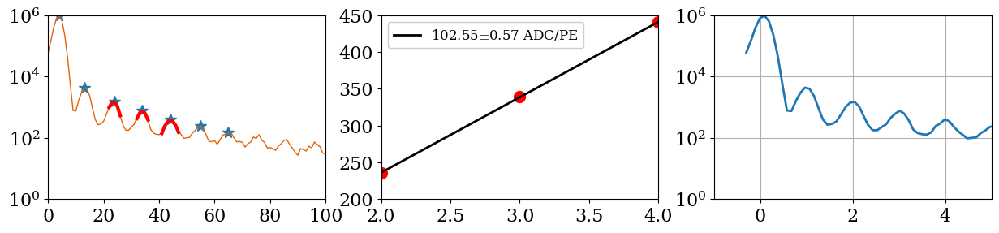

C:/Data/20221007/Step11\mca_keith_31.40OV_49.h5


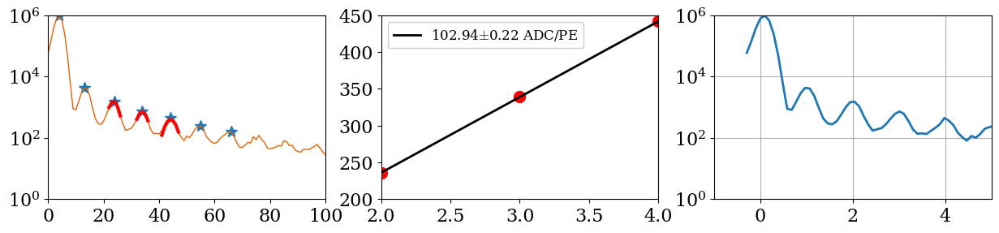

C:/Data/20221007/Step11\mca_keith_31.40OV_50.h5


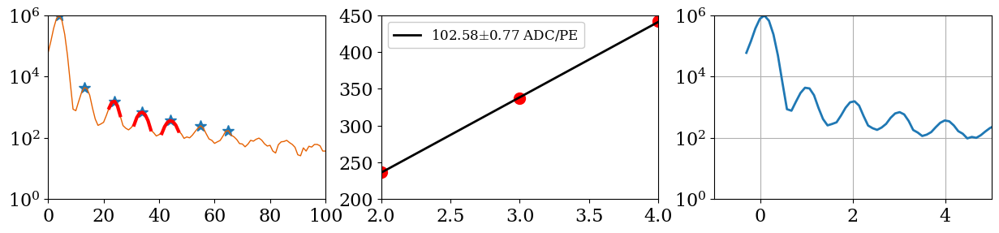

C:/Data/20221007/Step11\mca_keith_31.40OV_51.h5


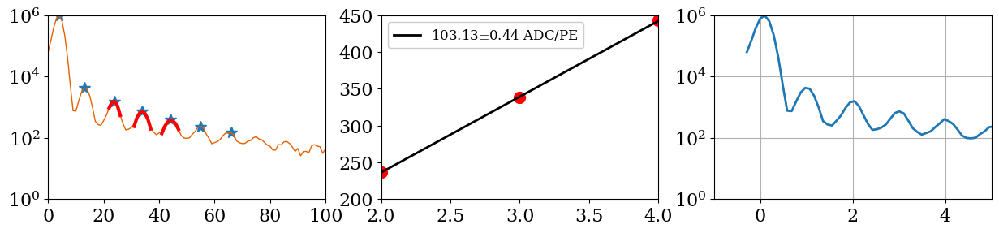

C:/Data/20221007/Step11\mca_keith_31.40OV_52.h5


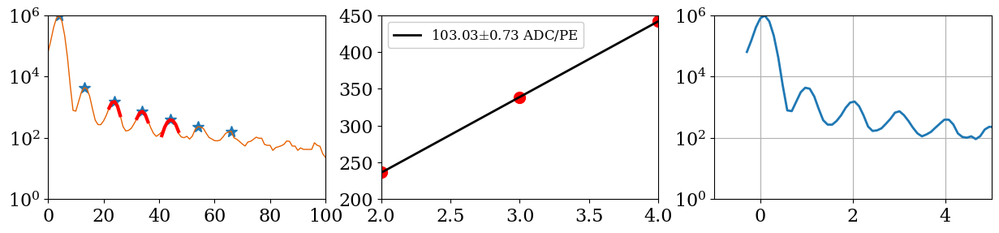

C:/Data/20221007/Step11\mca_keith_31.40OV_53.h5


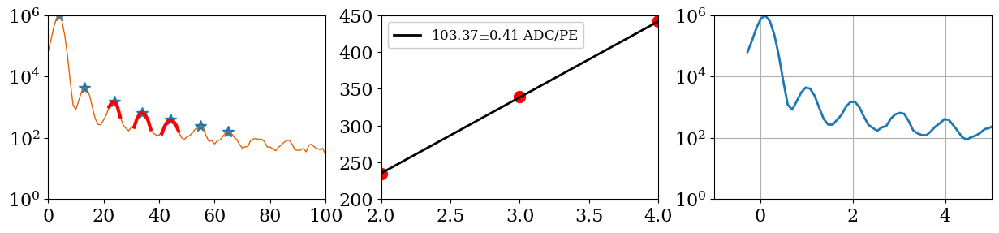

C:/Data/20221007/Step11\mca_keith_31.40OV_54.h5


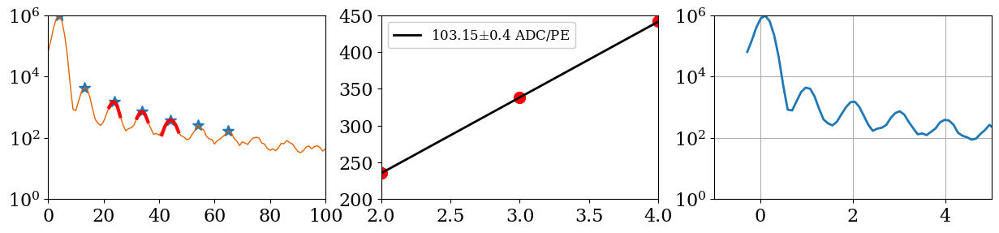

C:/Data/20221007/Step11\mca_keith_31.40OV_55.h5


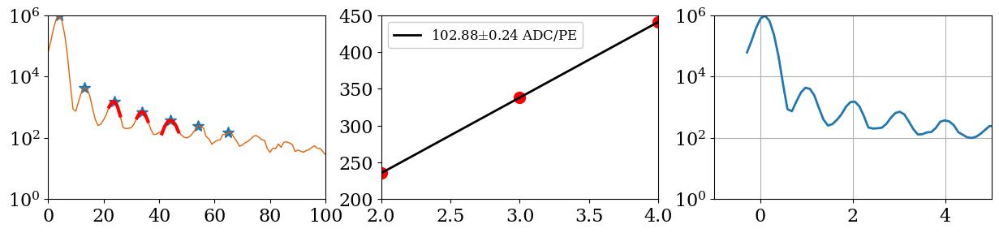

C:/Data/20221007/Step11\mca_keith_31.40OV_56.h5


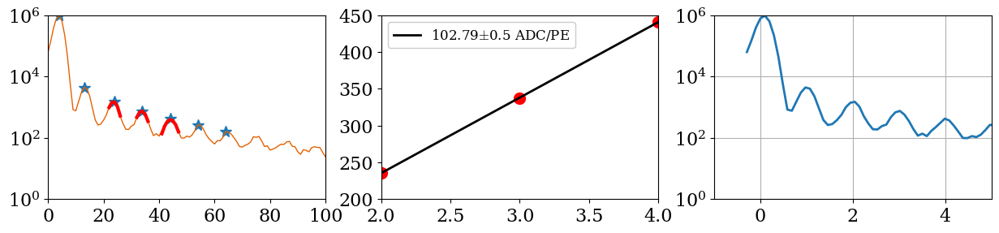

C:/Data/20221007/Step11\mca_keith_31.40OV_57.h5


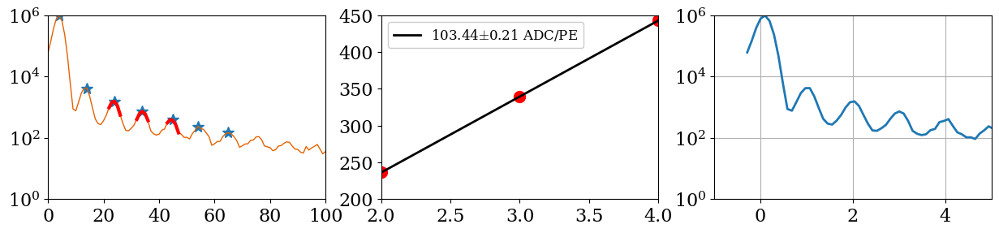

C:/Data/20221007/Step11\mca_keith_31.40OV_58.h5


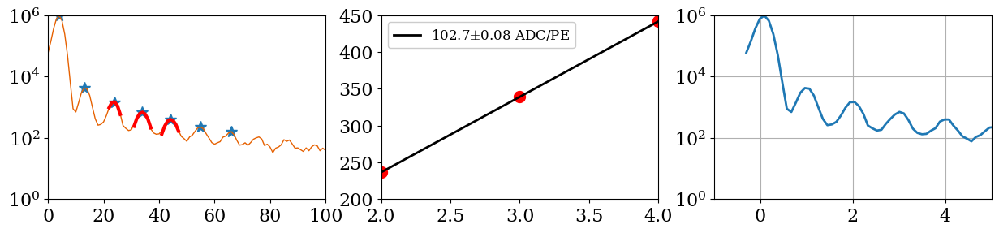

C:/Data/20221007/Step11\mca_keith_31.40OV_59.h5


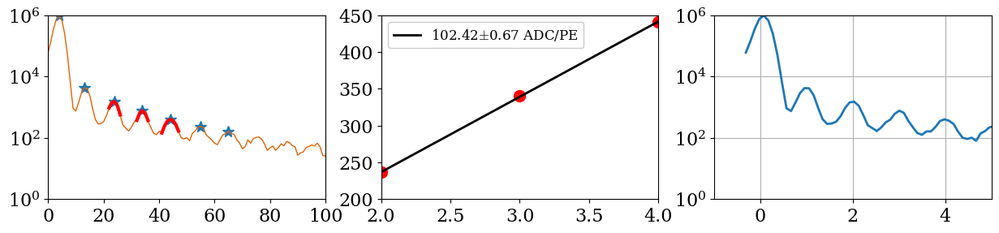

C:/Data/20221007/Step11\mca_keith_31.40OV_60.h5


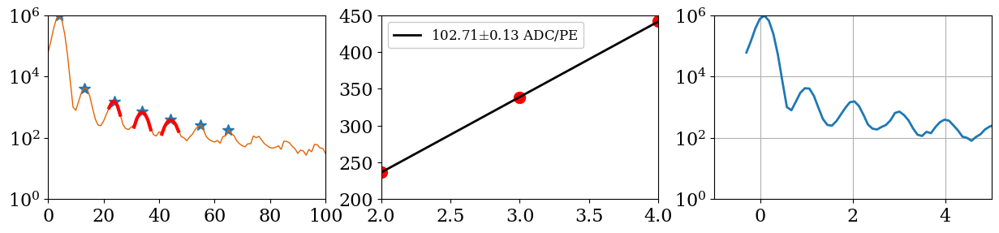

C:/Data/20221007/Step11\mca_keith_31.40OV_61.h5


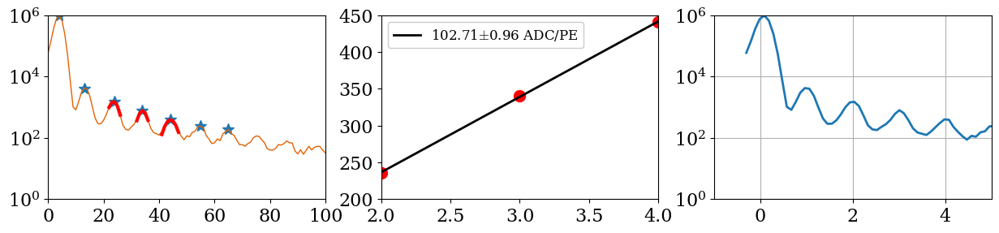

C:/Data/20221007/Step11\mca_keith_31.40OV_62.h5


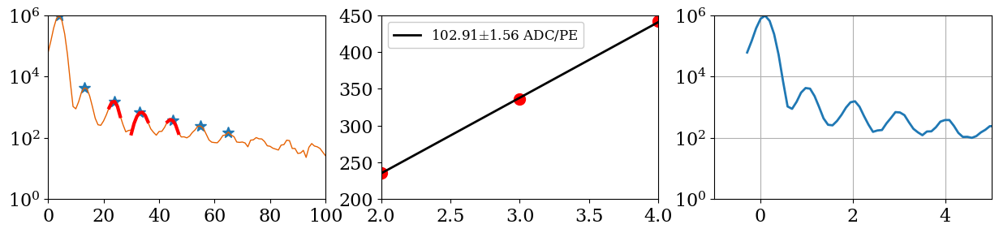

C:/Data/20221007/Step11\mca_keith_31.40OV_63.h5


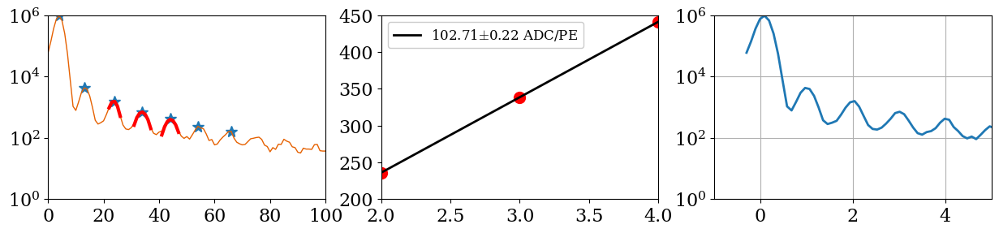

C:/Data/20221007/Step11\mca_keith_31.40OV_64.h5


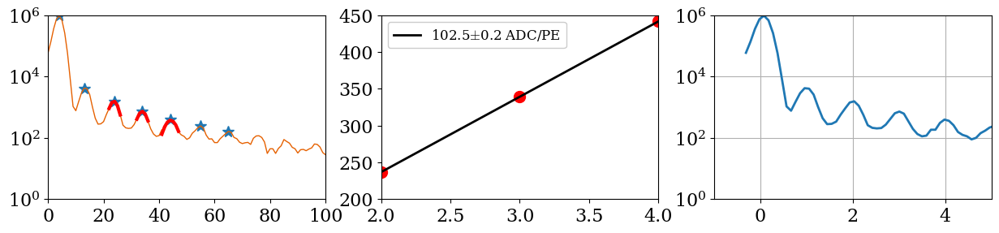

C:/Data/20221007/Step11\mca_keith_31.40OV_65.h5


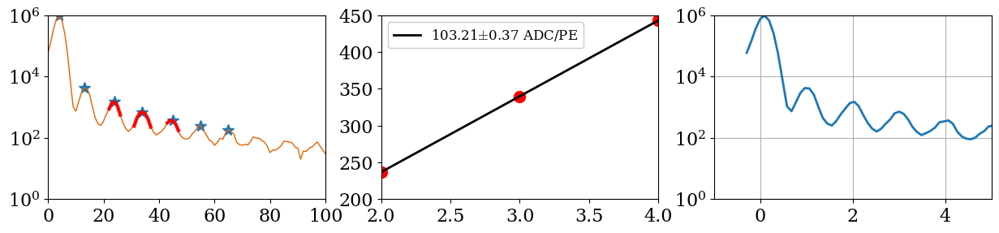

C:/Data/20221007/Step11\mca_keith_31.40OV_66.h5


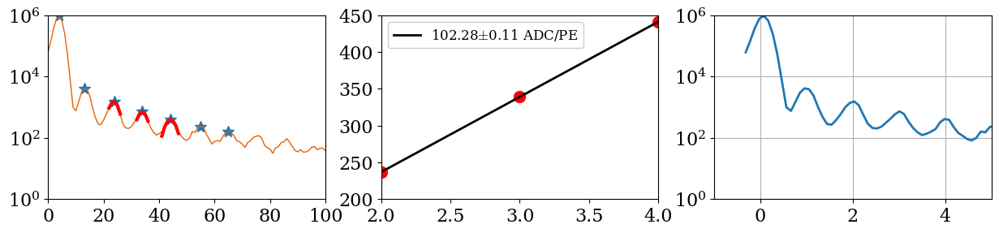

C:/Data/20221007/Step11\mca_keith_31.40OV_67.h5


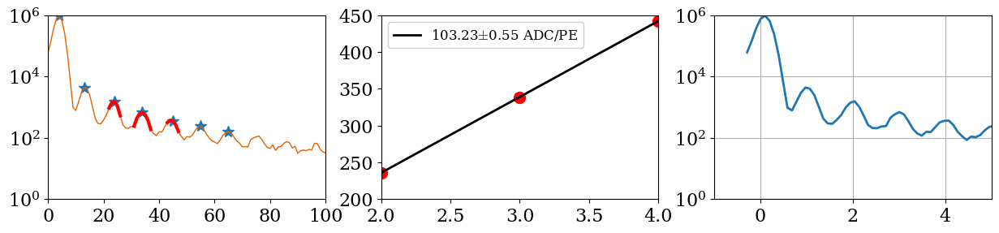

C:/Data/20221007/Step11\mca_keith_31.40OV_68.h5


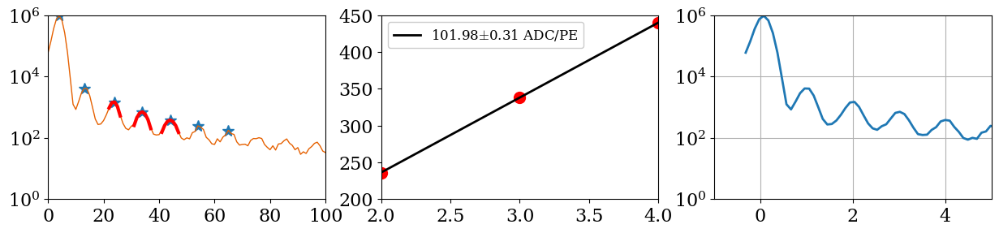

C:/Data/20221007/Step11\mca_keith_31.40OV_69.h5


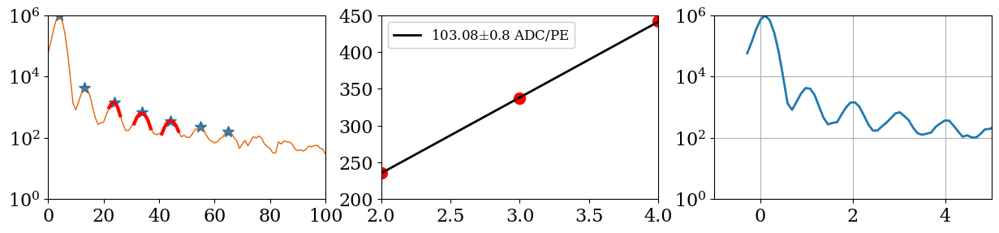

C:/Data/20221007/Step11\mca_keith_31.40OV_70.h5


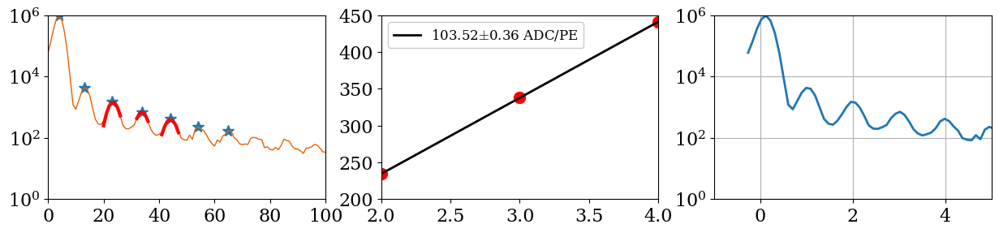

C:/Data/20221007/Step11\mca_keith_31.40OV_71.h5


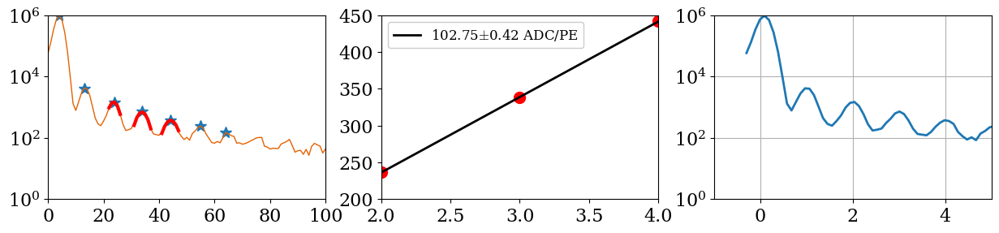

C:/Data/20221007/Step11\mca_keith_31.40OV_72.h5


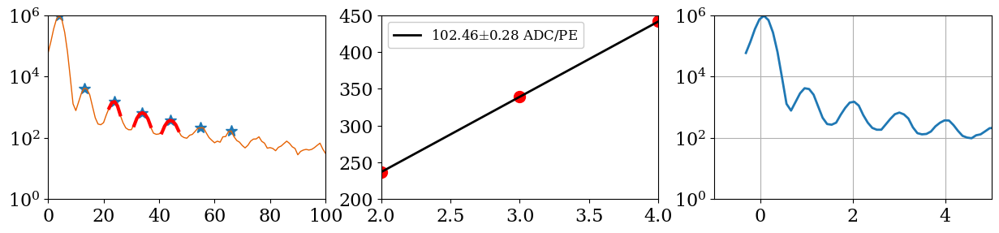

C:/Data/20221007/Step11\mca_keith_31.40OV_73.h5


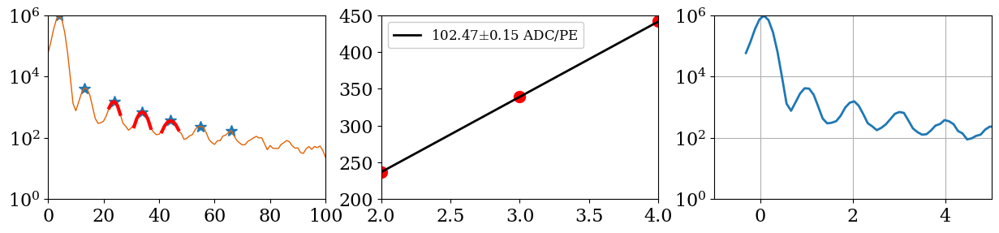

C:/Data/20221007/Step11\mca_keith_31.40OV_74.h5


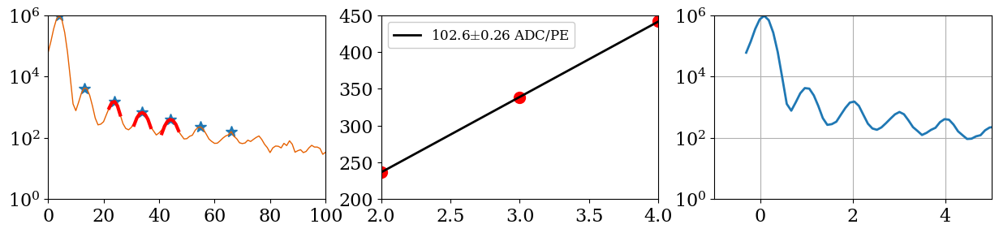

C:/Data/20221007/Step11\mca_keith_31.40OV_75.h5


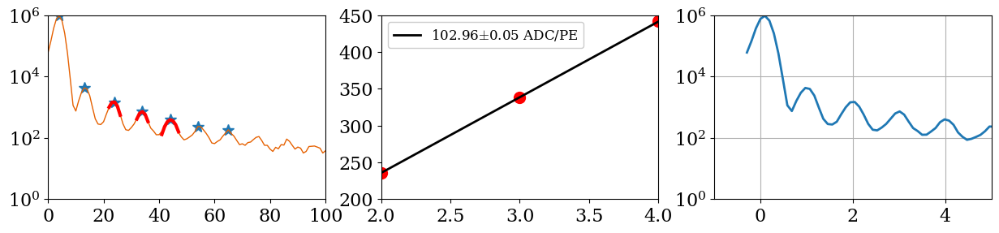

C:/Data/20221007/Step11\mca_keith_31.40OV_76.h5


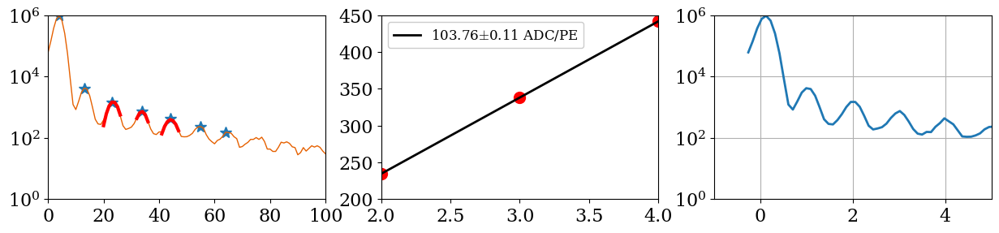

C:/Data/20221007/Step11\mca_keith_31.40OV_77.h5


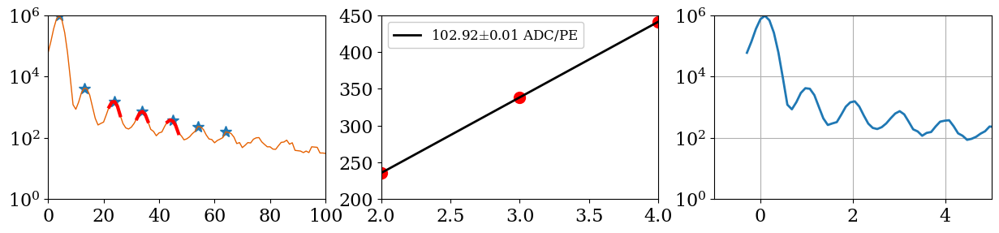

C:/Data/20221007/Step11\mca_keith_31.40OV_78.h5


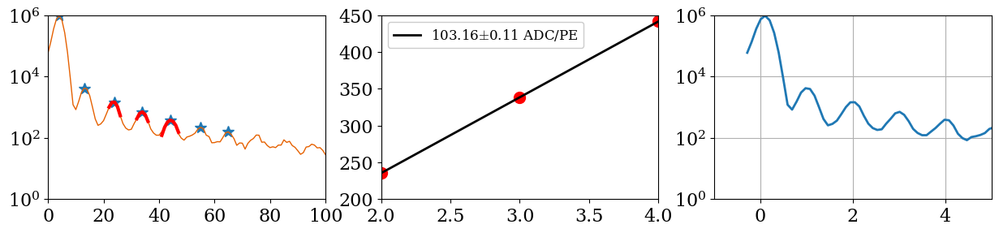

C:/Data/20221007/Step11\mca_keith_31.40OV_79.h5


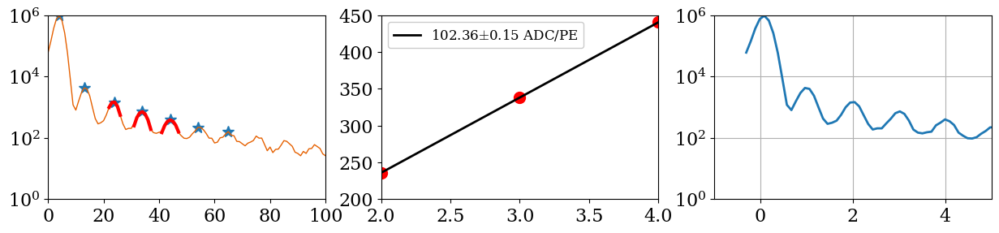

C:/Data/20221007/Step11\mca_keith_31.40OV_80.h5


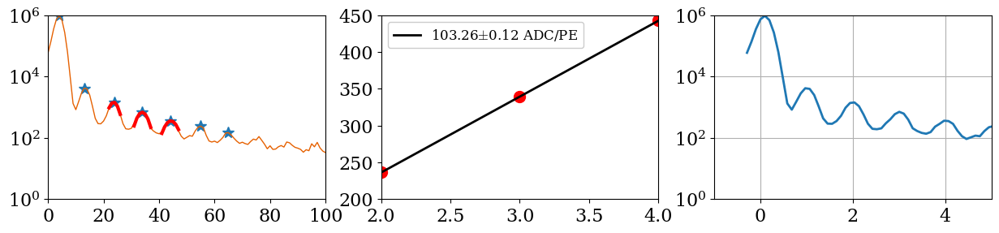

C:/Data/20221007/Step11\mca_keith_31.40OV_81.h5


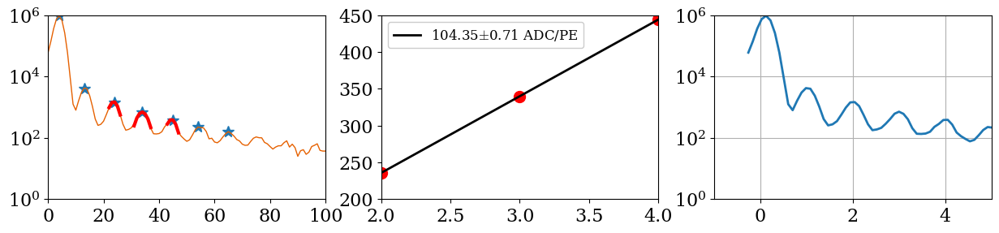

C:/Data/20221007/Step11\mca_keith_31.40OV_82.h5


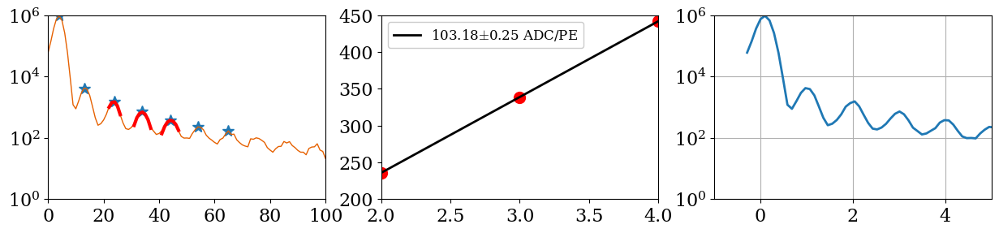

C:/Data/20221007/Step11\mca_keith_31.40OV_83.h5


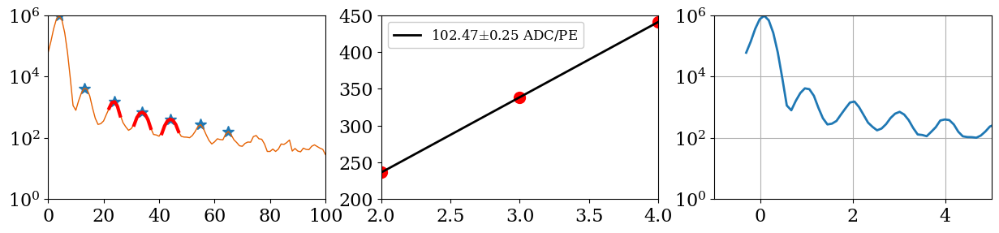

C:/Data/20221007/Step11\mca_keith_31.40OV_84.h5


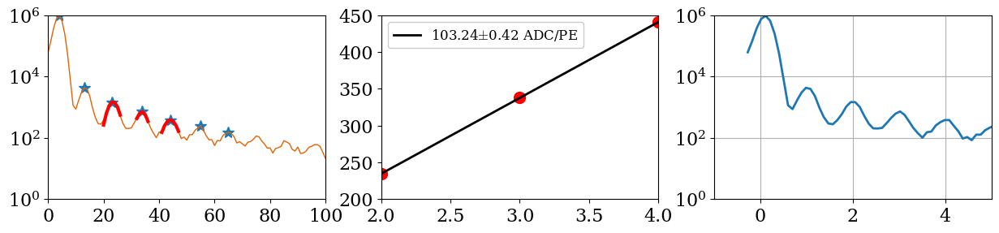

C:/Data/20221007/Step11\mca_keith_31.40OV_85.h5


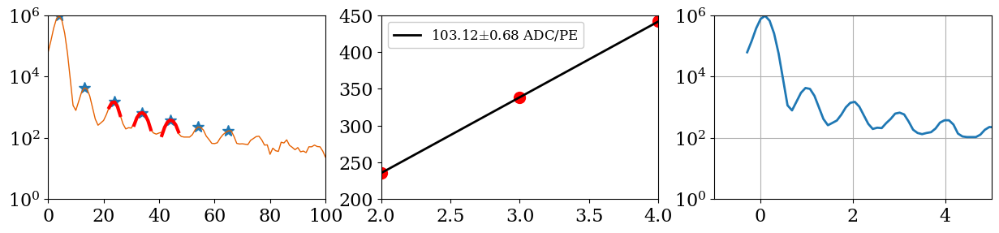

C:/Data/20221007/Step11\mca_keith_31.40OV_86.h5


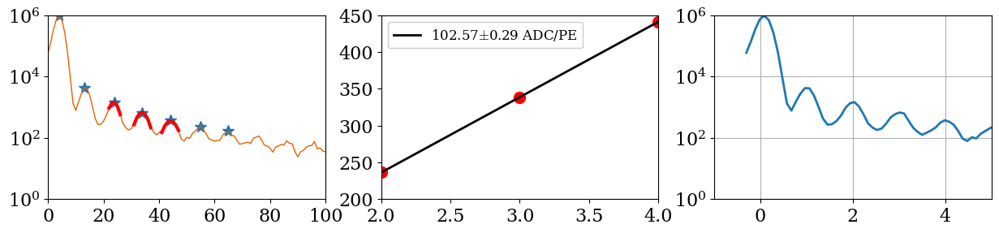

C:/Data/20221007/Step11\mca_keith_31.40OV_87.h5


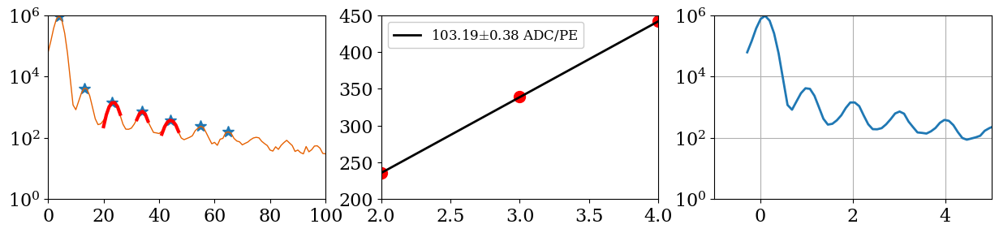

C:/Data/20221007/Step11\mca_keith_31.40OV_88.h5


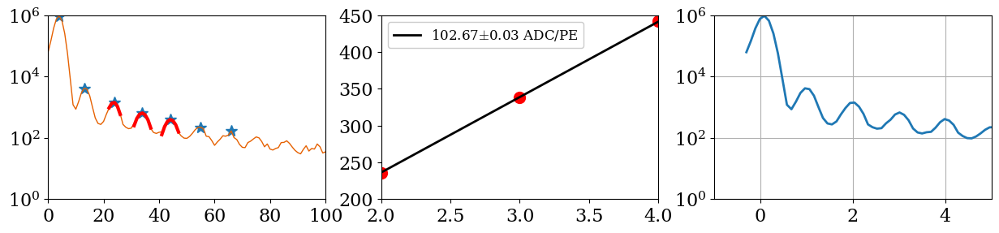

C:/Data/20221007/Step11\mca_keith_31.40OV_89.h5


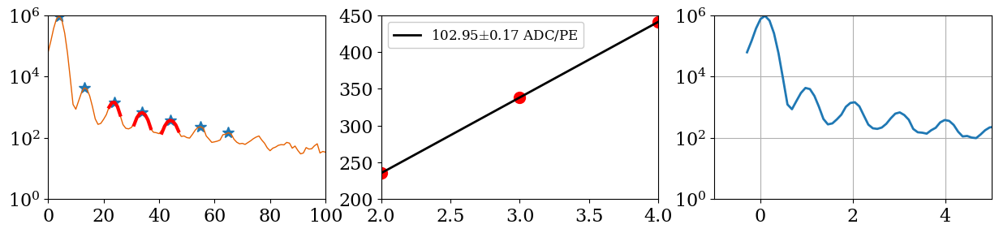

C:/Data/20221007/Step11\mca_keith_31.40OV_90.h5


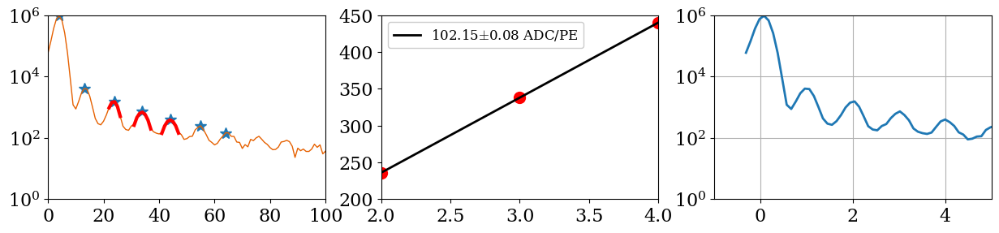

C:/Data/20221007/Step11\mca_keith_31.40OV_91.h5


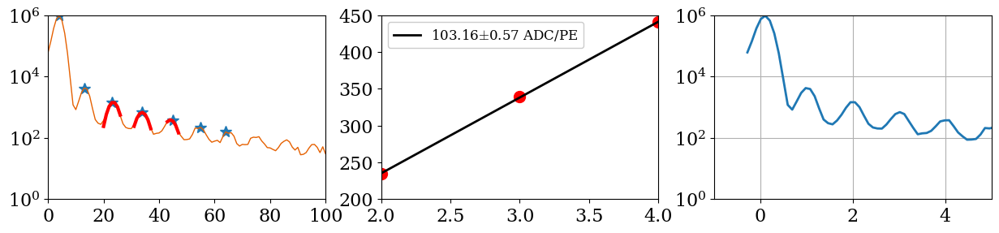

C:/Data/20221007/Step11\mca_keith_31.40OV_92.h5


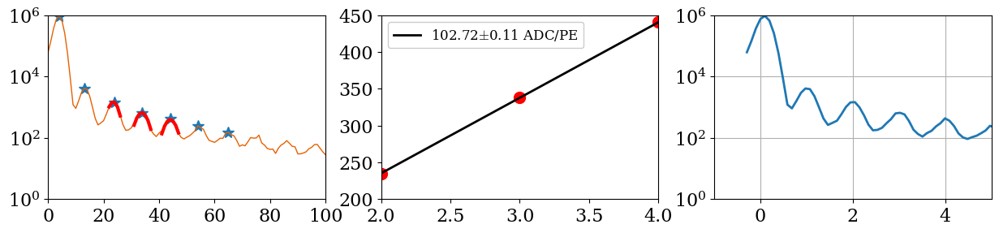

C:/Data/20221007/Step11\mca_keith_31.40OV_93.h5


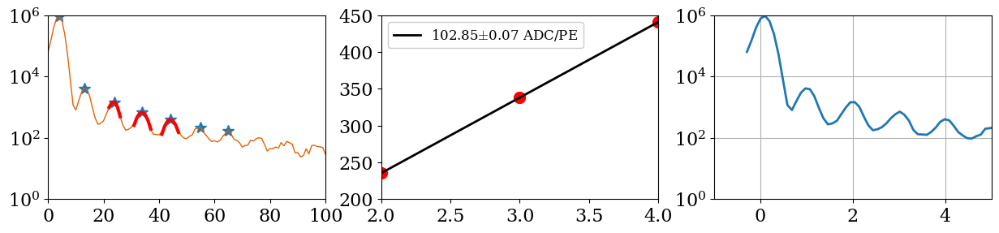

C:/Data/20221007/Step11\mca_keith_31.40OV_94.h5


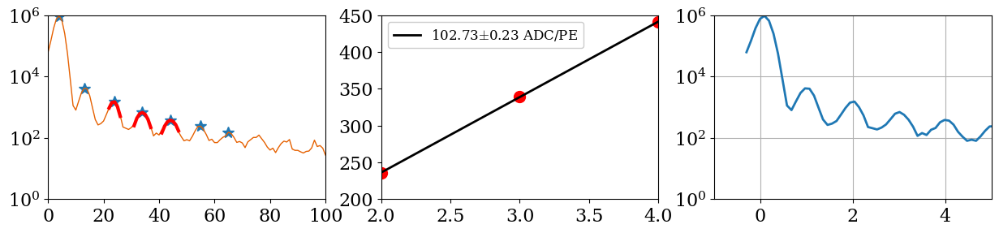

C:/Data/20221007/Step11\mca_keith_31.40OV_95.h5


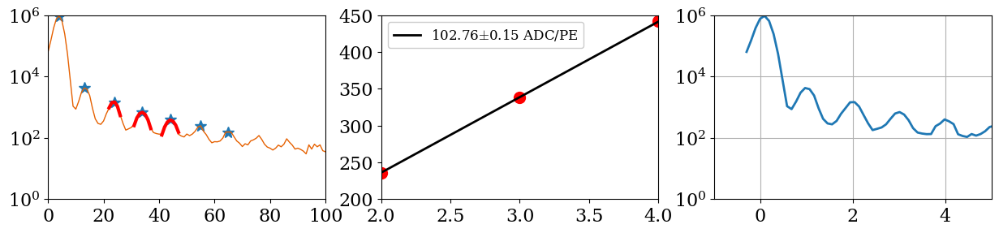

C:/Data/20221007/Step11\mca_keith_31.40OV_96.h5


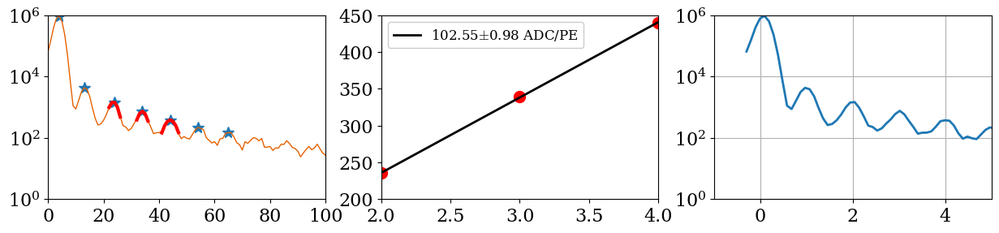

C:/Data/20221007/Step11\mca_keith_31.40OV_97.h5


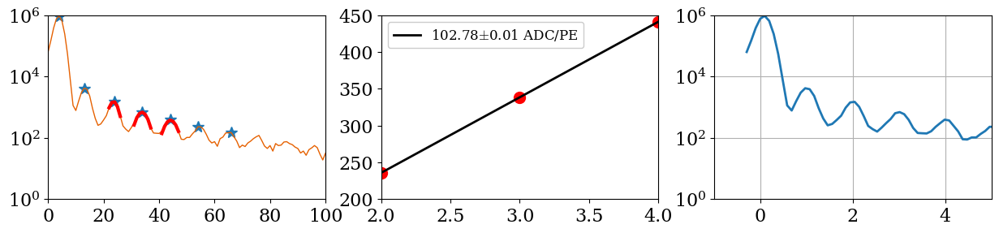

C:/Data/20221007/Step11\mca_keith_31.40OV_98.h5


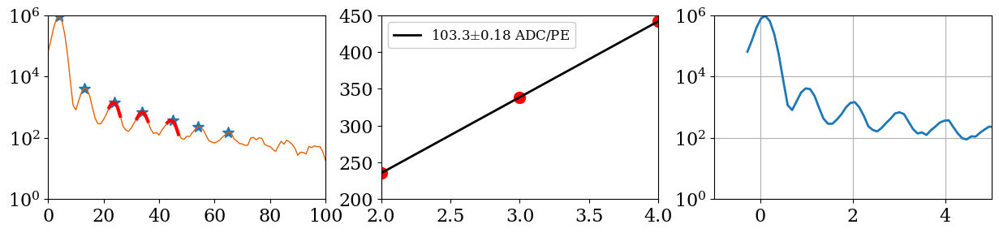

C:/Data/20221007/Step11\mca_keith_31.40OV_99.h5


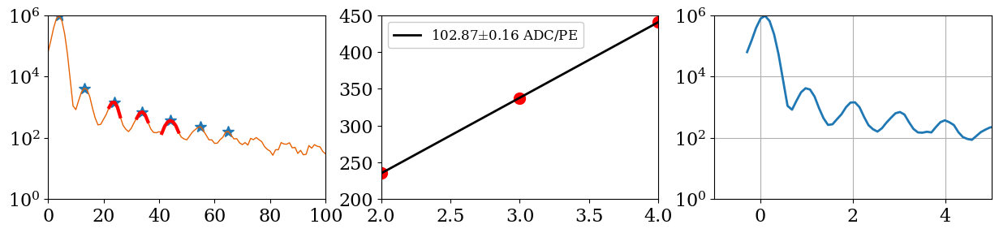

C:/Data/20221007/Step11\mca_keith_31.40OV_100.h5


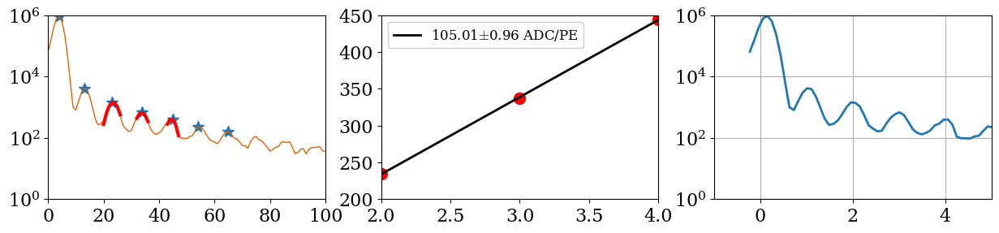

C:/Data/20221007/Step11\mca_keith_31.40OV_101.h5


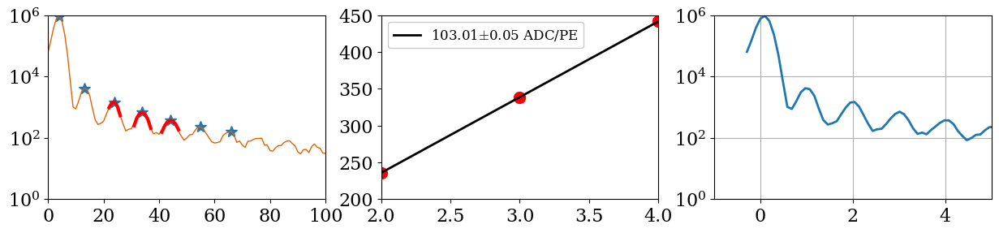

C:/Data/20221007/Step11\mca_keith_31.40OV_102.h5


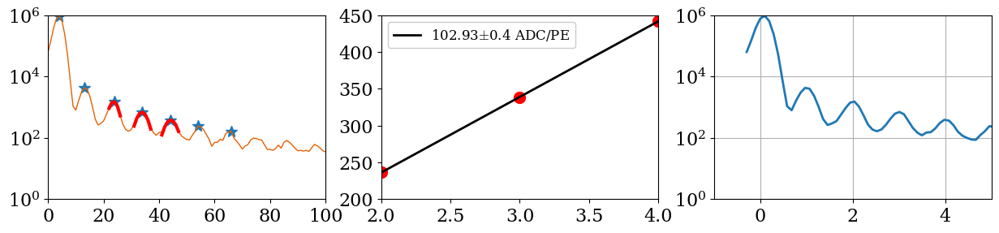

C:/Data/20221007/Step11\mca_keith_31.40OV_103.h5


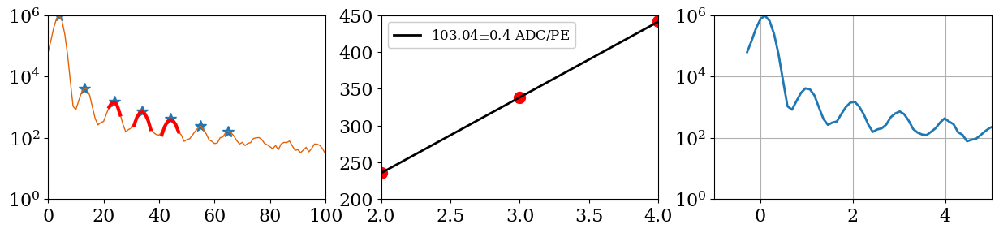

C:/Data/20221007/Step11\mca_keith_31.40OV_104.h5


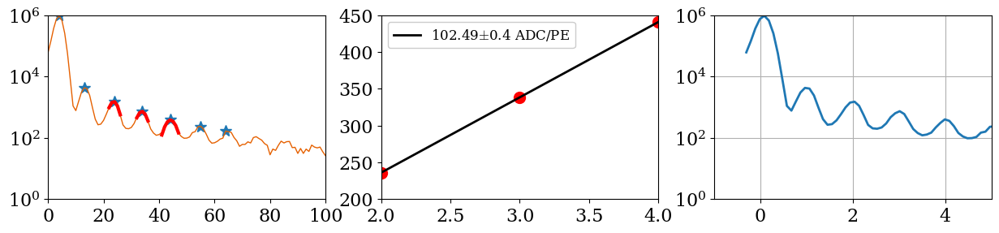

C:/Data/20221007/Step11\mca_keith_31.40OV_105.h5


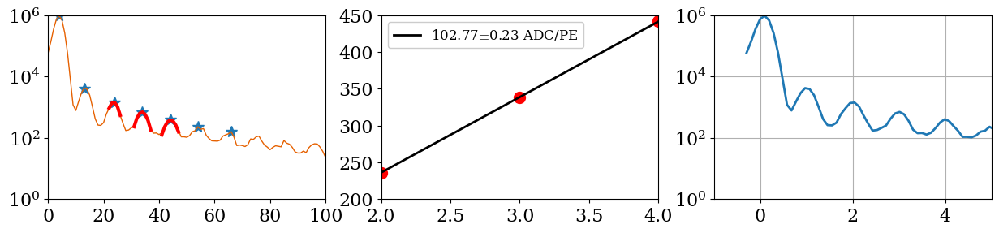

C:/Data/20221007/Step11\mca_keith_31.40OV_106.h5


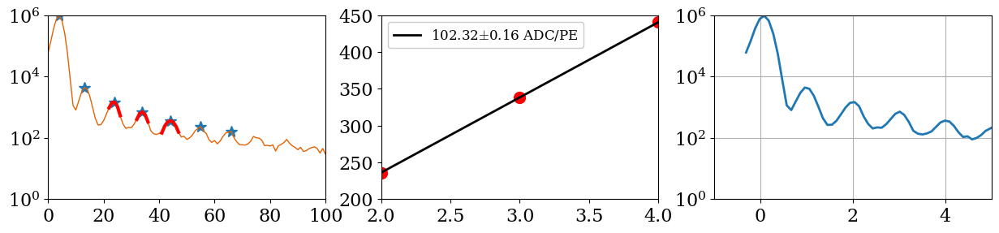

C:/Data/20221007/Step11\mca_keith_31.40OV_107.h5


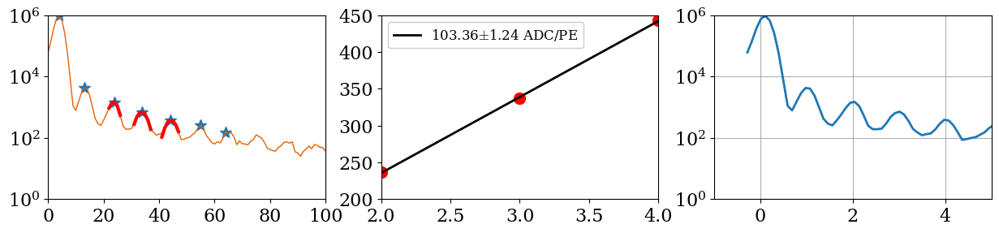

C:/Data/20221007/Step11\mca_keith_31.40OV_108.h5


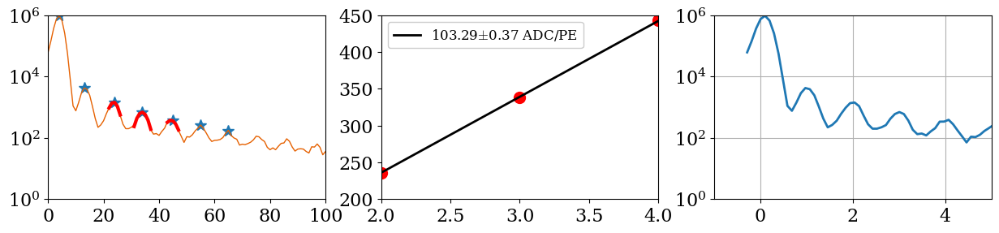

C:/Data/20221007/Step11\mca_keith_31.40OV_109.h5


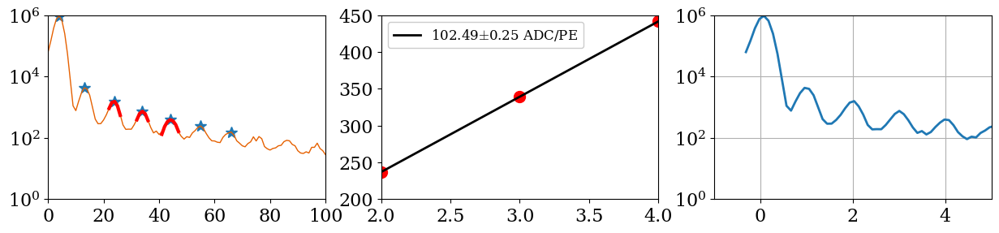

C:/Data/20221007/Step11\mca_keith_31.40OV_110.h5


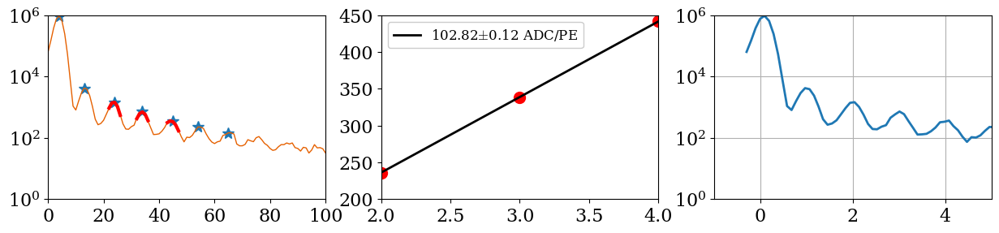

C:/Data/20221007/Step11\mca_keith_31.40OV_111.h5


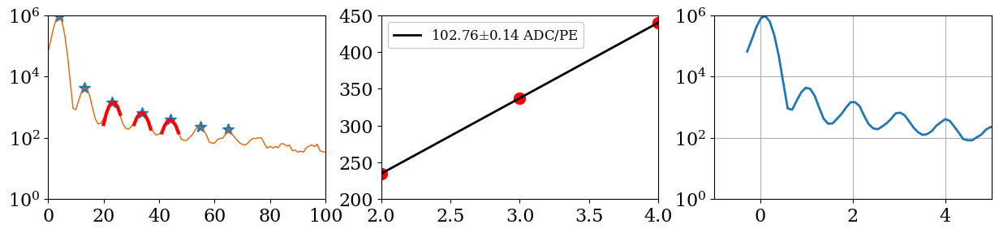

C:/Data/20221007/Step11\mca_keith_31.40OV_112.h5


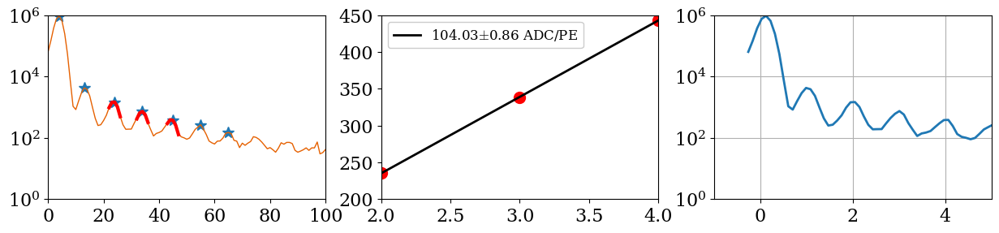

C:/Data/20221007/Step11\mca_keith_31.40OV_113.h5


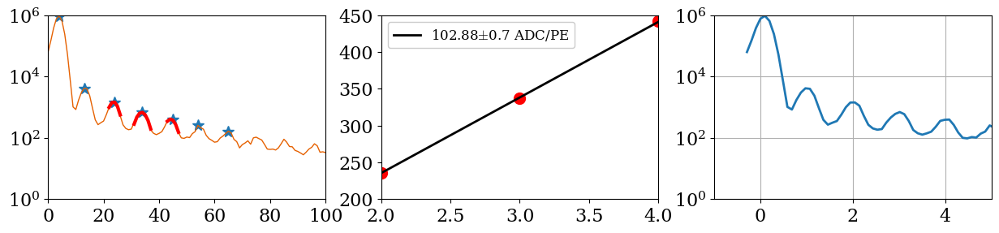

C:/Data/20221007/Step11\mca_keith_31.40OV_114.h5


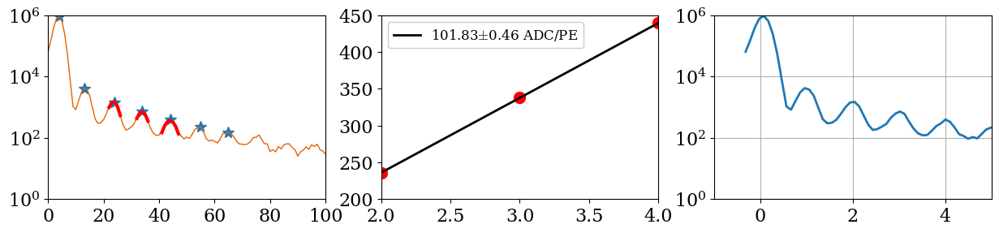

C:/Data/20221007/Step11\mca_keith_31.40OV_115.h5


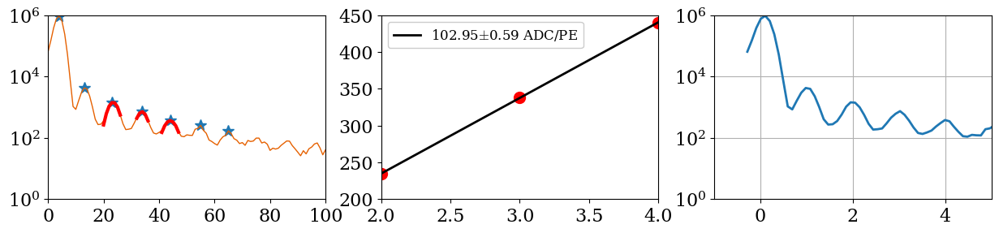

C:/Data/20221007/Step11\mca_keith_31.40OV_116.h5


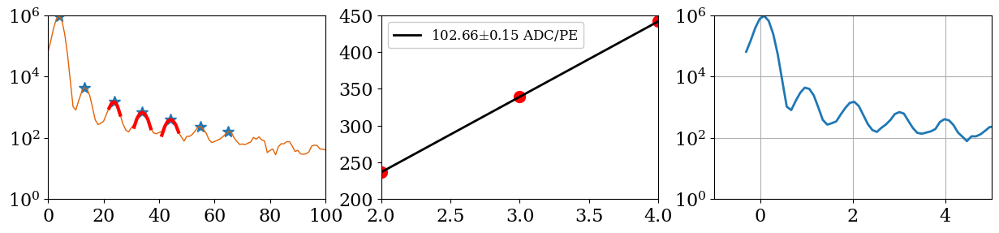

C:/Data/20221007/Step11\mca_keith_31.40OV_117.h5


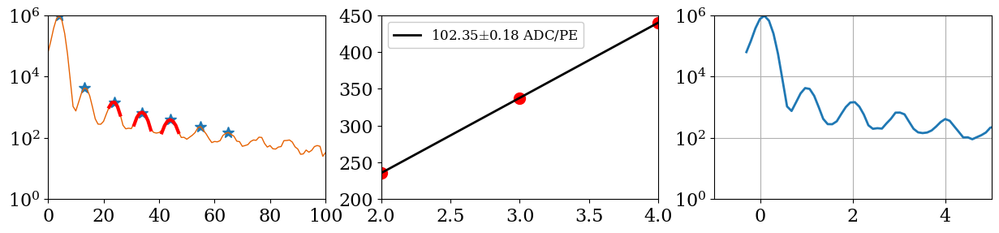

C:/Data/20221007/Step11\mca_keith_31.40OV_118.h5


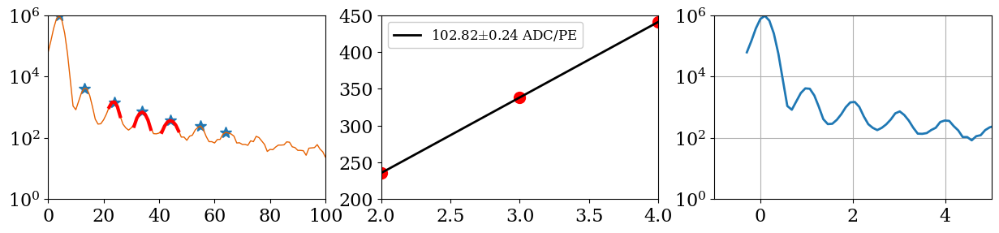

C:/Data/20221007/Step11\mca_keith_31.40OV_119.h5


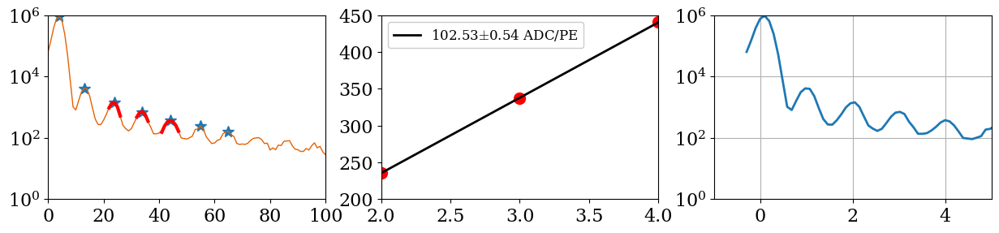

C:/Data/20221007/Step11\mca_keith_31.40OV_120.h5


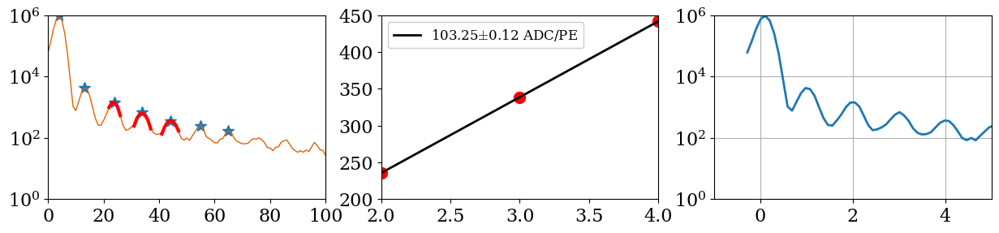

C:/Data/20221007/Step11\mca_keith_31.40OV_121.h5


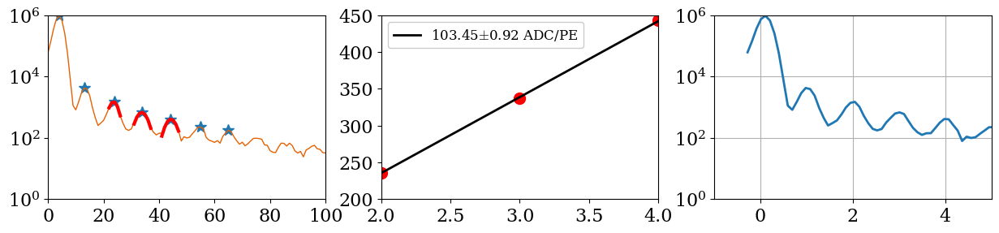

C:/Data/20221007/Step11\mca_keith_31.40OV_122.h5


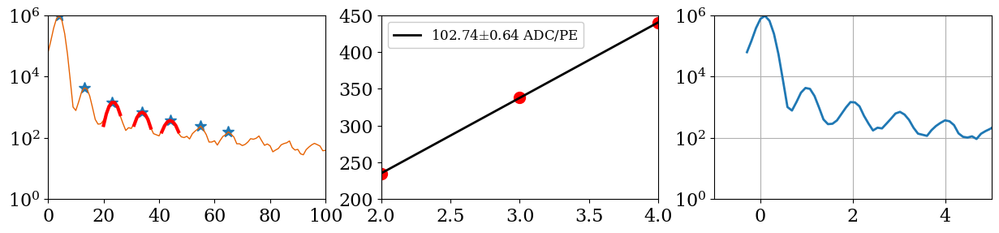

C:/Data/20221007/Step11\mca_keith_31.40OV_123.h5


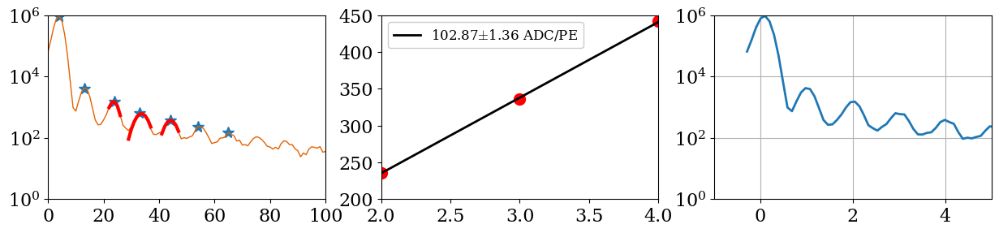

C:/Data/20221007/Step11\mca_keith_31.40OV_124.h5


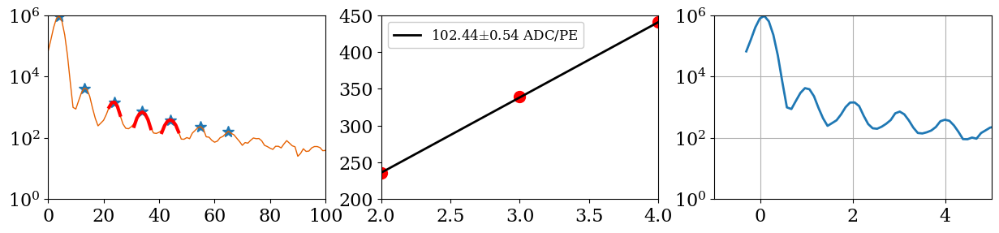

C:/Data/20221007/Step11\mca_keith_31.40OV_125.h5


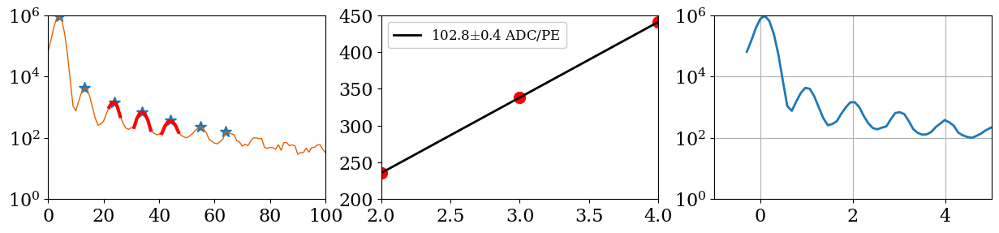

C:/Data/20221007/Step11\mca_keith_31.40OV_126.h5


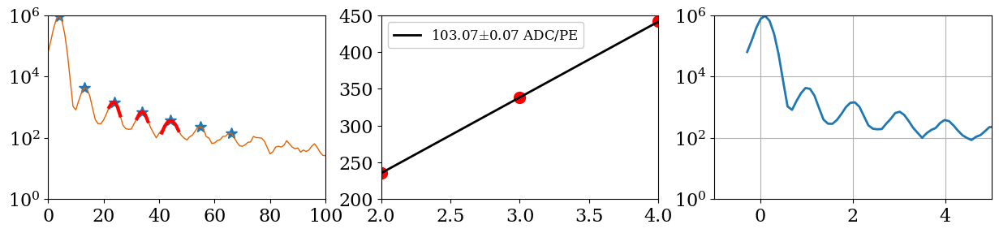

C:/Data/20221007/Step11\mca_keith_31.40OV_127.h5


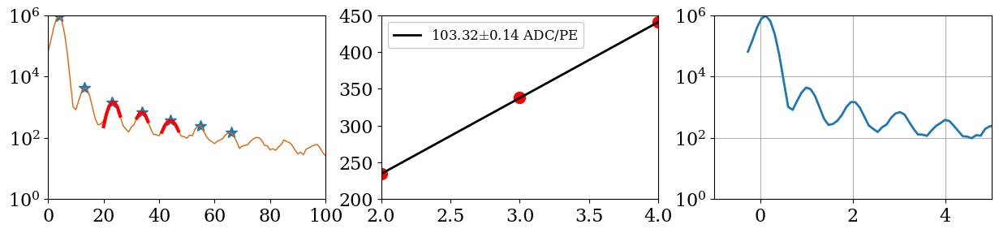

C:/Data/20221007/Step11\mca_keith_31.40OV_128.h5


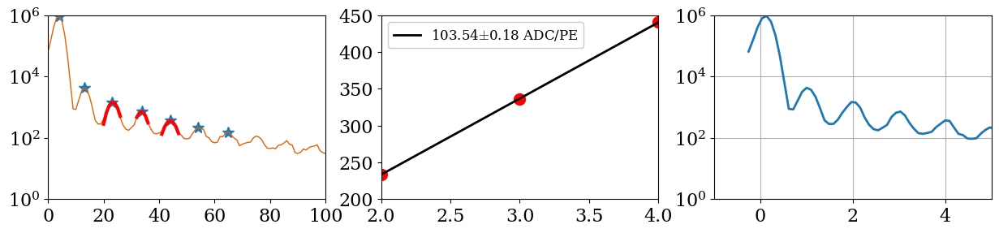

C:/Data/20221007/Step11\mca_keith_31.40OV_129.h5


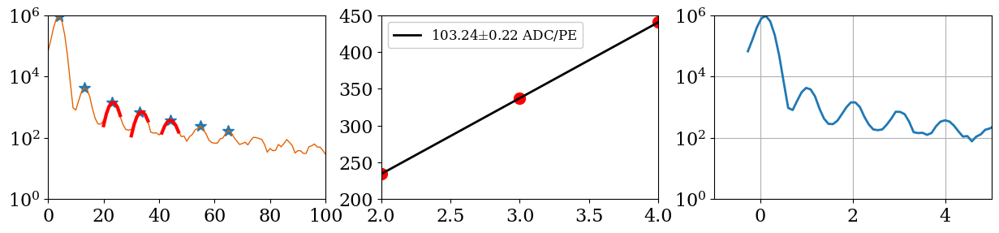

C:/Data/20221007/Step11\mca_keith_31.40OV_130.h5


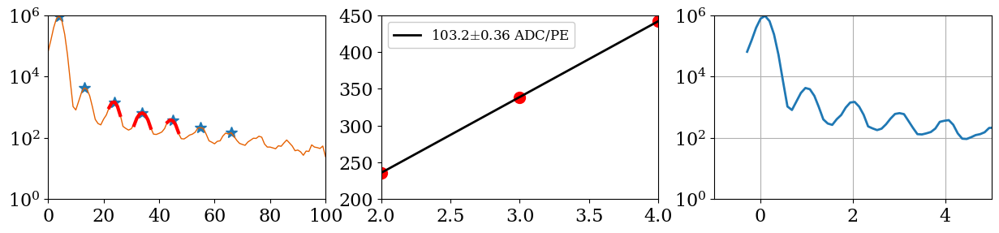

C:/Data/20221007/Step11\mca_keith_31.40OV_131.h5


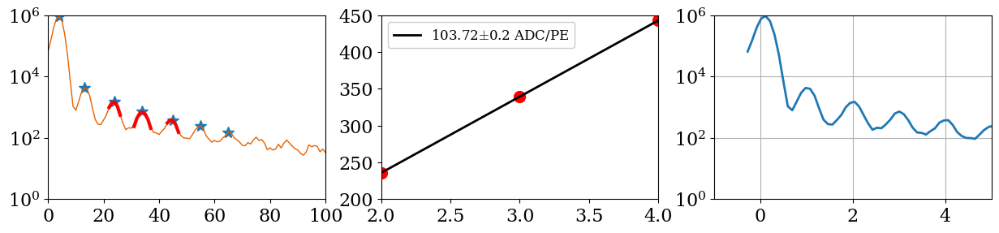

C:/Data/20221007/Step11\mca_keith_31.40OV_132.h5


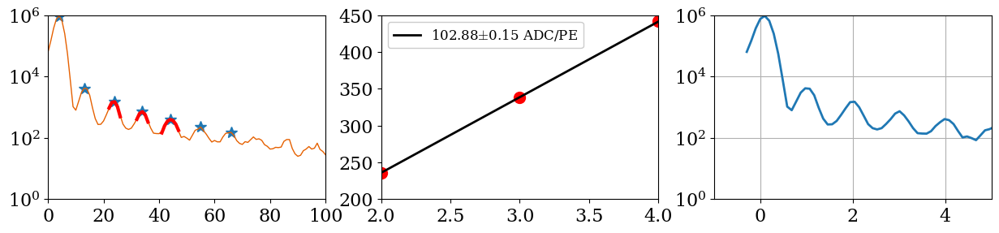

C:/Data/20221007/Step11\mca_keith_31.40OV_133.h5


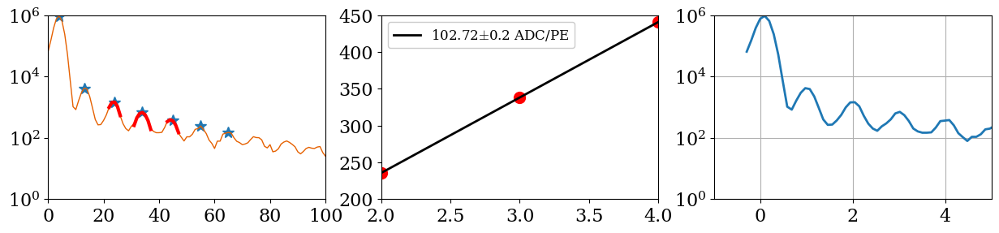

C:/Data/20221007/Step11\mca_keith_31.40OV_134.h5


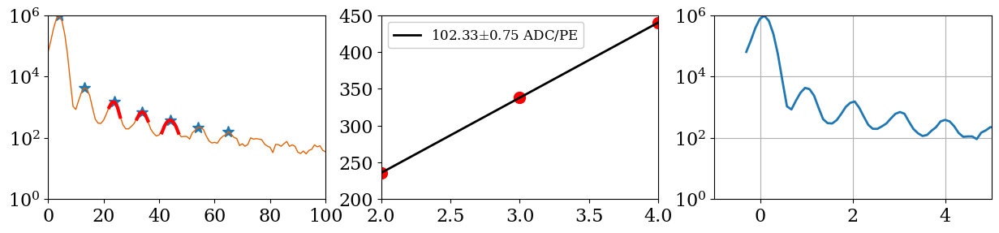

C:/Data/20221007/Step11\mca_keith_31.40OV_135.h5


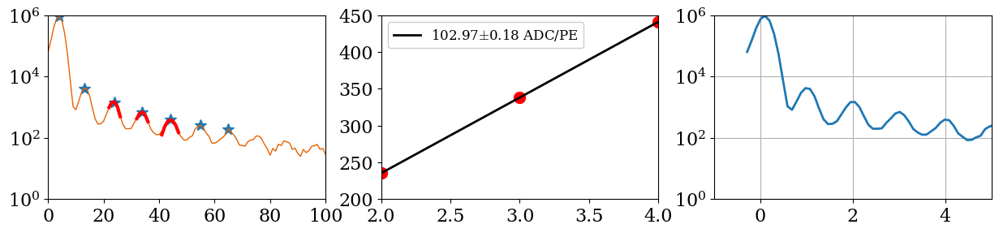

C:/Data/20221007/Step11\mca_keith_31.40OV_136.h5


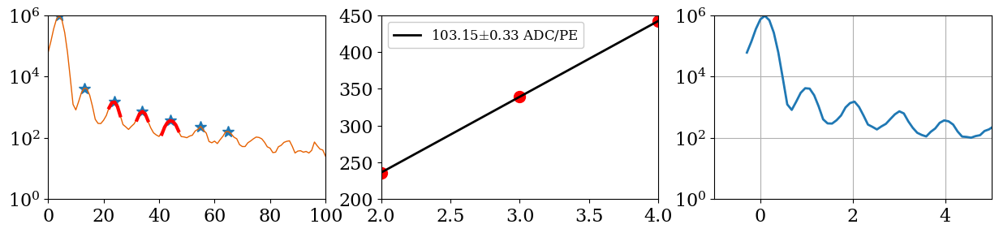

C:/Data/20221007/Step11\mca_keith_31.40OV_137.h5


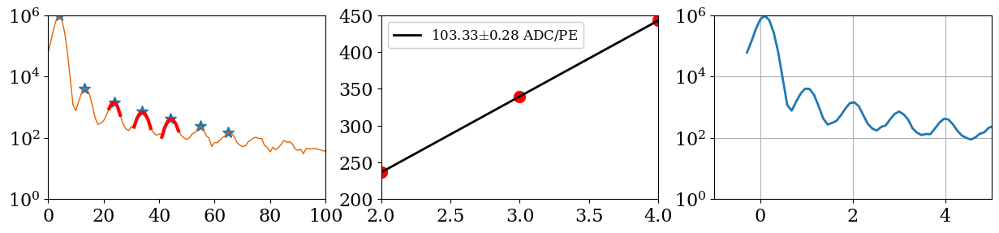

C:/Data/20221007/Step11\mca_keith_31.40OV_138.h5


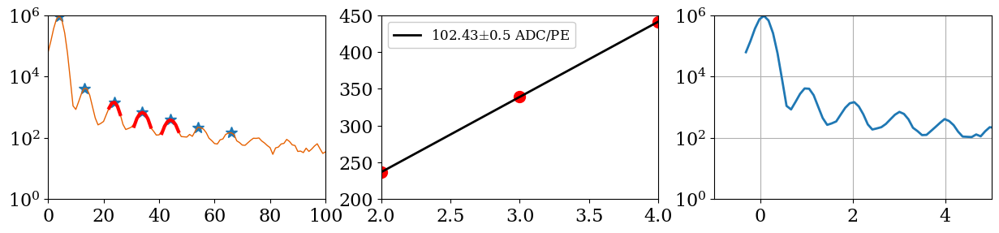

C:/Data/20221007/Step11\mca_keith_31.40OV_139.h5


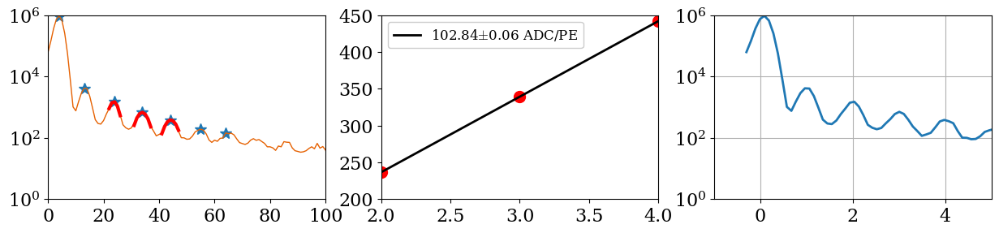

C:/Data/20221007/Step11\mca_keith_31.40OV_140.h5


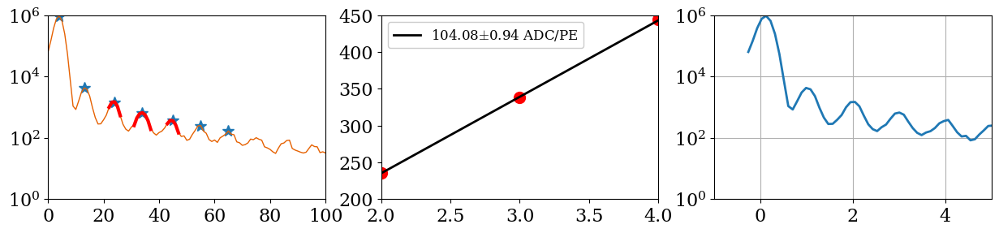

C:/Data/20221007/Step11\mca_keith_31.40OV_141.h5


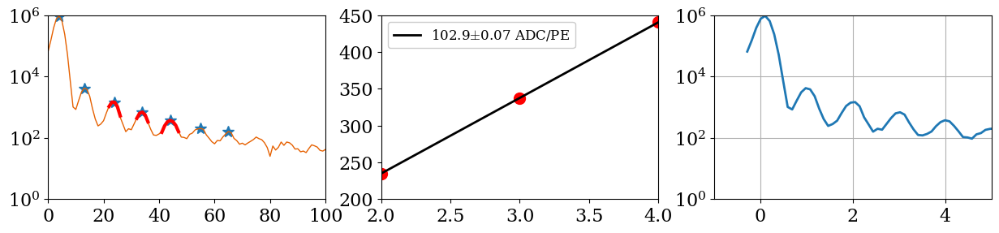

C:/Data/20221007/Step11\mca_keith_31.40OV_142.h5


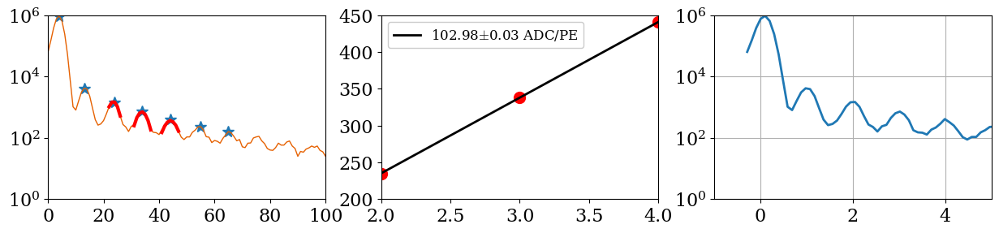

C:/Data/20221007/Step11\mca_keith_31.40OV_143.h5


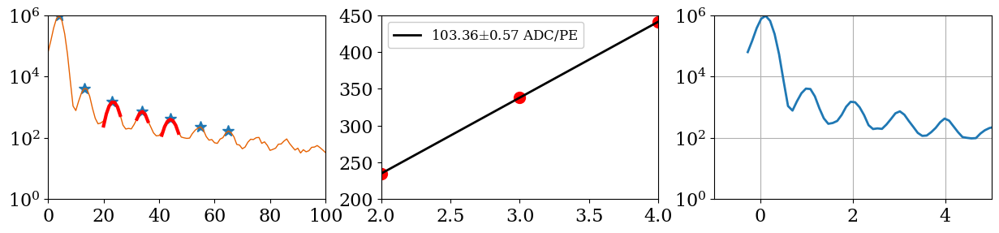

C:/Data/20221007/Step11\mca_keith_31.40OV_144.h5


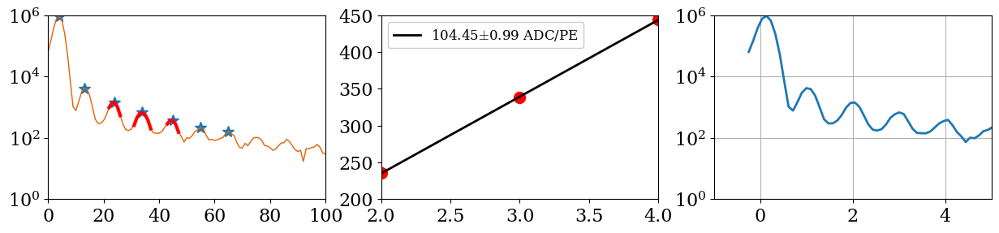

C:/Data/20221007/Step11\mca_keith_31.40OV_145.h5


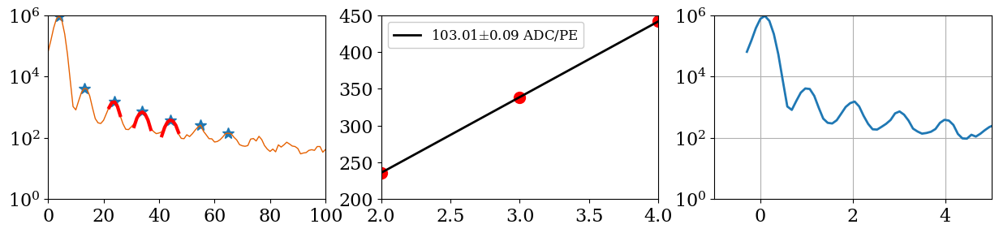

C:/Data/20221007/Step11\mca_keith_31.40OV_146.h5


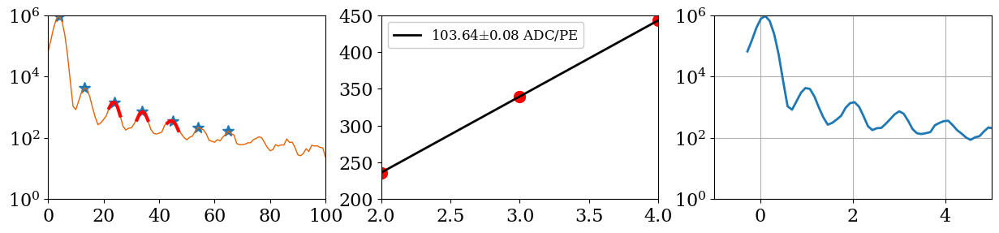

C:/Data/20221007/Step11\mca_keith_31.40OV_147.h5


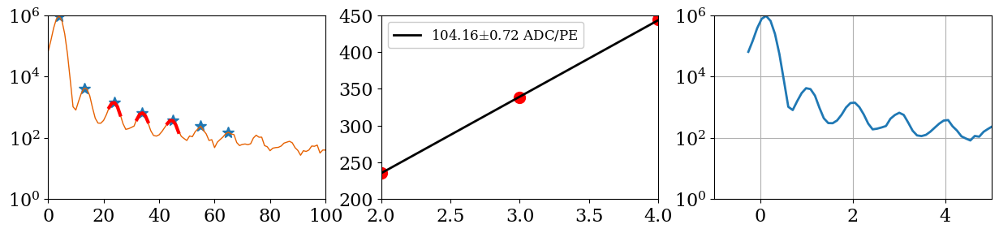

C:/Data/20221007/Step11\mca_keith_31.40OV_148.h5


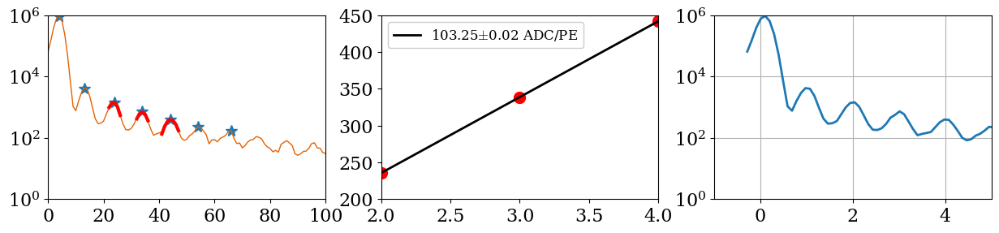

C:/Data/20221007/Step11\mca_keith_31.40OV_149.h5


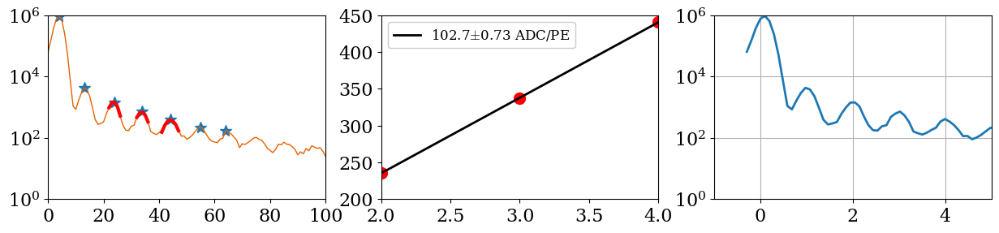

C:/Data/20221007/Step11\mca_keith_31.40OV_150.h5


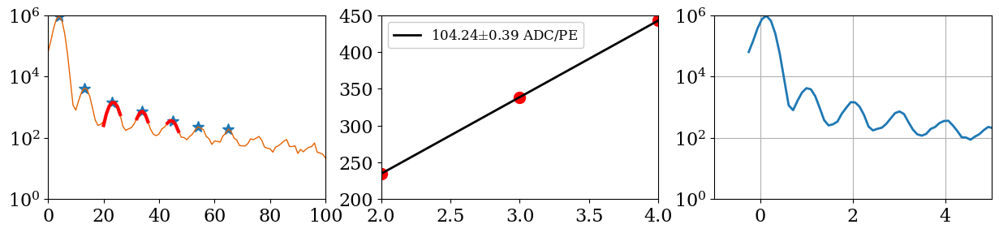

C:/Data/20221007/Step11\mca_keith_31.40OV_151.h5


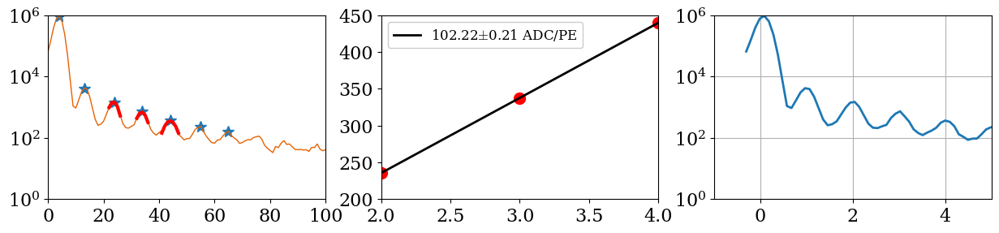

C:/Data/20221007/Step11\mca_keith_31.40OV_152.h5


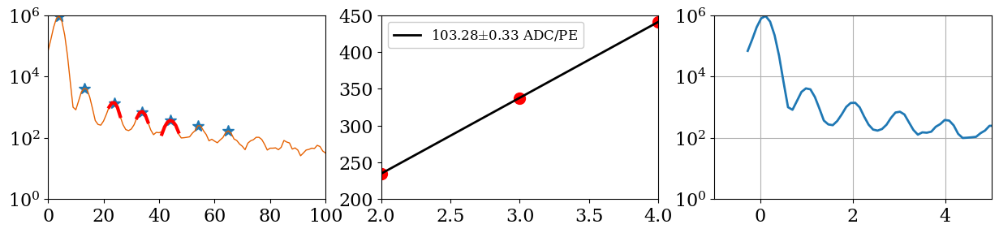

C:/Data/20221007/Step11\mca_keith_31.40OV_153.h5


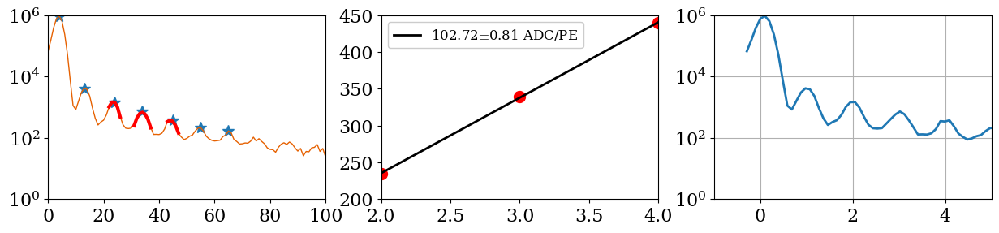

C:/Data/20221007/Step11\mca_keith_31.40OV_154.h5


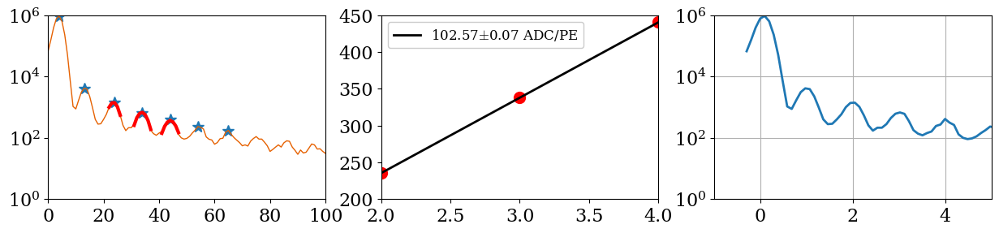

C:/Data/20221007/Step11\mca_keith_31.40OV_155.h5


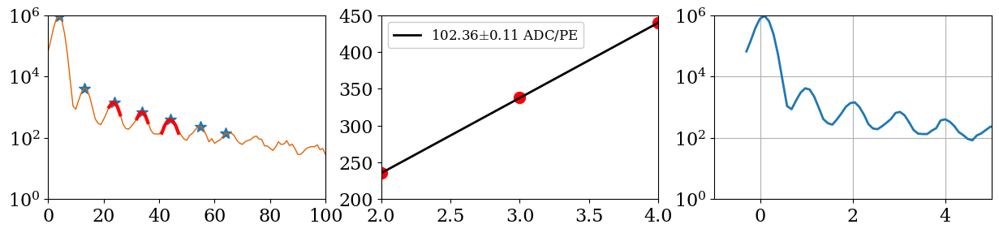

C:/Data/20221007/Step11\mca_keith_31.40OV_156.h5


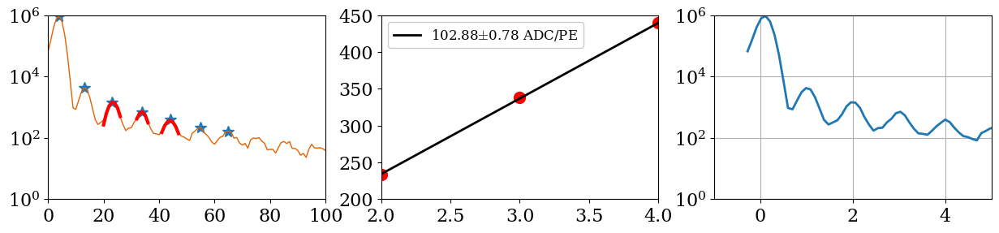

In [67]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step11_gain_list,Step11_gain_err,Step11_calib_pe,Step11_calib_count=gain_calculator(Step11,10,6,1,2,-2)
Voltages_Step11=Voltages(Step11)

C:/Data/20221007/Step12\mca_keith_29.90OV_0.h5


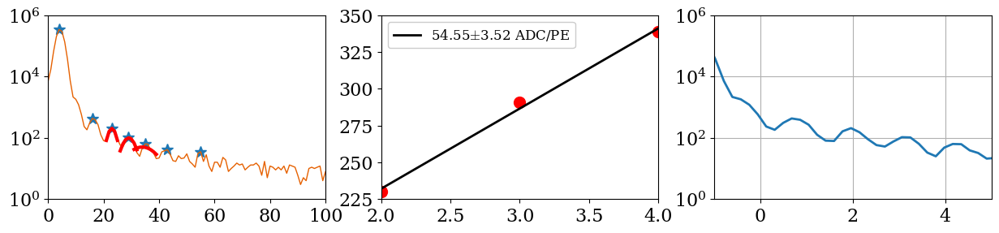

C:/Data/20221007/Step12\mca_keith_30.40OV_0.h5


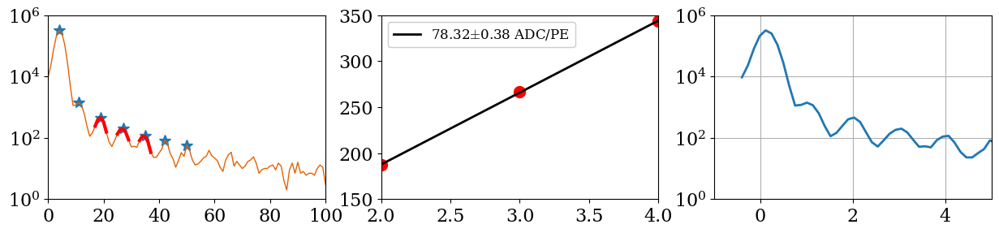

C:/Data/20221007/Step12\mca_keith_30.90OV_0.h5


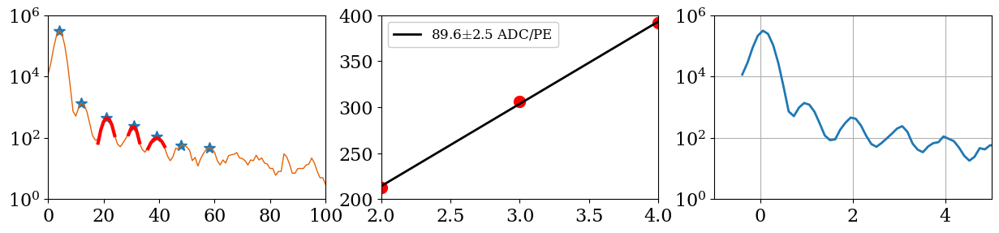

C:/Data/20221007/Step12\mca_keith_31.40OV_0.h5


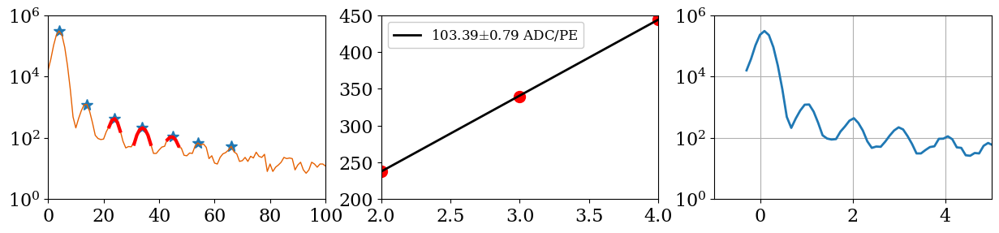

C:/Data/20221007/Step12\mca_keith_31.90OV_0.h5


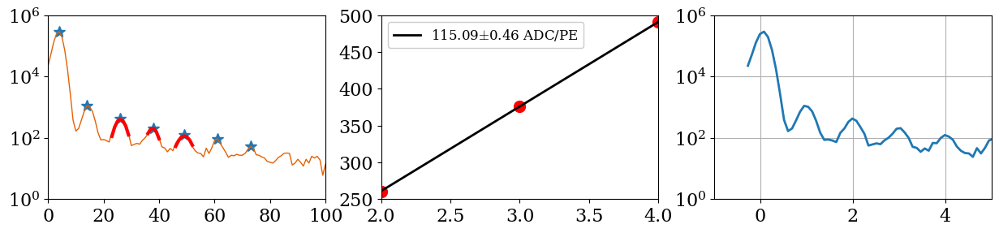

In [68]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step12_gain_list,Step12_gain_err,Step12_calib_pe,Step12_calib_count=gain_calculator(Step12,10,6,1,2,-2)
Voltages_Step12=Voltages(Step12)

C:/Data/20221007/Step13\mca_keith_31.40OV_0.h5


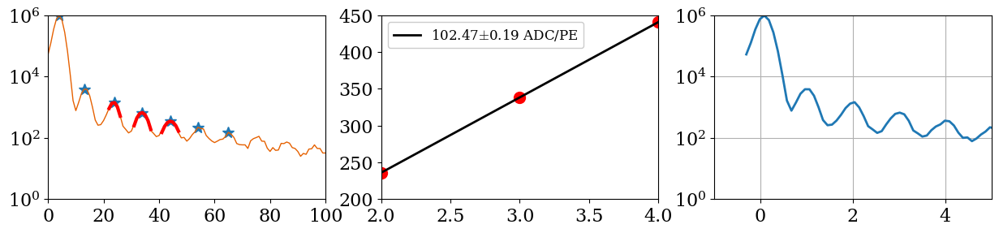

C:/Data/20221007/Step13\mca_keith_31.40OV_1.h5


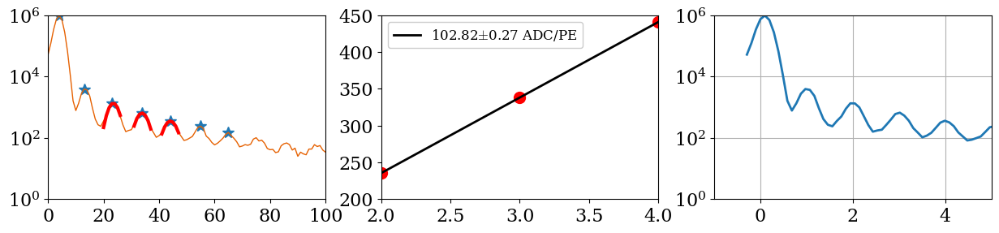

C:/Data/20221007/Step13\mca_keith_31.40OV_2.h5


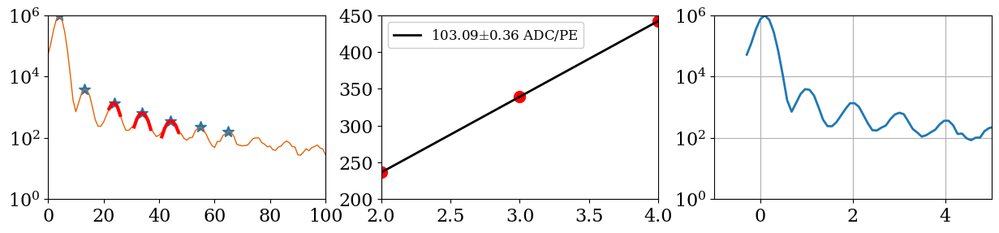

C:/Data/20221007/Step13\mca_keith_31.40OV_3.h5


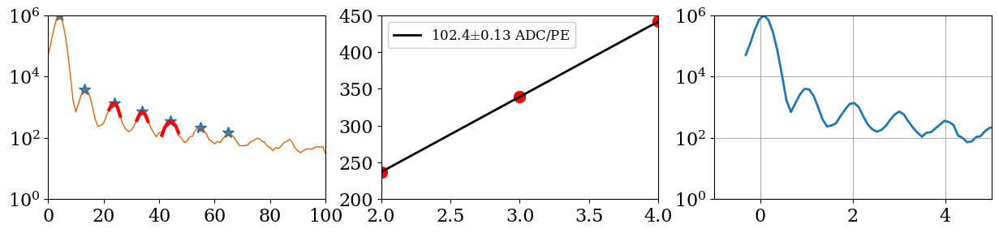

C:/Data/20221007/Step13\mca_keith_31.40OV_4.h5


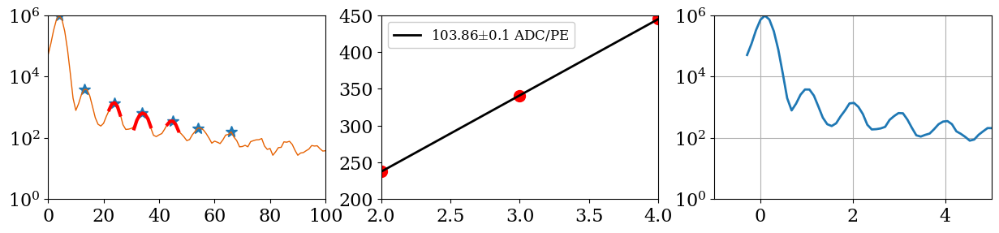

C:/Data/20221007/Step13\mca_keith_31.40OV_5.h5


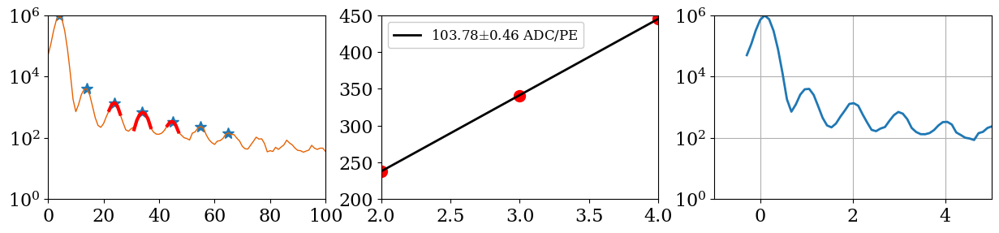

C:/Data/20221007/Step13\mca_keith_31.40OV_6.h5


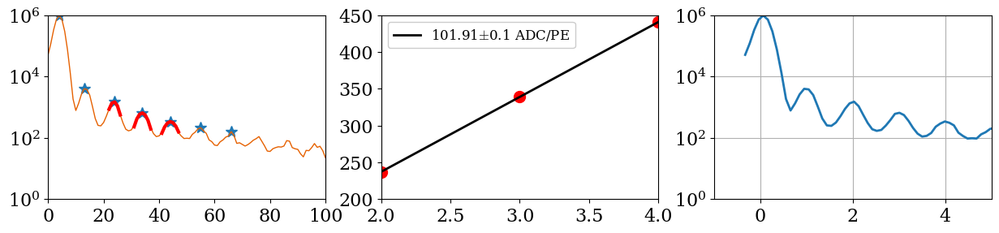

C:/Data/20221007/Step13\mca_keith_31.40OV_7.h5


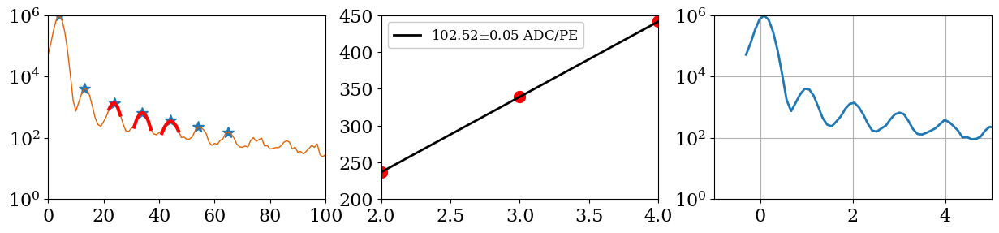

C:/Data/20221007/Step13\mca_keith_31.40OV_8.h5


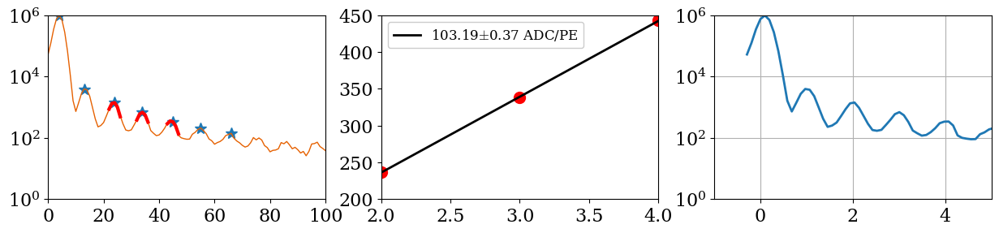

C:/Data/20221007/Step13\mca_keith_31.40OV_9.h5


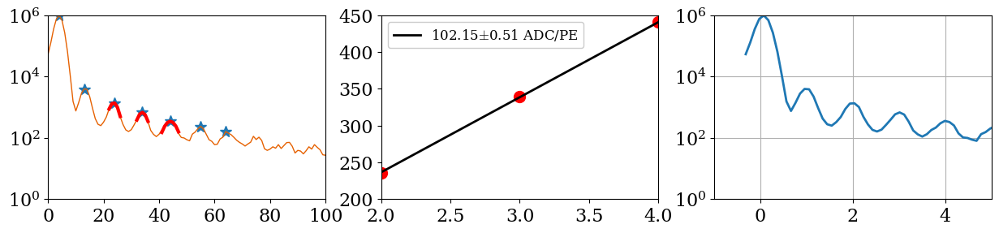

In [69]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step13_gain_list,Step13_gain_err,Step13_calib_pe,Step13_calib_count=gain_calculator(Step13,10,6,1,2,-2)
Voltages_Step13=Voltages(Step13)

C:/Data/20221007/Step14\mca_keith_31.40OV_0.h5


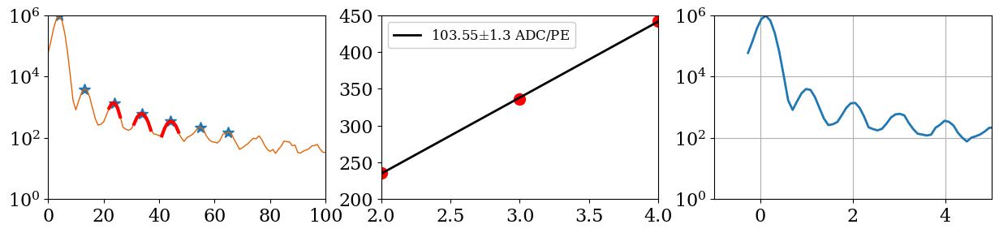

C:/Data/20221007/Step14\mca_keith_31.40OV_1.h5


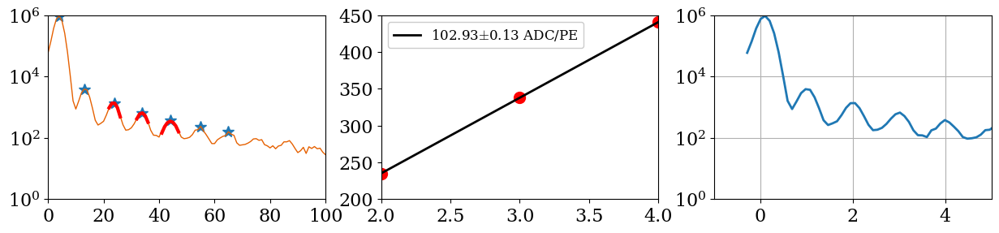

C:/Data/20221007/Step14\mca_keith_31.40OV_2.h5


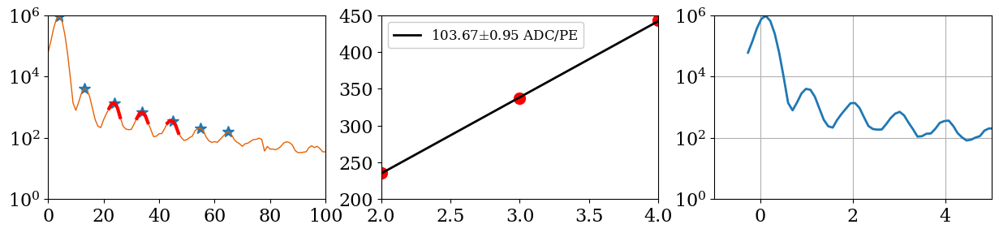

C:/Data/20221007/Step14\mca_keith_31.40OV_3.h5


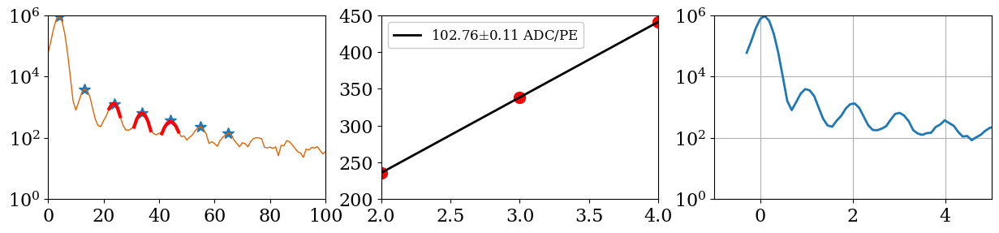

C:/Data/20221007/Step14\mca_keith_31.40OV_4.h5


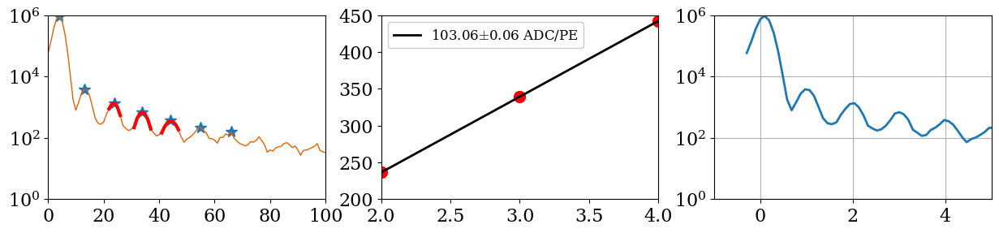

C:/Data/20221007/Step14\mca_keith_31.40OV_5.h5


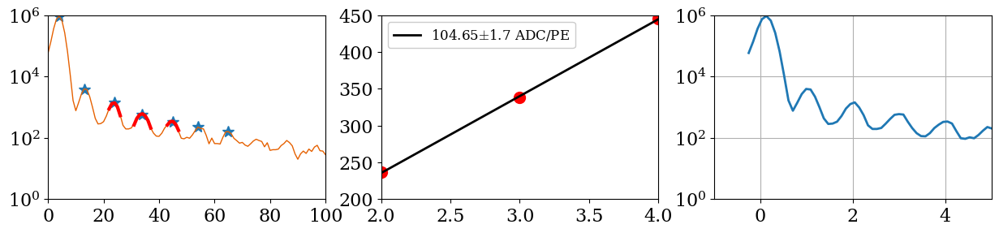

C:/Data/20221007/Step14\mca_keith_31.40OV_6.h5


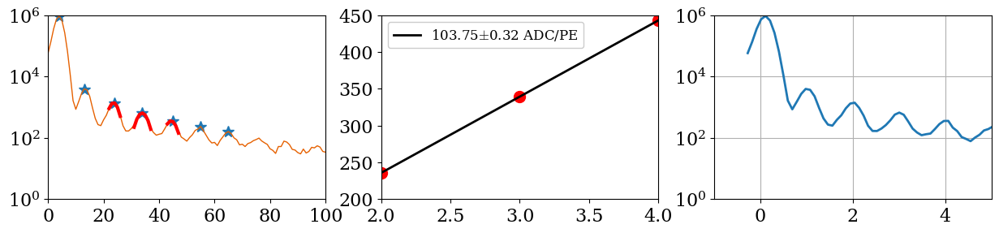

C:/Data/20221007/Step14\mca_keith_31.40OV_7.h5


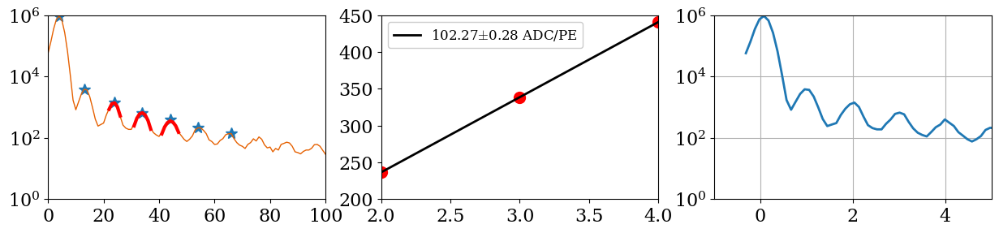

C:/Data/20221007/Step14\mca_keith_31.40OV_8.h5


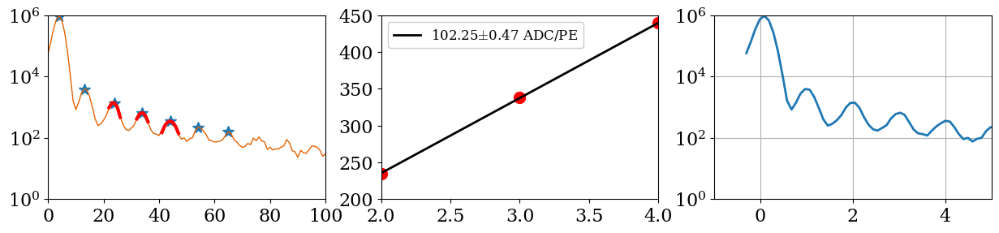

C:/Data/20221007/Step14\mca_keith_31.40OV_9.h5


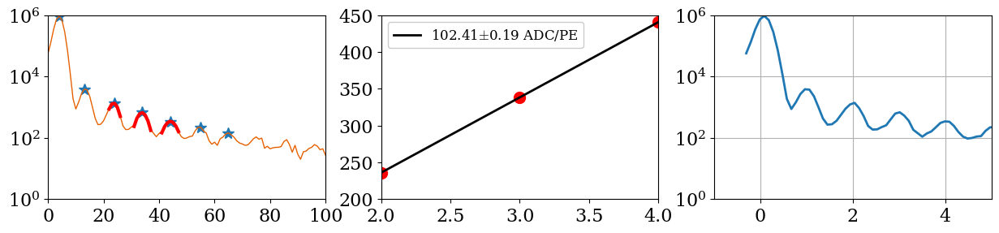

C:/Data/20221007/Step14\mca_keith_31.40OV_10.h5


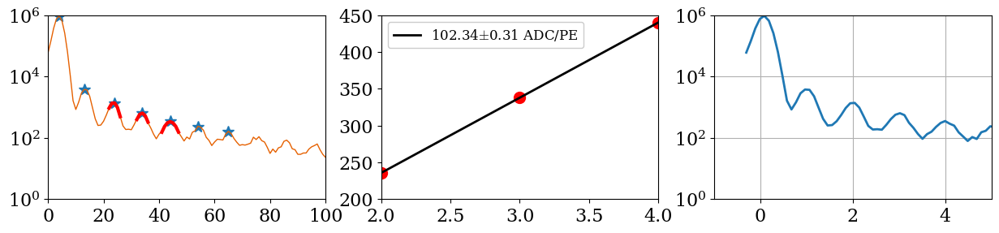

C:/Data/20221007/Step14\mca_keith_31.40OV_11.h5


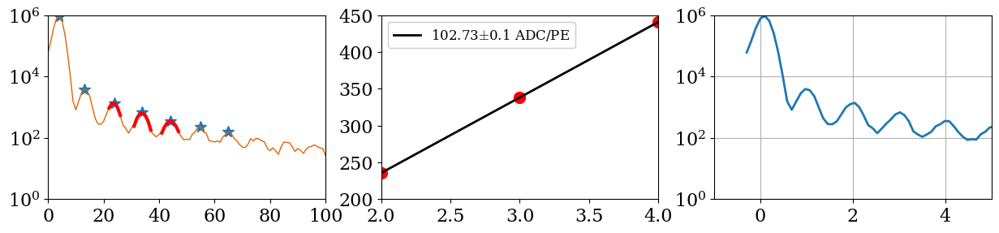

C:/Data/20221007/Step14\mca_keith_31.40OV_12.h5


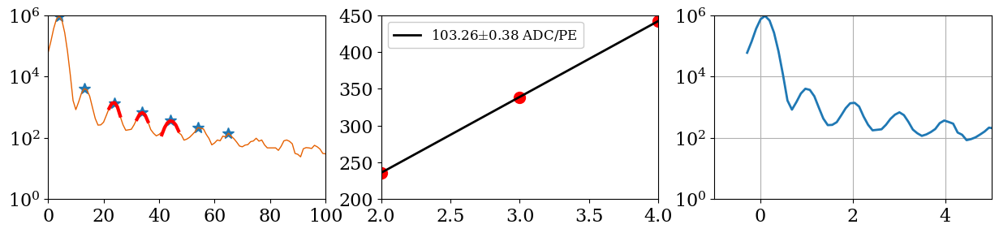

C:/Data/20221007/Step14\mca_keith_31.40OV_13.h5


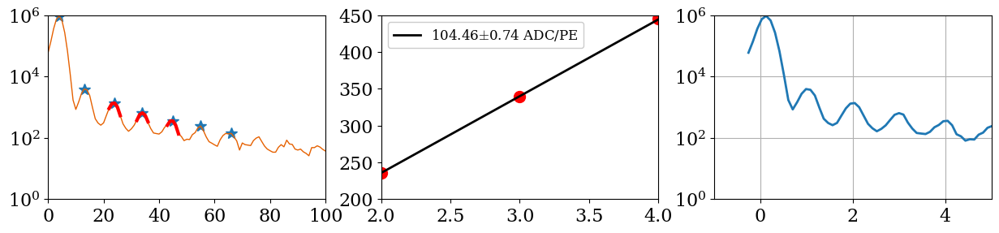

C:/Data/20221007/Step14\mca_keith_31.40OV_14.h5


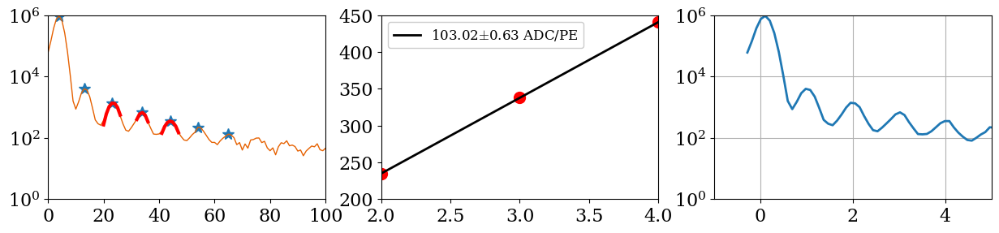

C:/Data/20221007/Step14\mca_keith_31.40OV_15.h5


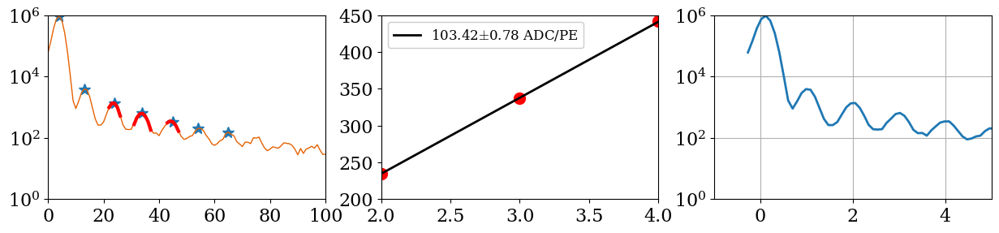

C:/Data/20221007/Step14\mca_keith_31.40OV_16.h5


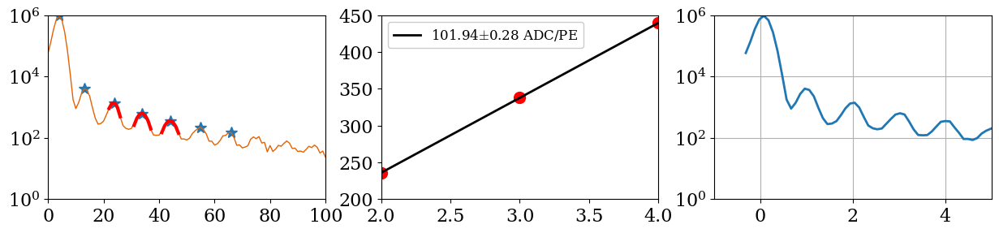

C:/Data/20221007/Step14\mca_keith_31.40OV_17.h5


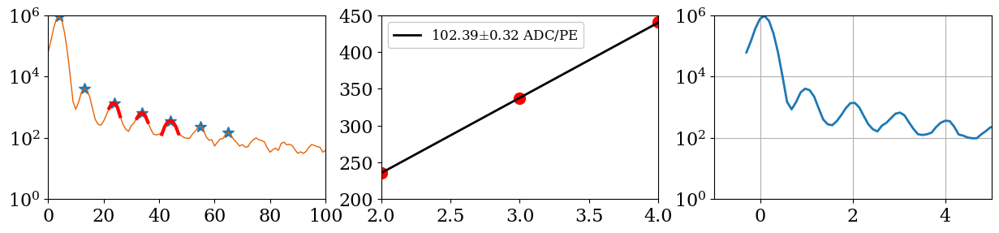

C:/Data/20221007/Step14\mca_keith_31.40OV_18.h5


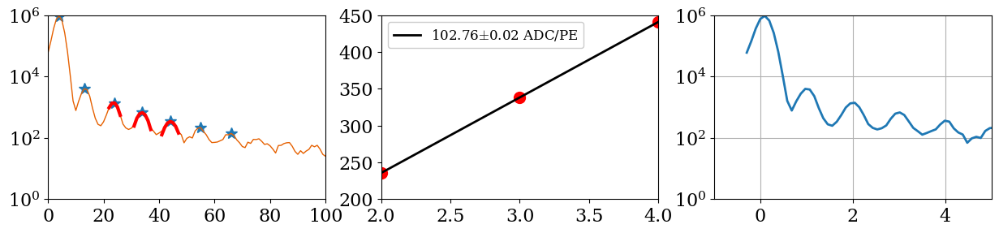

C:/Data/20221007/Step14\mca_keith_31.40OV_19.h5


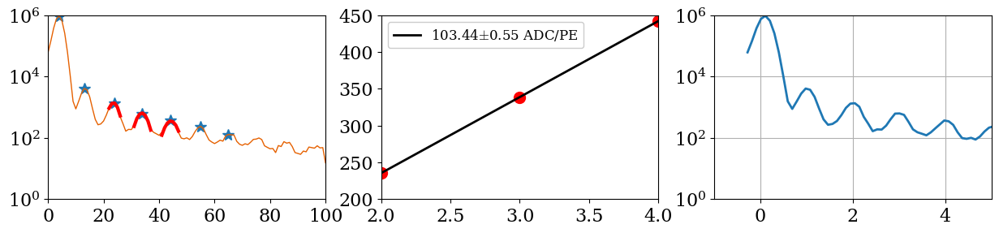

C:/Data/20221007/Step14\mca_keith_31.40OV_20.h5


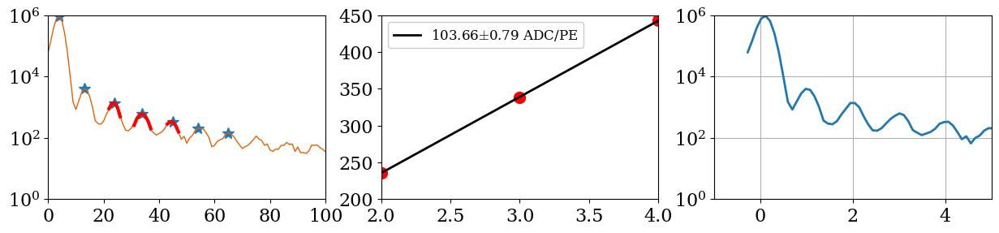

C:/Data/20221007/Step14\mca_keith_31.40OV_21.h5


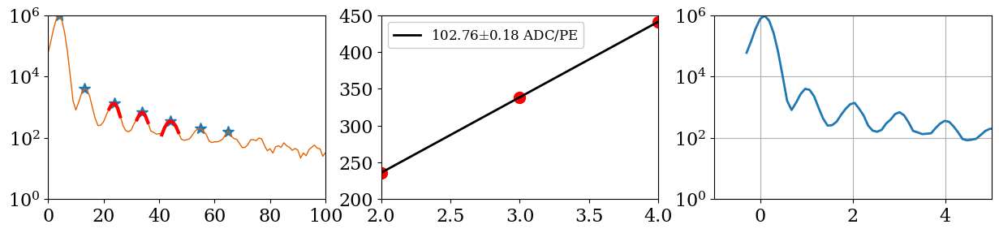

In [70]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step14_gain_list,Step14_gain_err,Step14_calib_pe,Step14_calib_count=gain_calculator(Step14,10,6,1,2,-2)
Voltages_Step14=Voltages(Step14)

C:/Data/20221007/Step15\mca_keith_31.40OV_0.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


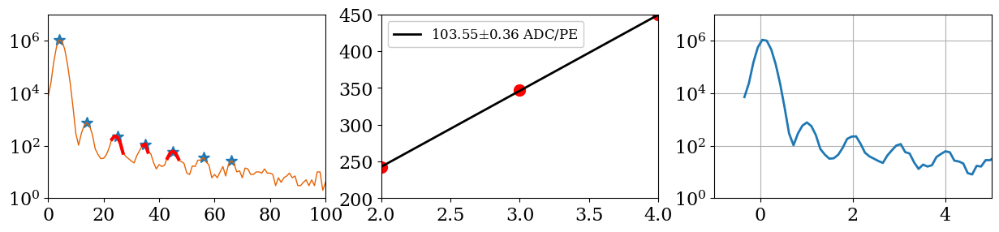

C:/Data/20221007/Step15\mca_keith_31.40OV_1.h5


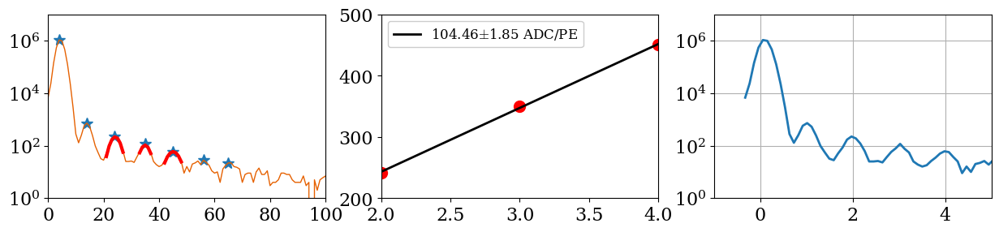

C:/Data/20221007/Step15\mca_keith_31.40OV_2.h5


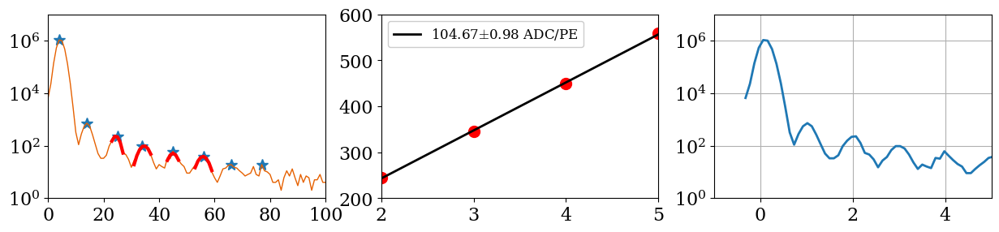

C:/Data/20221007/Step15\mca_keith_31.40OV_3.h5


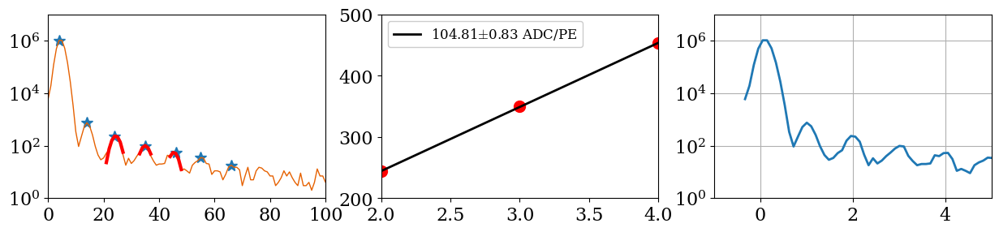

C:/Data/20221007/Step15\mca_keith_31.40OV_4.h5


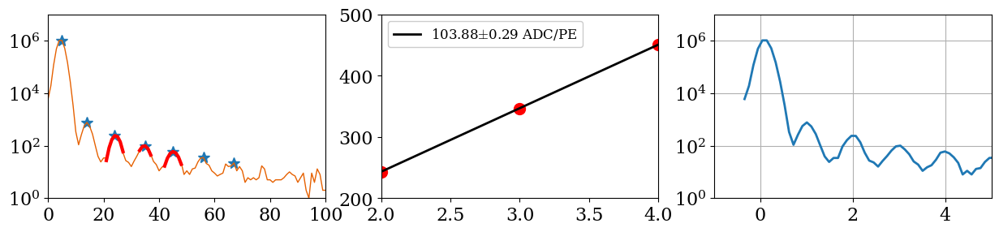

C:/Data/20221007/Step15\mca_keith_31.40OV_5.h5


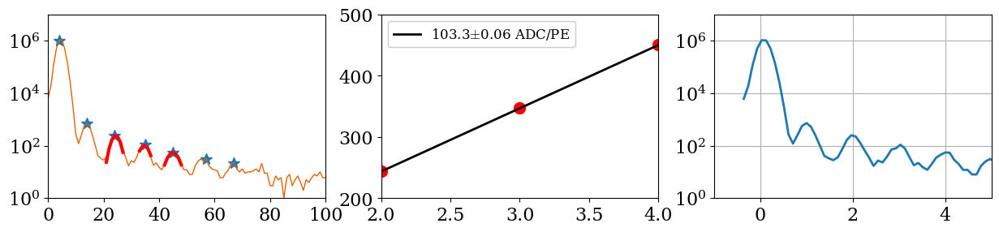

C:/Data/20221007/Step15\mca_keith_31.40OV_6.h5


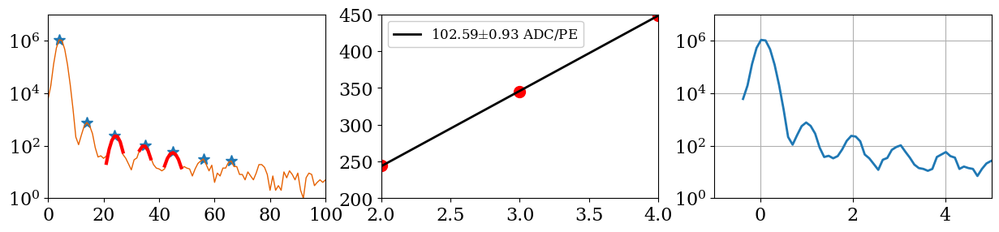

C:/Data/20221007/Step15\mca_keith_31.40OV_7.h5


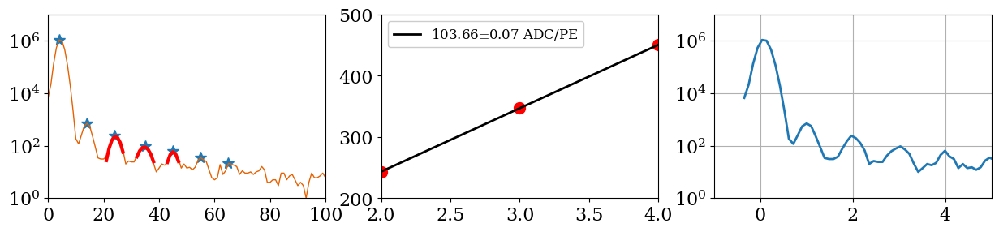

C:/Data/20221007/Step15\mca_keith_31.40OV_8.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


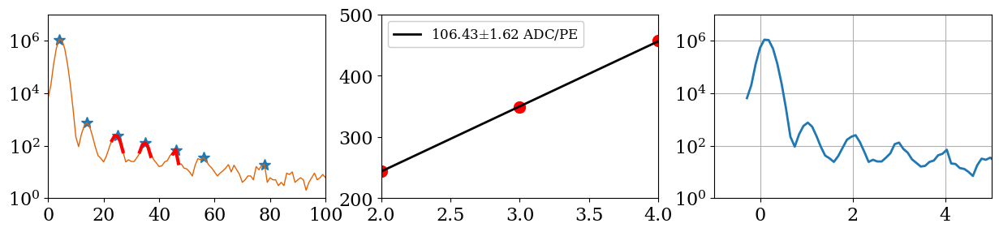

C:/Data/20221007/Step15\mca_keith_31.40OV_9.h5


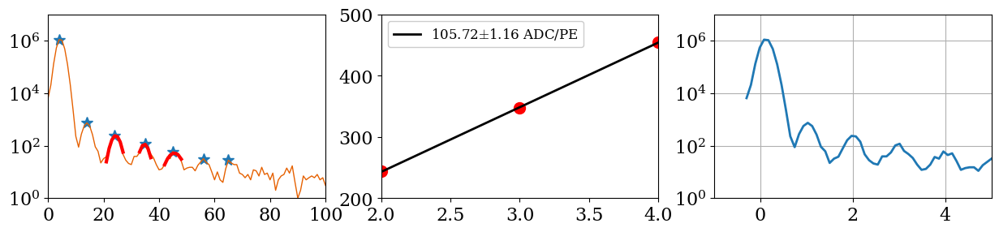

C:/Data/20221007/Step15\mca_keith_31.40OV_10.h5


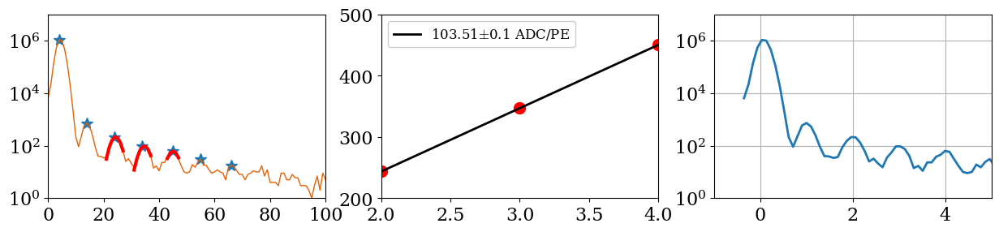

C:/Data/20221007/Step15\mca_keith_31.40OV_11.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


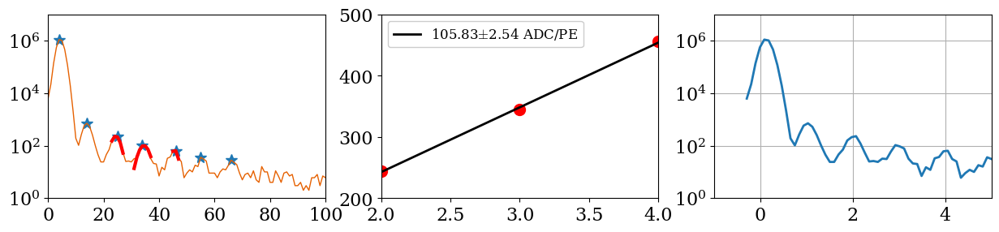

C:/Data/20221007/Step15\mca_keith_31.40OV_12.h5


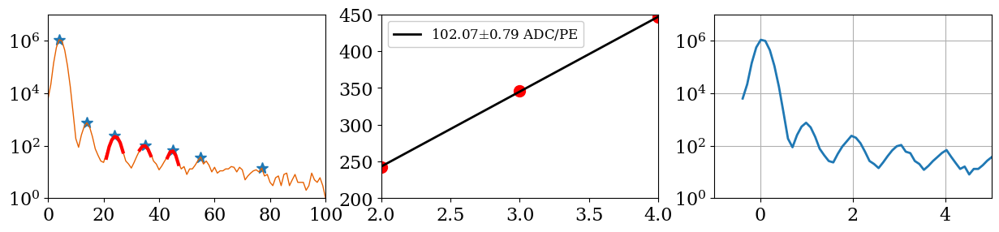

C:/Data/20221007/Step15\mca_keith_31.40OV_13.h5


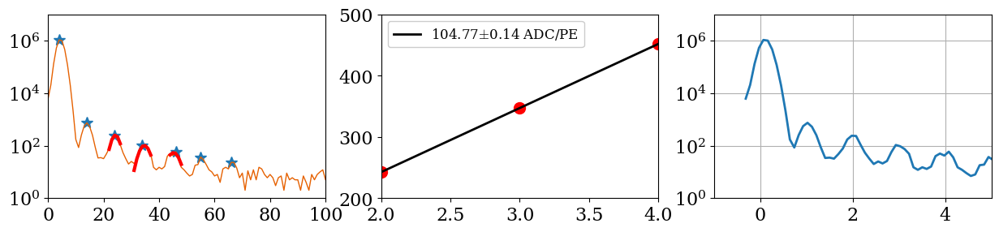

C:/Data/20221007/Step15\mca_keith_31.40OV_14.h5


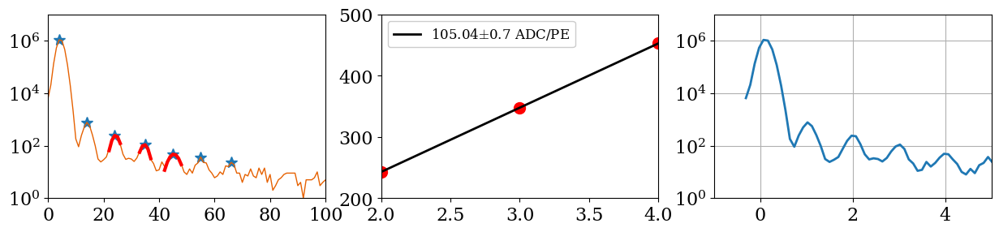

C:/Data/20221007/Step15\mca_keith_31.40OV_15.h5


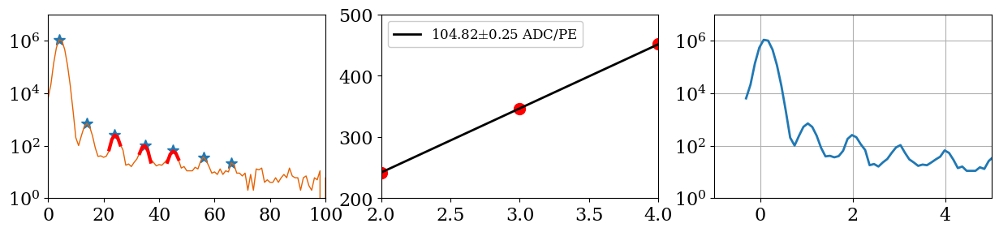

C:/Data/20221007/Step15\mca_keith_31.40OV_16.h5


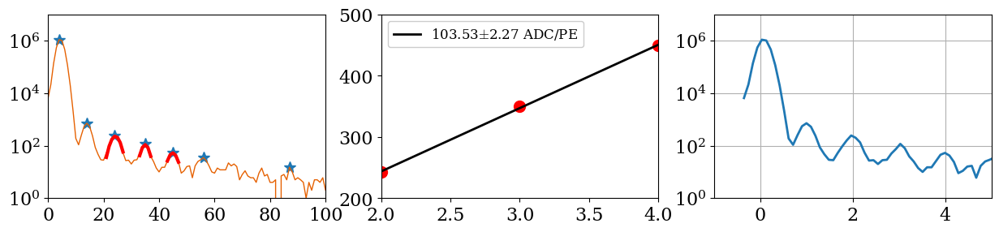

C:/Data/20221007/Step15\mca_keith_31.40OV_17.h5


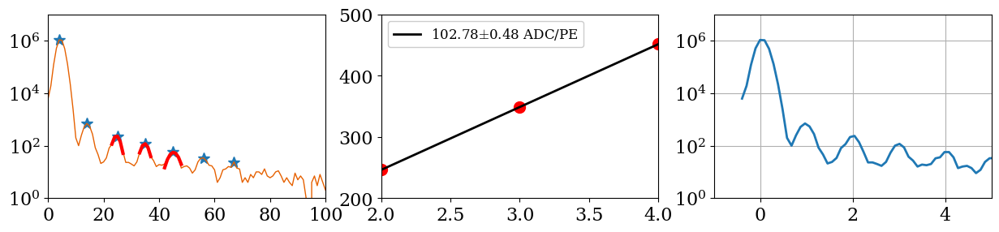

C:/Data/20221007/Step15\mca_keith_31.40OV_18.h5


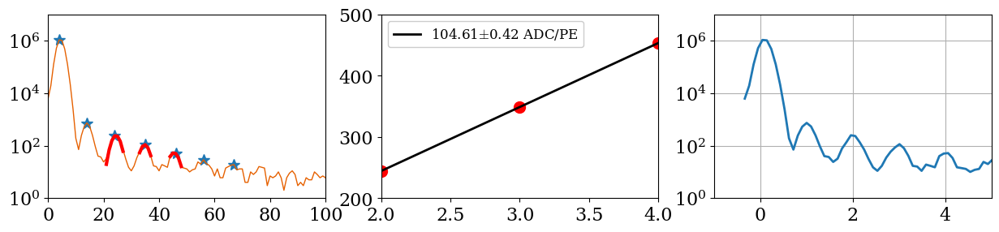

C:/Data/20221007/Step15\mca_keith_31.40OV_19.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


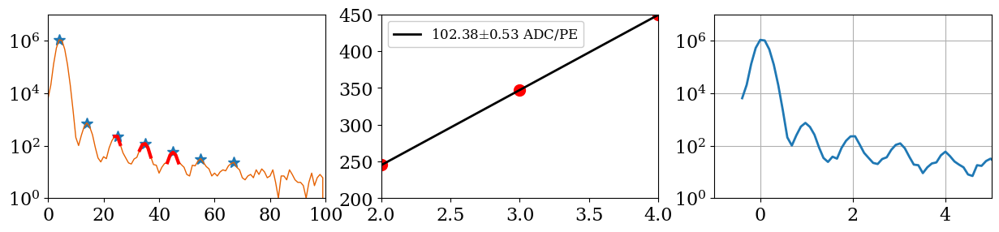

C:/Data/20221007/Step15\mca_keith_31.40OV_20.h5


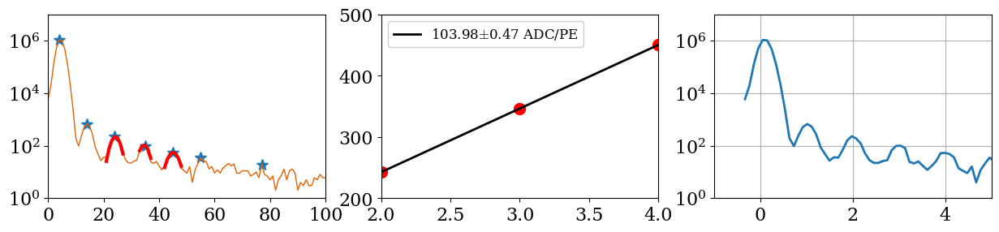

C:/Data/20221007/Step15\mca_keith_31.40OV_21.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


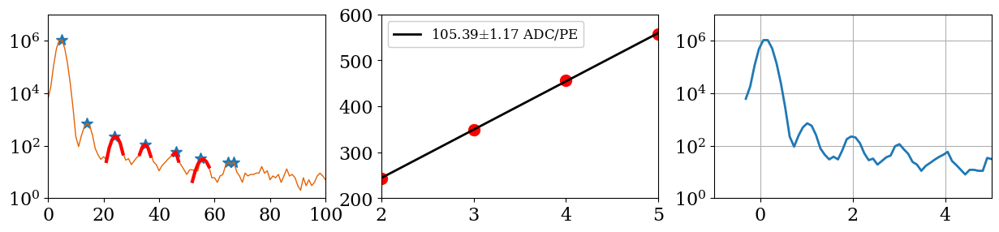

C:/Data/20221007/Step15\mca_keith_31.40OV_22.h5


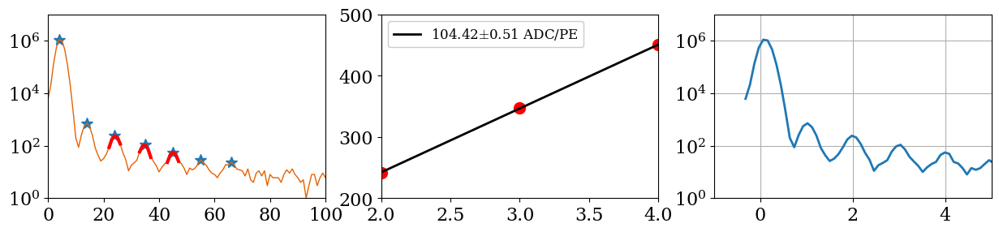

C:/Data/20221007/Step15\mca_keith_31.40OV_23.h5


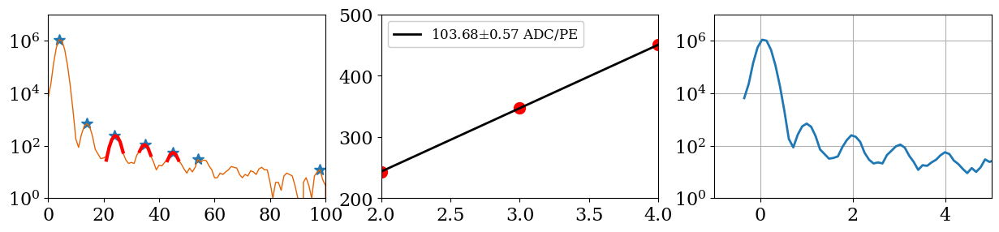

C:/Data/20221007/Step15\mca_keith_31.40OV_24.h5


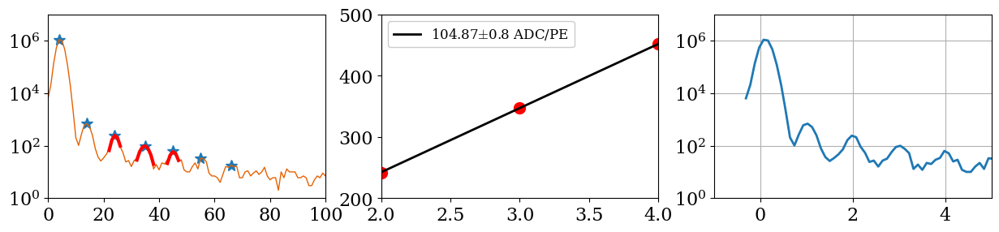

C:/Data/20221007/Step15\mca_keith_31.40OV_25.h5


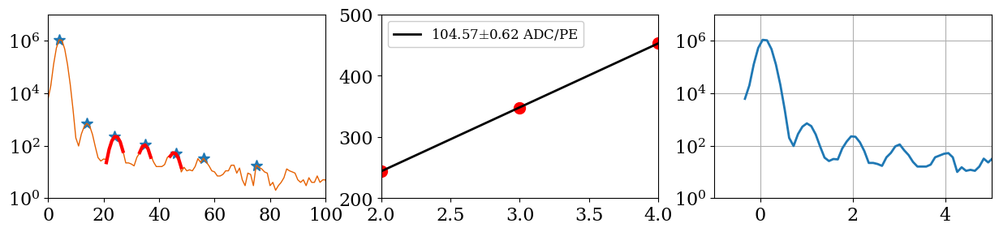

C:/Data/20221007/Step15\mca_keith_31.40OV_26.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


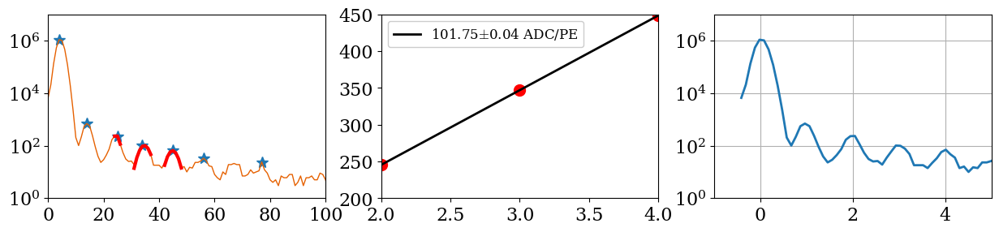

C:/Data/20221007/Step15\mca_keith_31.40OV_27.h5


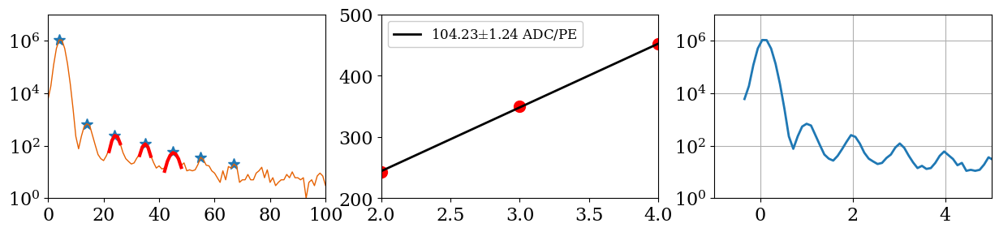

C:/Data/20221007/Step15\mca_keith_31.40OV_28.h5


c:\Users\nEXO\anaconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


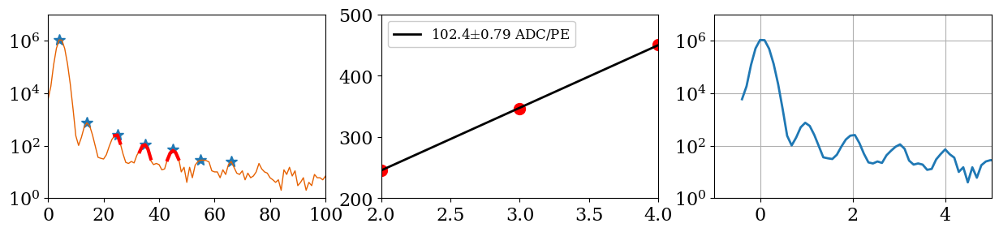

C:/Data/20221007/Step15\mca_keith_31.40OV_29.h5


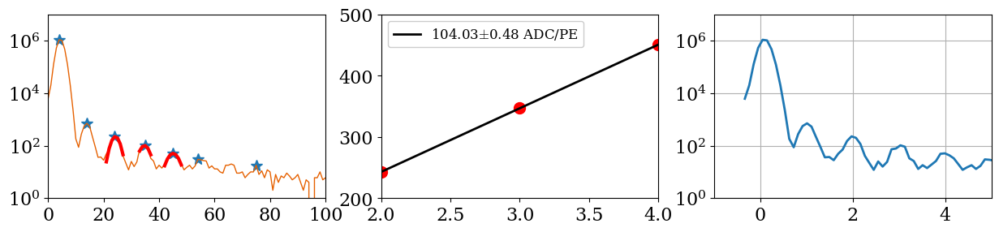

In [71]:
# gain_calculator(PATH,N_BINS,N_PEAKS,PEAK_DISTANCE,PSL,PSR):
Step15_gain_list,Step15_gain_err,Step15_calib_pe,Step15_calib_count=gain_calculator(Step15,10,6,1,2,-2)
Voltages_Step15=Voltages(Step15)

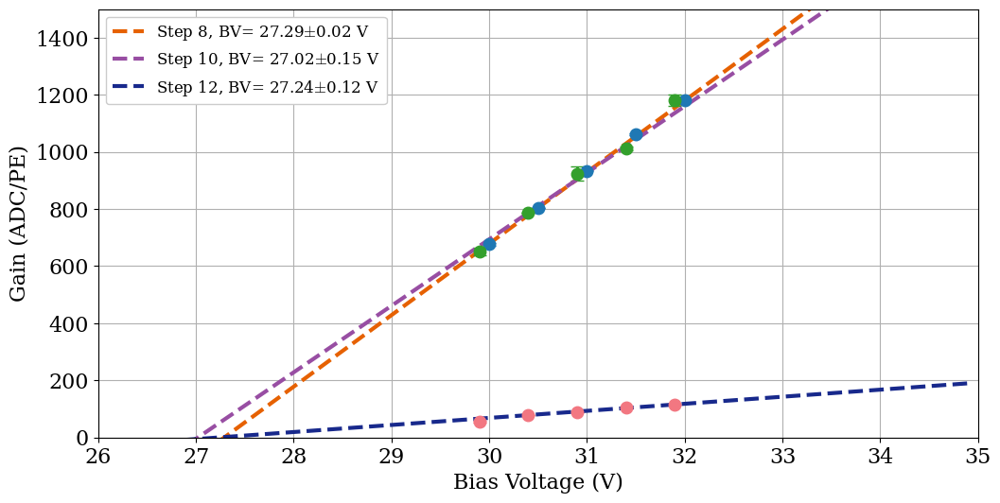

In [72]:
x_data=np.arange(26,35,0.1)
plt.figure(figsize=(12,6))

All_Voltages = [Voltages_Step0,Voltages_Step1,Voltages_Step2,Voltages_Step3,Voltages_Step4,Voltages_Step5,Voltages_Step6,Voltages_Step7,Voltages_Step8,Voltages_Step9,Voltages_Step10,Voltages_Step11,Voltages_Step12,Voltages_Step13,Voltages_Step14,Voltages_Step15]
All_Gains = [Step0_gain_list,Step1_gain_list,Step2_gain_list,Step3_gain_list,Step4_gain_list,Step5_gain_list,Step6_gain_list,Step7_gain_list*5,Step8_gain_list*5,Step9_gain_list,Step10_gain_list*10,Step11_gain_list,Step12_gain_list,Step13_gain_list,Step14_gain_list,Step15_gain_list]
All_Errors = [Step0_gain_err,Step1_gain_err,Step2_gain_err,Step3_gain_err,Step4_gain_err,Step5_gain_err,Step6_gain_err,Step7_gain_err*5,Step8_gain_err*5,Step9_gain_err,Step10_gain_err*10,Step11_gain_err,Step12_gain_err,Step13_gain_err,Step14_gain_err,Step15_gain_err]



# Steps=np.arange(0,16,1)
Steps=[8,10,12]
# Steps=[9]
for i,steps in enumerate(Steps):
    plt.errorbar(All_Voltages[steps], All_Gains[steps], yerr=All_Errors[steps], fmt='o', ms=9)
    popt,pcov=curve_fit(line,All_Voltages[steps],All_Gains[steps],p0=[31,26],sigma=All_Errors[steps])
    label = 'Step '+str(steps)+', '+'BV= '+str(np.round(popt[1],2))+ '$\pm$'+ str(np.round(np.sqrt(np.diag(pcov)[1]),2))+' V'
    plt.plot(x_data, line(x_data,*popt), ls='--',lw=3,label=label)
plt.grid()
plt.ylabel('Gain (ADC/PE)')
plt.xlabel('Bias Voltage (V)')
plt.legend(loc='best')
plt.ylim(0,1500)
plt.xlim(26,35)
plt.savefig('Gain_20221006_Steps.pdf')
plt.show()